In [1]:
import uproot, glob
import awkward as ak
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import mplhep as hep
import os, glob, pickle
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors
import mplhep as hep
plt.style.use([hep.style.ROOT, hep.style.firamath])
from matplotlib.colors import LinearSegmentedColormap
import scipy
from scipy.stats import norm
# Define the CMS color scheme
cms_colors = [
    (0.00, '#FFFFFF'),  # White
    (0.33, '#005EB8'),  # Blue
    (0.66, '#FFDD00'),  # Yellow
    (1.00, '#FF0000')   # red
]

# Create the CMS colormap
cms_cmap = LinearSegmentedColormap.from_list('CMS', cms_colors)

Matplotlib created a temporary config/cache directory at /tmp/matplotlib-fq9i55nz because the default path (/uscms/home/bbbam/.cache/matplotlib) is not a writable directory; it is highly recommended to set the MPLCONFIGDIR environment variable to a writable directory, in particular to speed up the import of Matplotlib and to better support multiprocessing.


In [5]:
# out_dir='data/plot_H_AA_4Tau_M_10_signal_kinematics'
out_dir='../analysis_run3/AN_Note_Plot/mass_regression_with_map'
if not os.path.isdir(out_dir):
    os.makedirs(out_dir)
save = True

In [7]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'

ua_dir_map = 'ResNet_min_max_scaling_mN1p2To22_unbiased_map'
ua_dir_map_no_relu = 'ResNet_min_max_scaling_mN1p2To22_unbiased_map_no_relu'
model_dir_map = '13_ResNet_map_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

ua_dir = 'ResNet_min_max_scaling_mN1p2To22_unbiased'
ua_dir_no_relu = 'ResNet_min_max_scaling_mN1p2To22_unbiased_no_relu'
model_dir = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'






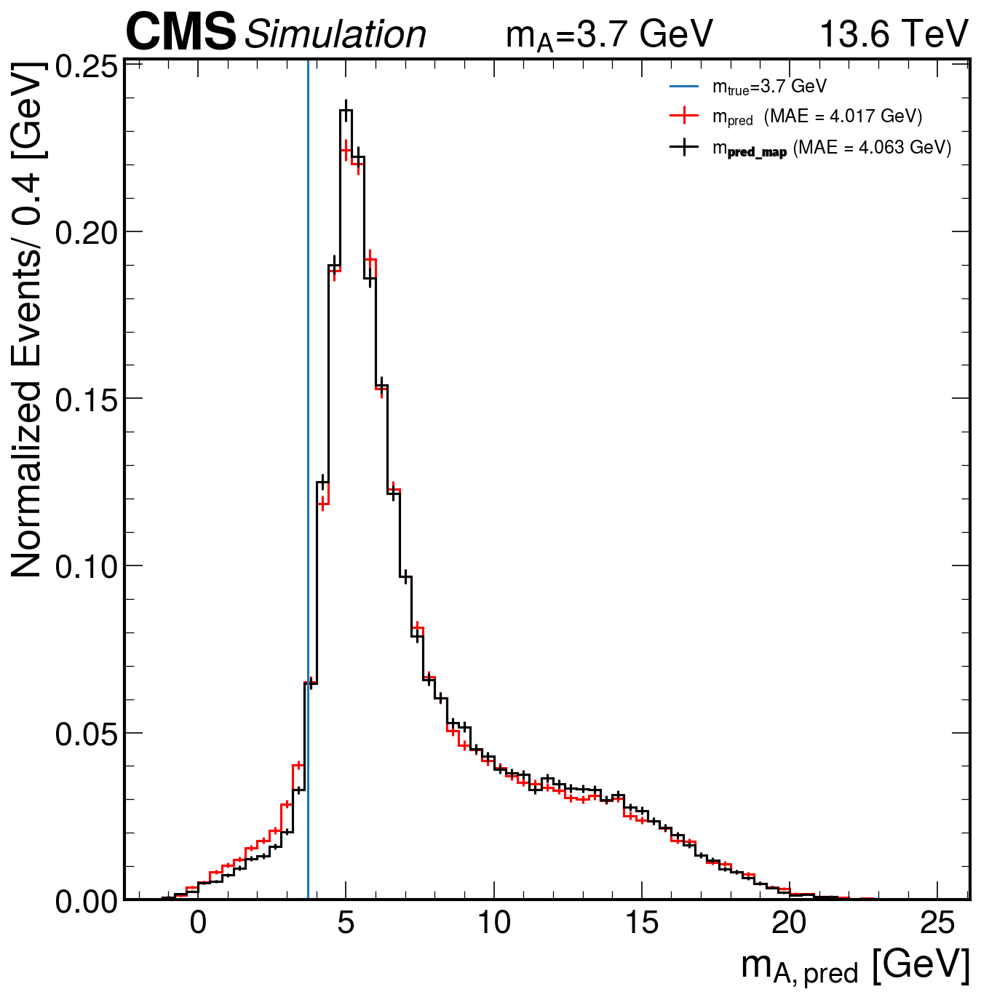

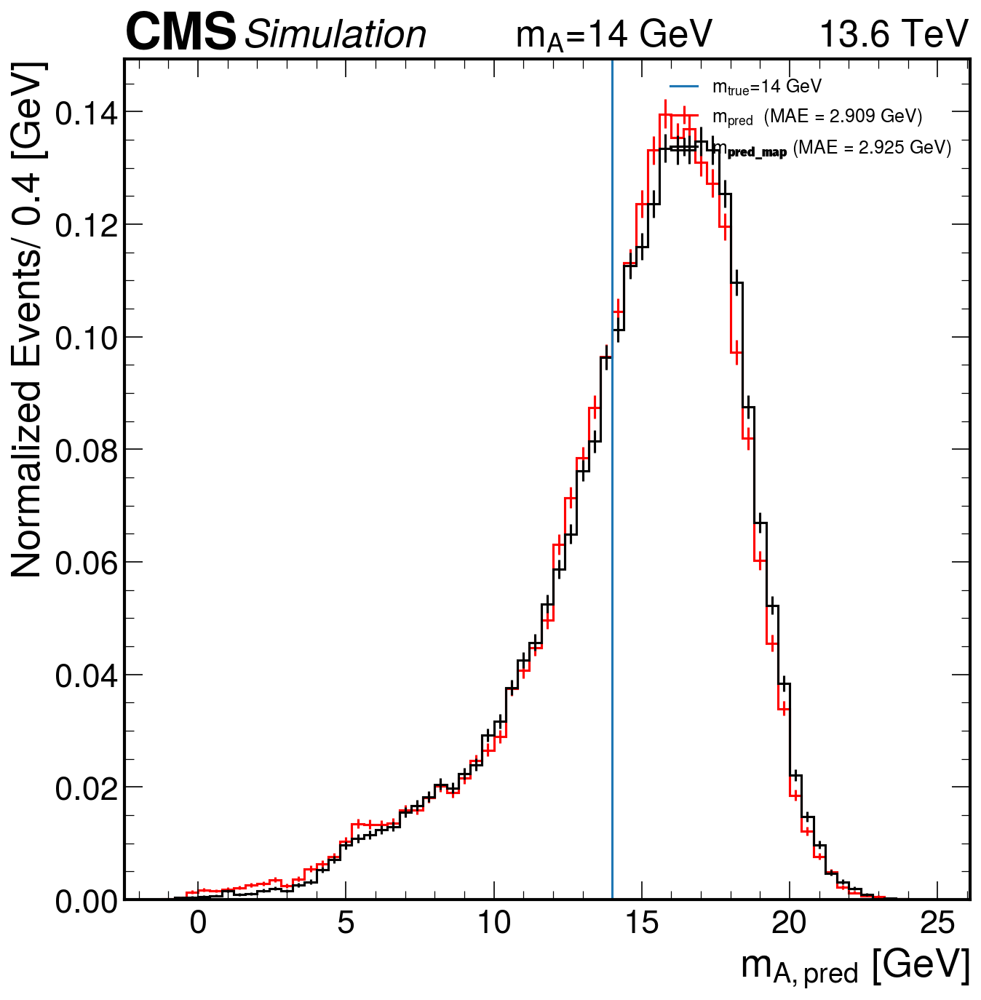

In [5]:
epoch=100
for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    data_file = glob.glob(f"{data_dir}/{ua_dir}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile = open(f"{data_file}", "rb")
    data = pickle.load(infile)
    infile.close()
    m_pred = data["m_pred"]
    m_true = data["m_true"]

    data_file_map = glob.glob(f"{data_dir}/{ua_dir_map}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    data_map.keys()
    infile_map.close()
    m_pred_map = data_map["m_pred"]
    m_true_map = data_map["m_true"]


    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots(dpi=150)
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    h1=np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h1, histtype='step', yerr=True, label=r'$m_{pred}$  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred)), color='red', density=True)
    h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{\mathrm{pred\_map}}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color='black', density=True)
    plt.xlabel(r'$m_{A, pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='upper right', fontsize=12)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_comparion_with_map_model_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

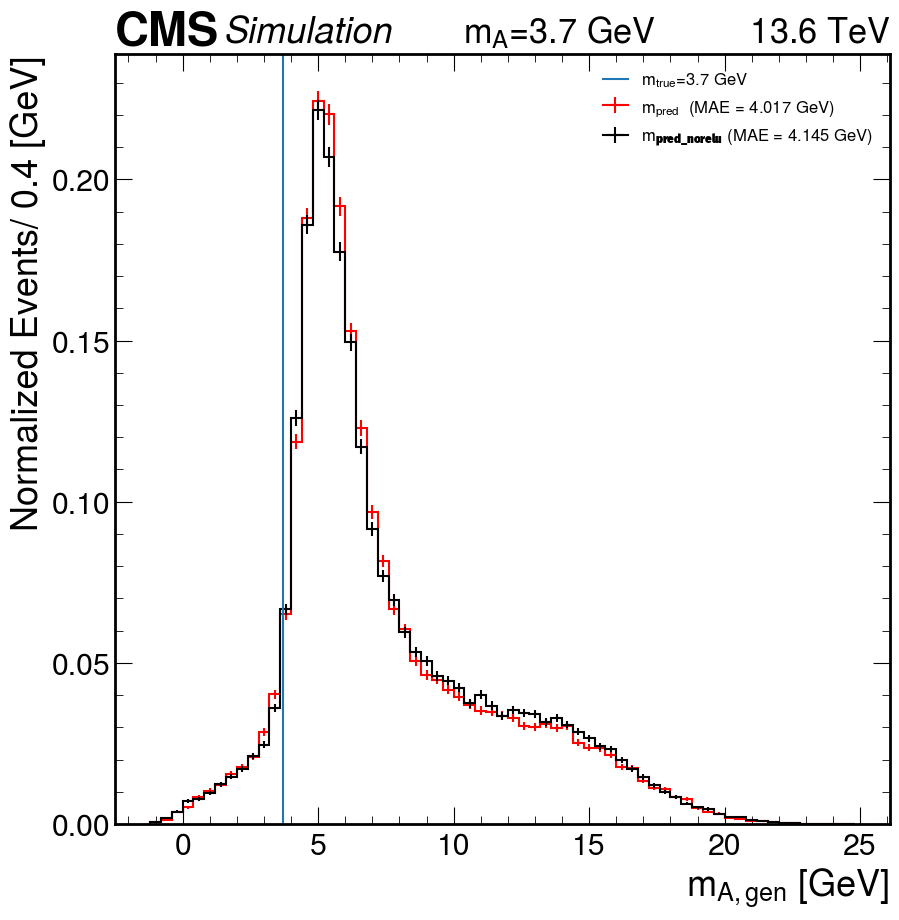

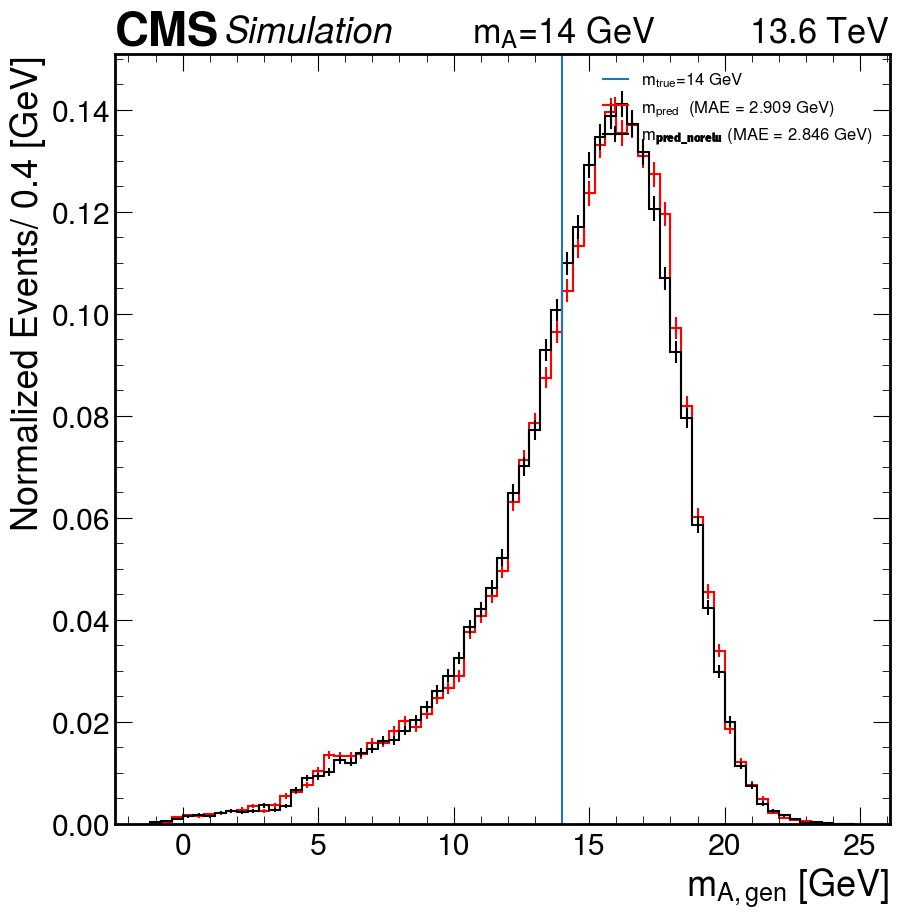

In [6]:
for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    data_file = glob.glob(f"{data_dir}/{ua_dir}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile = open(f"{data_file}", "rb")
    data = pickle.load(infile)
    infile.close()
    m_pred = data["m_pred"]
    m_true = data["m_true"]

    data_file_map = glob.glob(f"{data_dir}/{ua_dir_no_relu}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    data_map.keys()
    infile_map.close()
    m_pred_map = data_map["m_pred"]
    m_true_map = data_map["m_true"]


    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots(dpi=100)
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    h1=np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h1, histtype='step', yerr=True, label=r'$m_{pred}$  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred)), color='red', density=True)
    h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{\mathrm{pred\_norelu}}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color='black', density=True)
    plt.xlabel(r'$m_{A, gen}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='upper right', fontsize=12)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_comparion_with_map_model_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

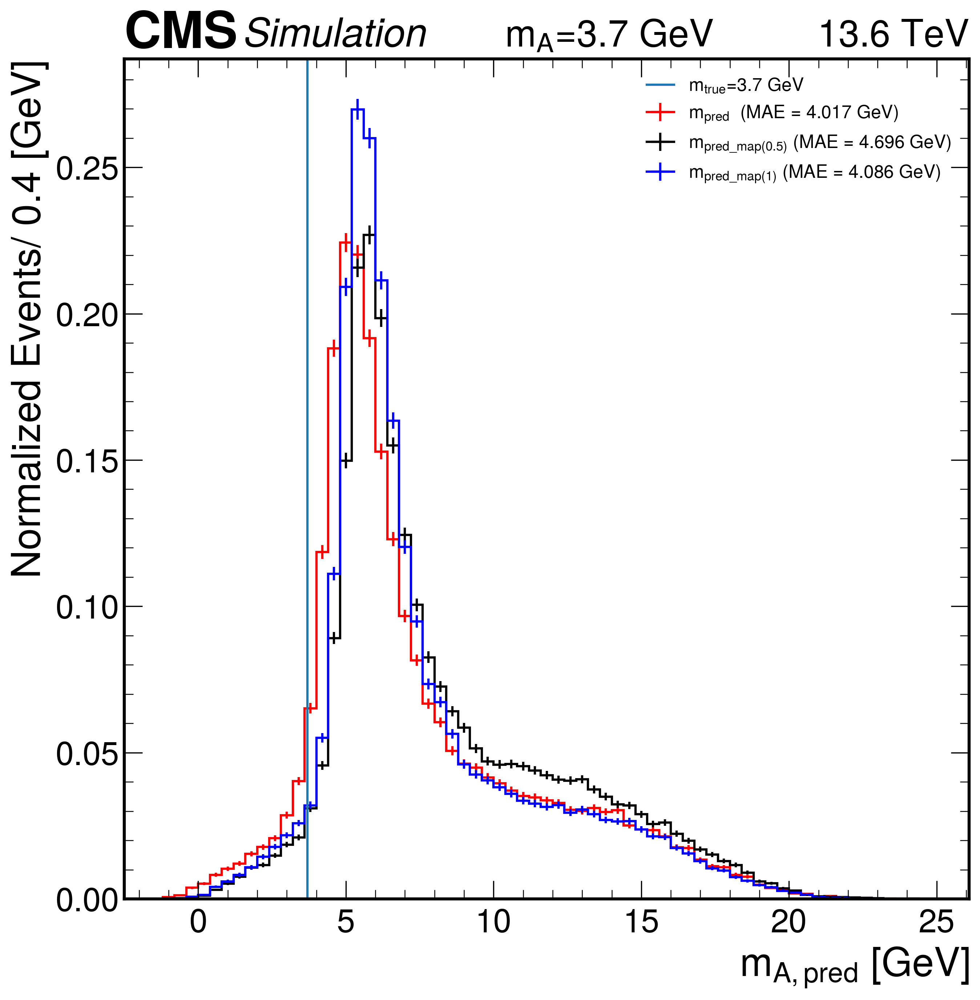

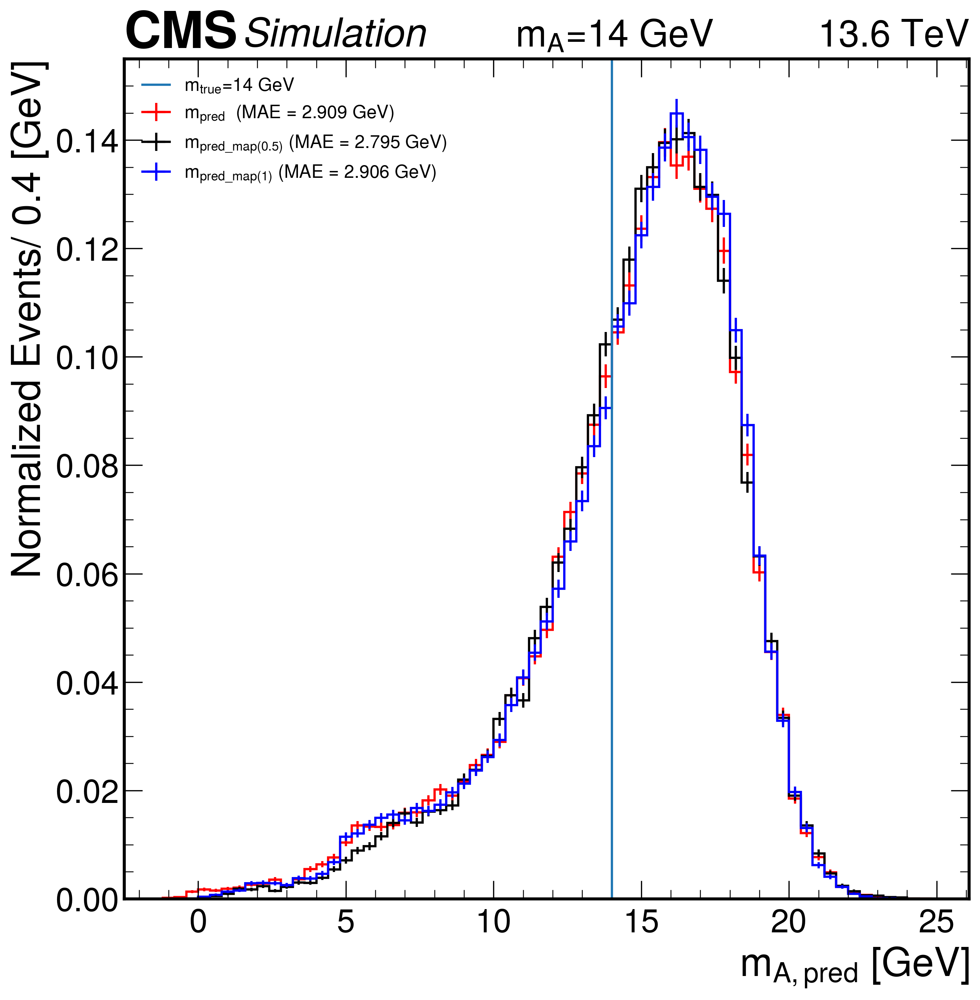

In [16]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'

ua_dir = 'ResNet_min_max_scaling_mN1p2To22_unbiased'
ua_dir_no_relu = 'ResNet_min_max_scaling_mN1p2To22_unbiased_no_relu'
model_dir = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

ua_dir_mapA1 = 'ResNet_mapA_1_mN1p2To22_unbaised'
ua_dir_mapA0p5 = 'ResNet_mapA_0p5_mN1p2To22_unbaised'
model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'


for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    data_file = glob.glob(f"{data_dir}/{ua_dir}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile = open(f"{data_file}", "rb")
    data = pickle.load(infile)
    infile.close()
    m_pred = data["m_pred"]
    m_true = data["m_true"]
    
    data_file_map0p5 = glob.glob(f"{data_dir}/{ua_dir_mapA0p5}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map0p5 = open(f"{data_file_map0p5}", "rb")
    data_map0p5 = pickle.load(infile_map0p5)
    data_map0p5.keys()
    infile_map0p5.close()
    m_pred_map0p5 = data_map0p5["m_pred"]
    m_true_map0p5 = data_map0p5["m_true"]

    data_file_map1 = glob.glob(f"{data_dir}/{ua_dir_mapA1}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map1 = open(f"{data_file_map1}", "rb")
    data_map1 = pickle.load(infile_map1)
    data_map1.keys()
    infile_map1.close()
    m_pred_map1 = data_map1["m_pred"]
    m_true_map1 = data_map1["m_true"]


    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots(dpi=300)
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    h1=np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h1, histtype='step', yerr=True, label=r'$m_{pred}$  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred)), color='red', density=True)
    h2=np.histogram(m_pred_map0p5, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{pred\_map(0.5)}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map0p5 - m_pred_map0p5)), linestyle='-', color='black', density=True)
    h3=np.histogram(m_pred_map1, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h3, histtype='step', yerr=True, label=r'$m_{pred\_map(1)}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map1 - m_pred_map1)), linestyle='-', color='blue', density=True)
    plt.xlabel(r'$m_{A, pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='best', fontsize=12)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_comparion_with_map_alpha_1_0p5_0_model_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()





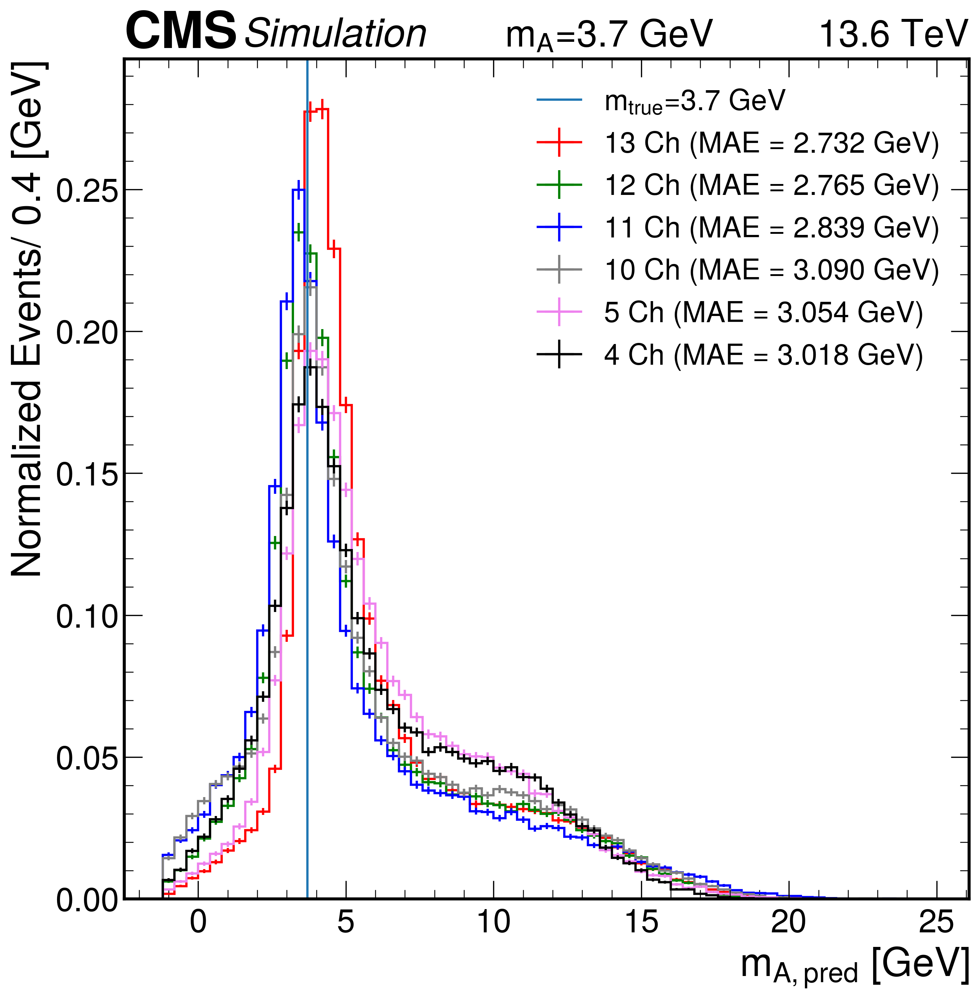

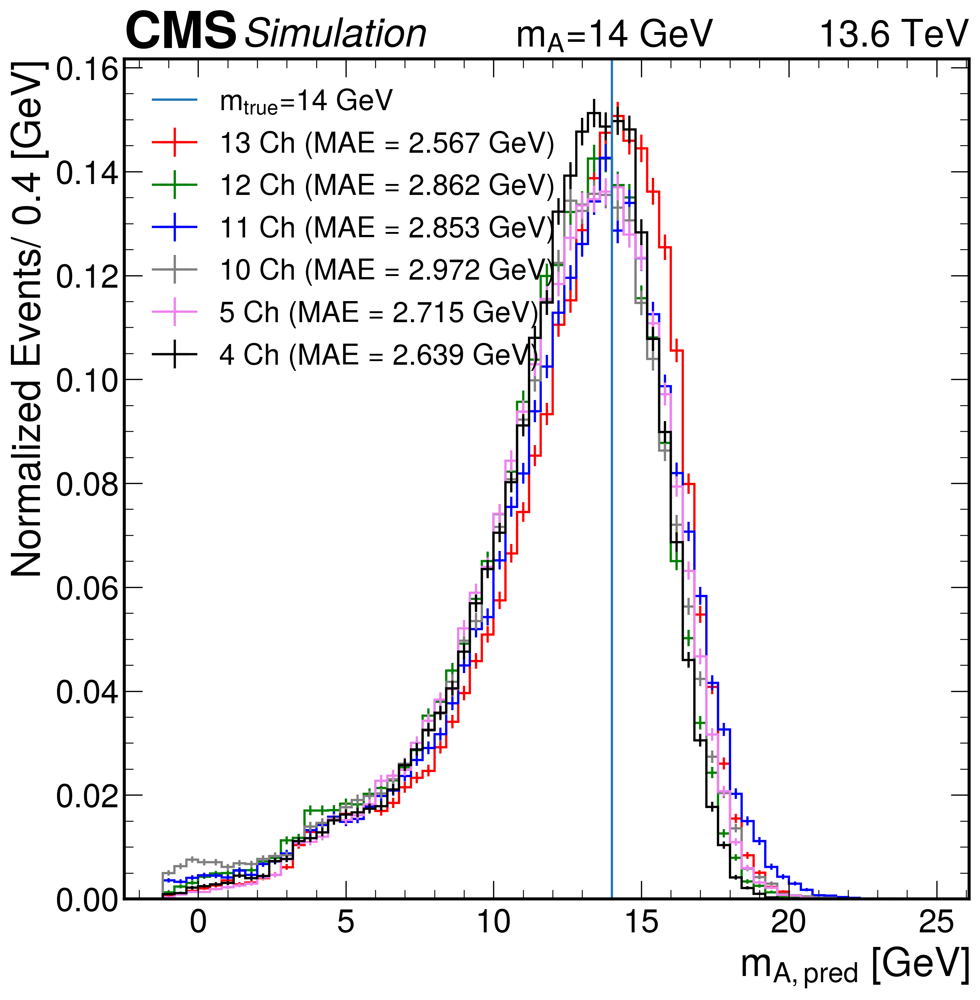

In [74]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
epoch=100

ua_dir_mapA = 'ResNet_mapA_mN1p2To22_unbaised'


model_dirs = ['13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'12_ResNet_mapA_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'11_ResNet_mapA_Tracks_pt_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'10_ResNet_mapA_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'5_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy'
              ,'4_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy'
               ]

channels = [[0,1,2,3,4,5,6,7,8,9,10,11,12]
            ,[1,2,3,4,5,6,7,8,9,10,11,12]
            ,[0,3,4,5,6,7,8,9,10,11,12]
            ,[3,4,5,6,7,8,9,10,11,12]
            ,[0,1,2,3,4]
            ,[0,1,2,3]
           ]
m0_min=-1.2
m0_max=25.1
bin_size =0.4

def correction(mass_raw,a=-0.04922334  ,b=-1.25575772):
            # mass = m + polynomial_mode(m)
            mass = mass_raw + a*mass_raw + b
            return mass

colors =['r', 'green', 'blue', 'grey', 'violet','black']      
for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)
    fig, ax = plt.subplots(dpi=300)
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    for ch, model_dir in enumerate(model_dirs):
        data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
        infile_map = open(f"{data_file_map}", "rb")
        data_map = pickle.load(infile_map)
        data_map.keys()
        infile_map.close()
        m_pred_map = correction(data_map["m_pred"])
        m_true_map = data_map["m_true"]
        h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
        hep.histplot(h2, histtype='step', yerr=True, label=f'{len(channels[ch])} Ch' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color=colors[ch], density=True)
    plt.xlabel(r'$m_{A, pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='best', fontsize=19)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/mass_reg_channel_test_signal_mass_{Mass}_prediction.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

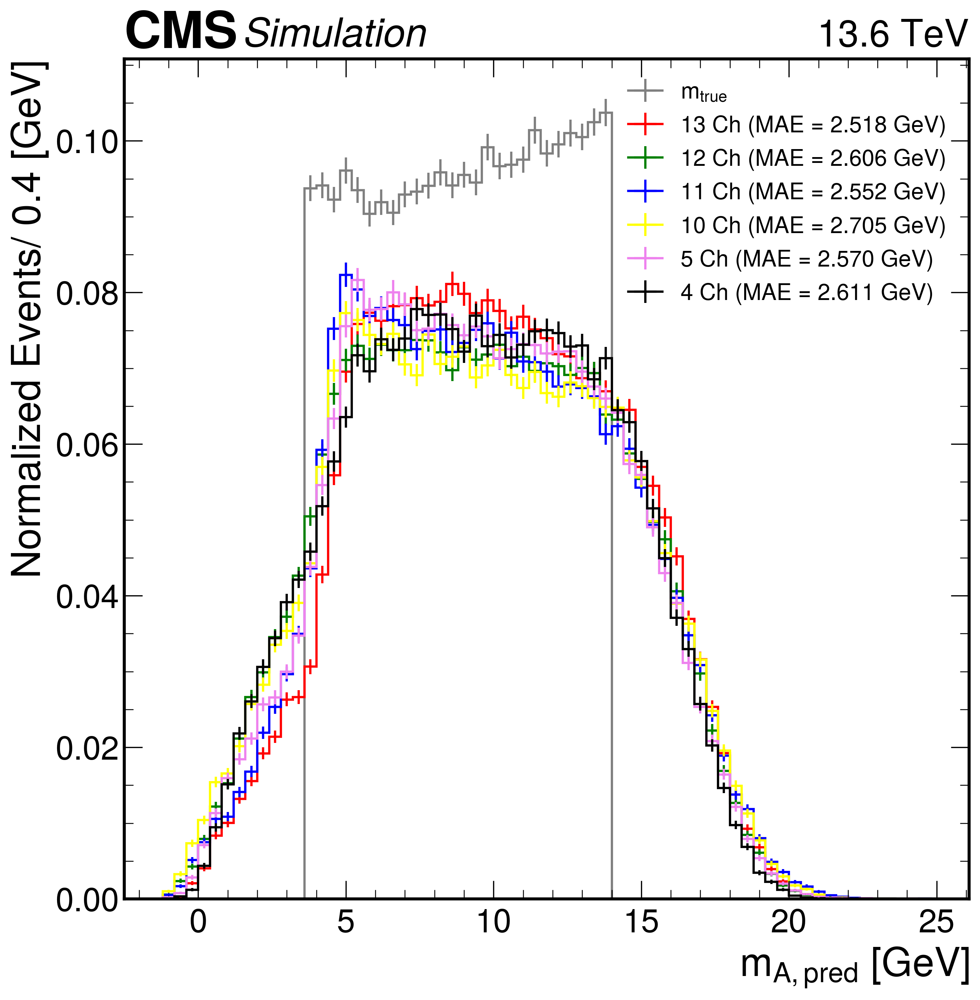

In [23]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
epoch=100
# ua_dir = 'ResNet_min_max_scaling_mN1p2To22_unbiased'
# ua_dir_no_relu = 'ResNet_min_max_scaling_mN1p2To22_unbiased_no_relu'
# model_dir = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

ua_dir_mapA = 'ResNet_mapA_mN1p2To22_unbaised'


model_dirs = ['13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'12_ResNet_mapA_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'11_ResNet_mapA_Tracks_pt_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'10_ResNet_mapA_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'5_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy'
              ,'4_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy'
               ]

channels = [[0,1,2,3,4,5,6,7,8,9,10,11,12]
            ,[1,2,3,4,5,6,7,8,9,10,11,12]
            ,[0,3,4,5,6,7,8,9,10,11,12]
            ,[3,4,5,6,7,8,9,10,11,12]
            ,[0,1,2,3,4]
            ,[0,1,2,3]
           ]
m0_min=-1.2
m0_max=25.1
bin_size =0.4

def correction(mass_raw,a=-0.04922334  ,b=-1.25575772):
            # mass = m + polynomial_mode(m)
            mass = mass_raw + a*mass_raw + b
            return mass

colors =['r', 'green', 'blue', 'yellow', 'violet','black']      

fig, ax = plt.subplots(dpi=300)
for ch, model_dir in enumerate(model_dirs):
    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir}/epoch_100_inference_data_m3p6To14.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    data_map.keys()
    infile_map.close()
    m_pred_map = data_map["m_pred"]
    m_true_map = data_map["m_true"]
    if ch==0:
        h3=np.histogram(m_true_map, bins=np.arange(m0_min,m0_max,bin_size))
        hep.histplot(h3, histtype='step', yerr=True, label=r'$m_{true}$', linestyle='-', color='grey', density=True)
    h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=f'{len(channels[ch])} Ch' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color=colors[ch], density=True)
    
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel('Normalized Events/ 0.4 [GeV]')
plt.legend(loc='best', fontsize=15)
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}/validation_set_inference_for_channel_comparion_with_ResNet_mapA_model_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()

In [15]:
! ls ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2

INFERENCE_DATA
MODELS
Validation_ATo2Tau_mass14_epoch_100_inference.pkl
Validation_ATo2Tau_mass3p7_epoch_100_inference.pkl
Validation_ATo2Tau_mass8_epoch_100_inference.pkl
epoch_100_inference_data_m3p6To14.pkl
signal_14_epoch_100_inference_data.pkl
signal_3p7_epoch_100_inference_data.pkl


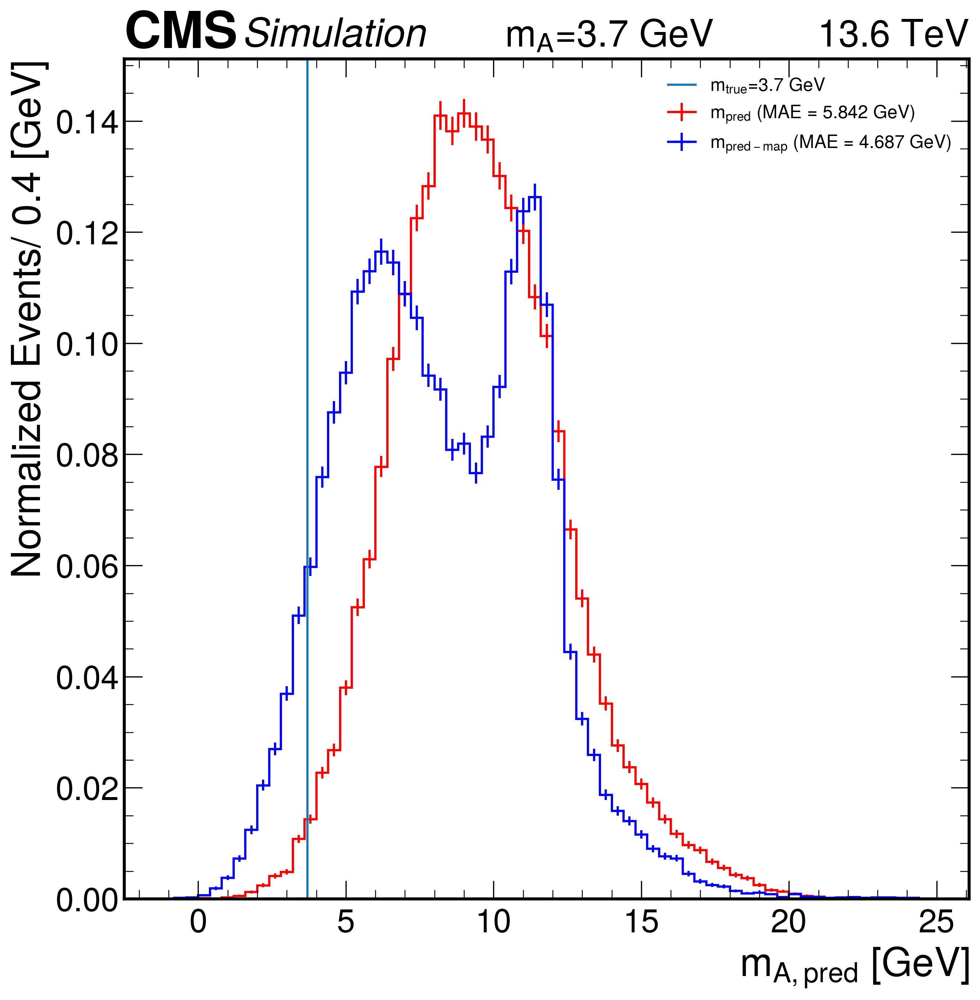

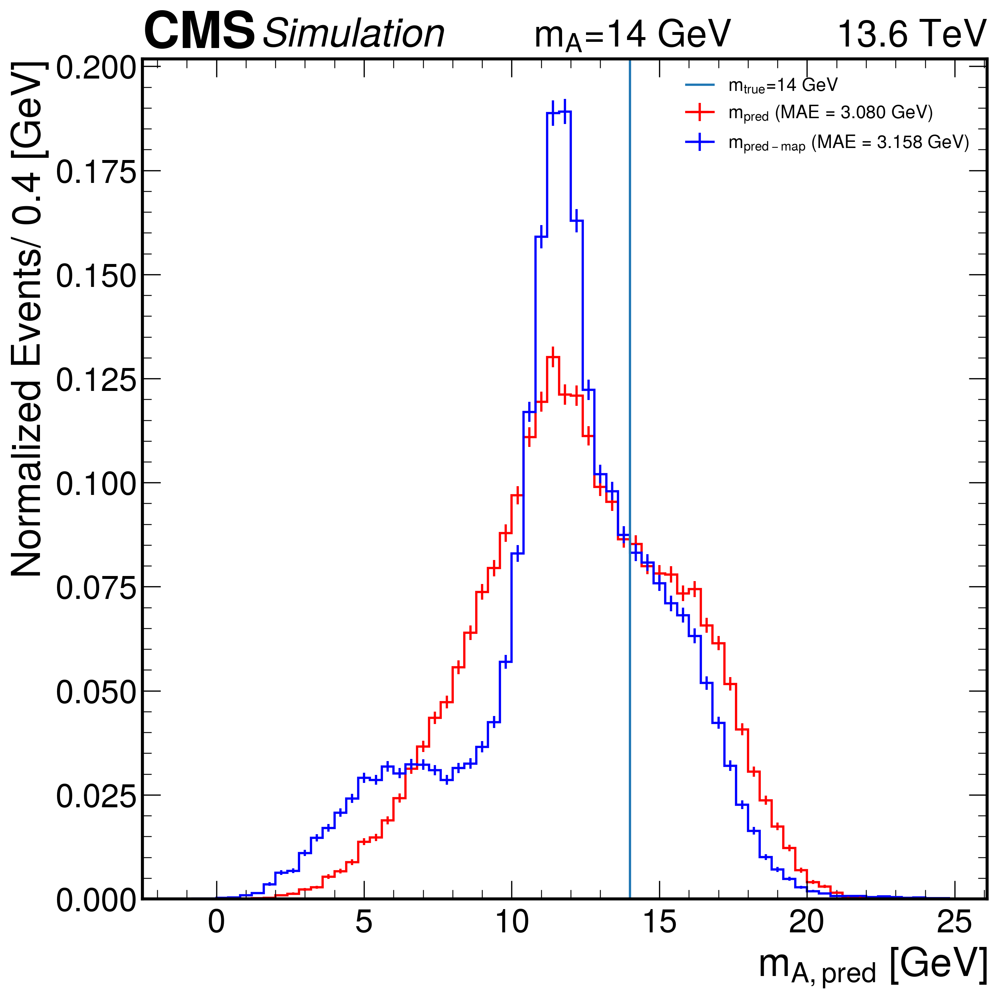

In [7]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
epoch=45
# ua_dir = 'ResNet_min_max_scaling_mN1p2To22_unbiased'
# ua_dir_no_relu = 'ResNet_min_max_scaling_mN1p2To22_unbiased_no_relu'
# model_dir = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

ua_dir_mapA = 'ResNet_MultiChannel_conv_mN1p2To22_unbaised'

model_dir = '13_ResNet_MultiChannel_conv_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
model_dir_map = '13_ResNet_MultiChannel_conv_with_map_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'


for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)


    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    data_map.keys()
    infile_map.close()
    m_pred_map = data_map["m_pred"]
    m_true_map = data_map["m_true"]

    data_file_map11 = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map11 = open(f"{data_file_map11}", "rb")
    data_map11 = pickle.load(infile_map11)
    data_map11.keys()
    infile_map11.close()
    m_pred_map11 = data_map11["m_pred"]
    m_true_map11 = data_map11["m_true"]
    
    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots(dpi=300)
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    
    h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{pred}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color='red', density=True)
    
    h3=np.histogram(m_pred_map11, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h3, histtype='step', yerr=True, label=r'$m_{pred-map}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map11 - m_pred_map11)), linestyle='-', color='blue', density=True)
    plt.xlabel(r'$m_{A, pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='best', fontsize=12)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_comparion_with_muti_conv_map_and_non_map_model_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

In [14]:
! ls ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_1_mN1p2To22_unbaised

11_ResNet_mapA_Tracks_pt_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2
13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2


### Models trained at UA

keys dict_keys(['m_true', 'm_pred', 'mae', 'mre'])


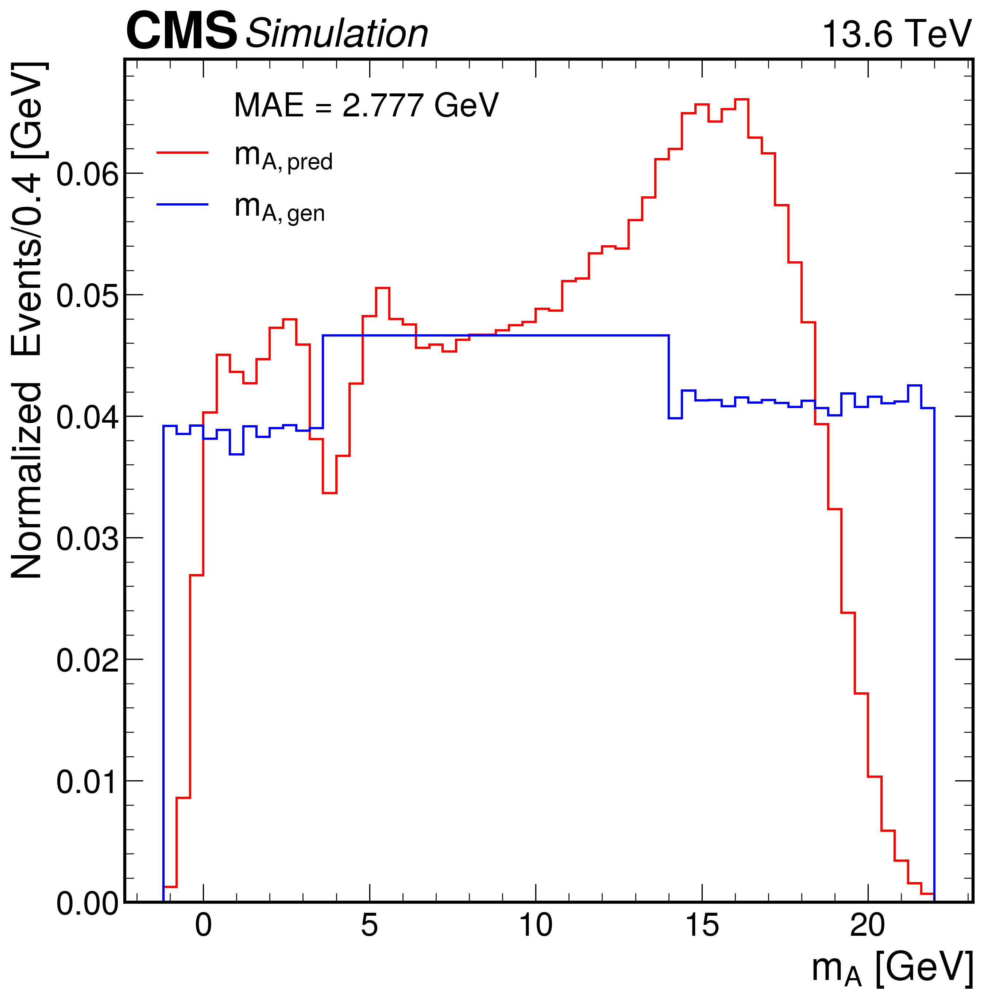

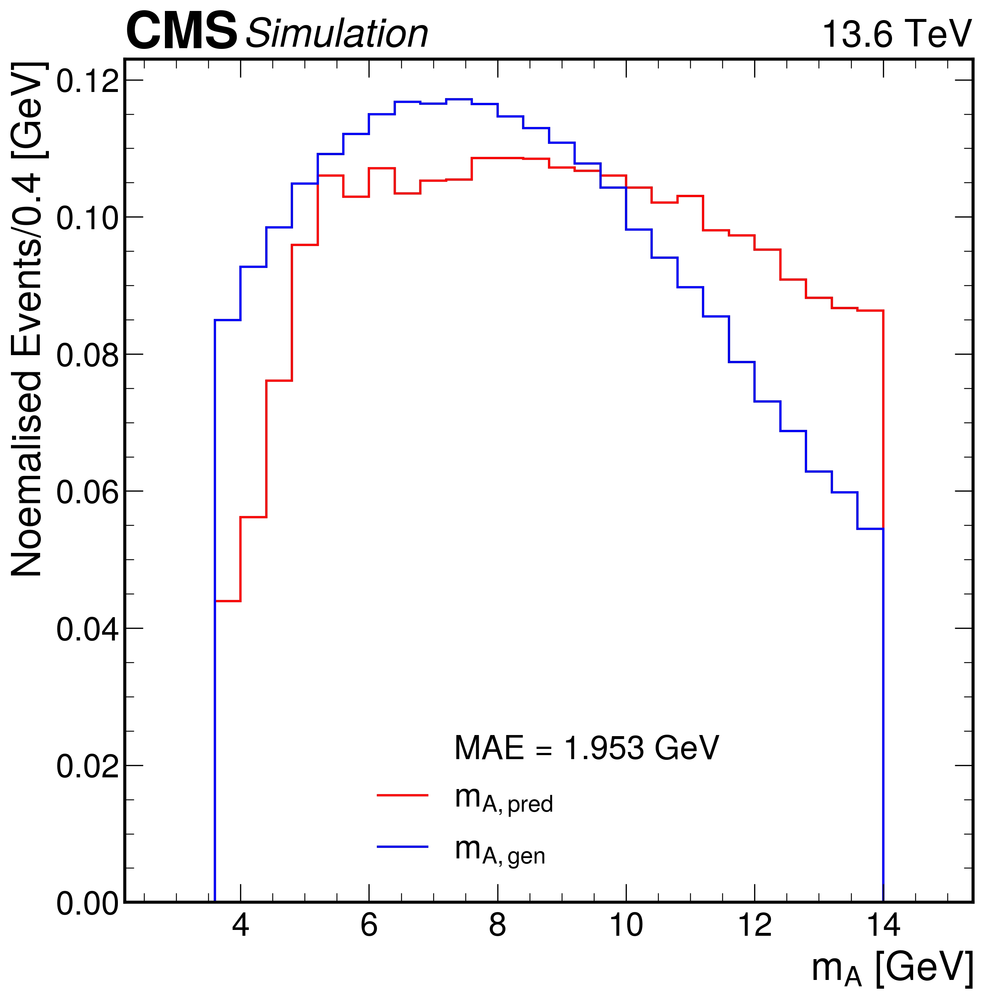

Reconstruction efficiency: 75.4859295873961 %


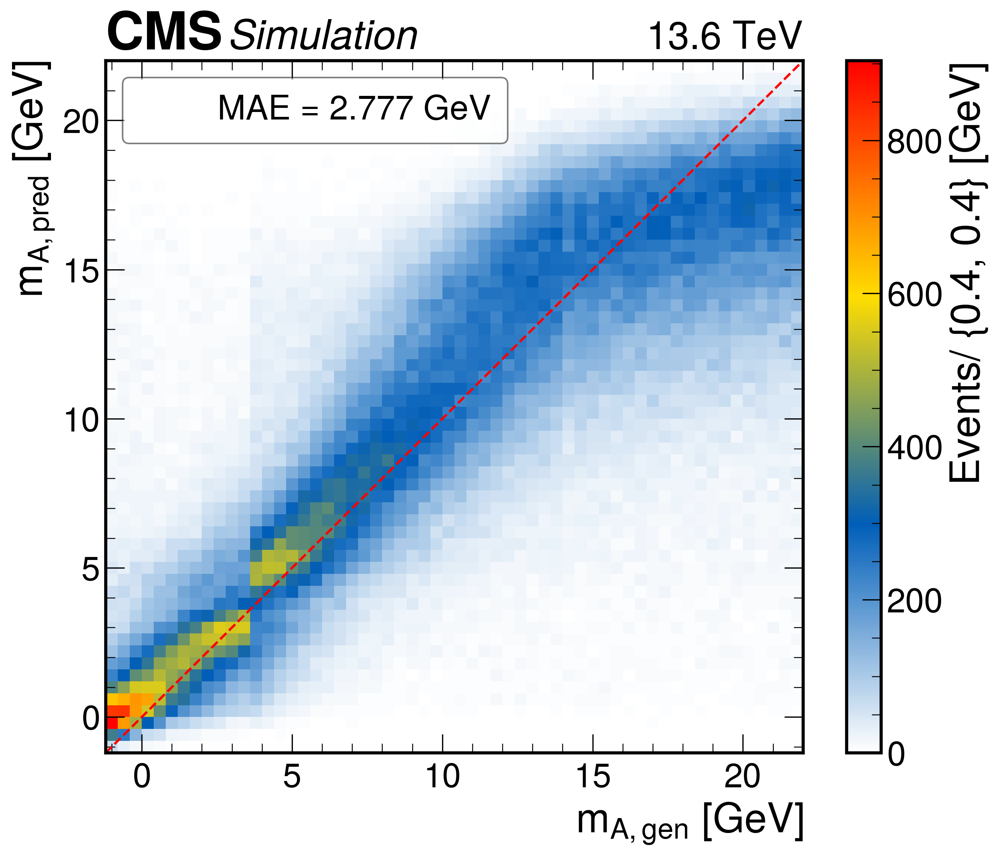

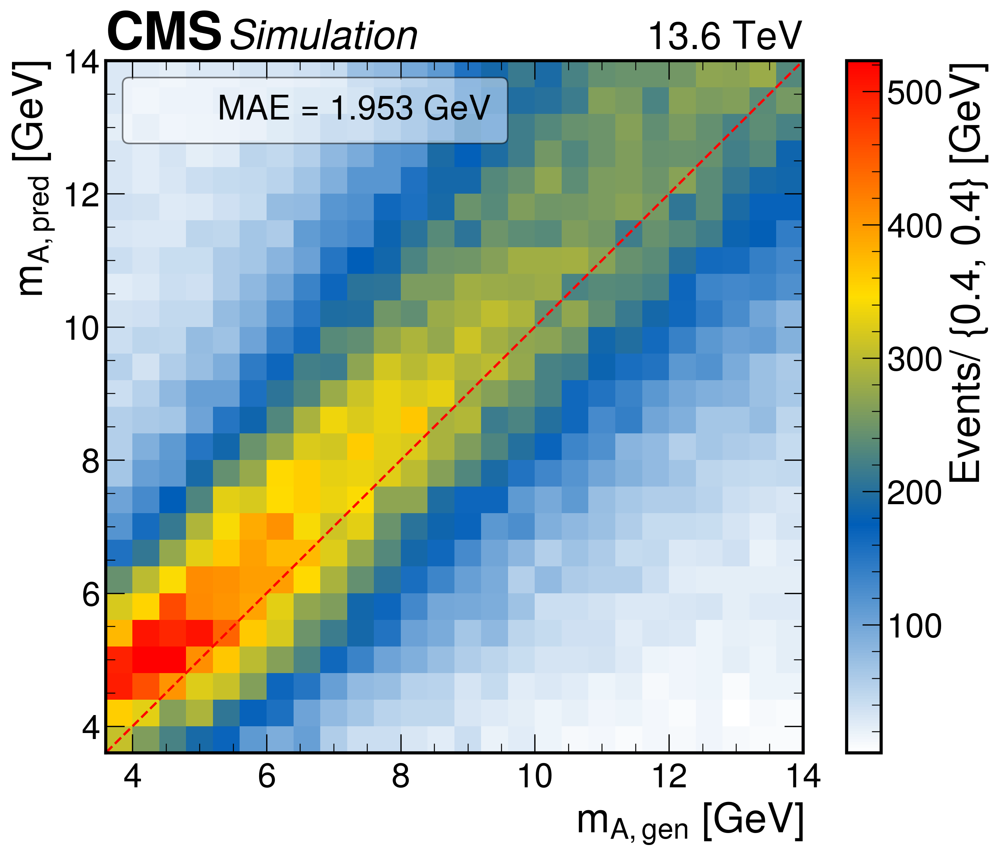

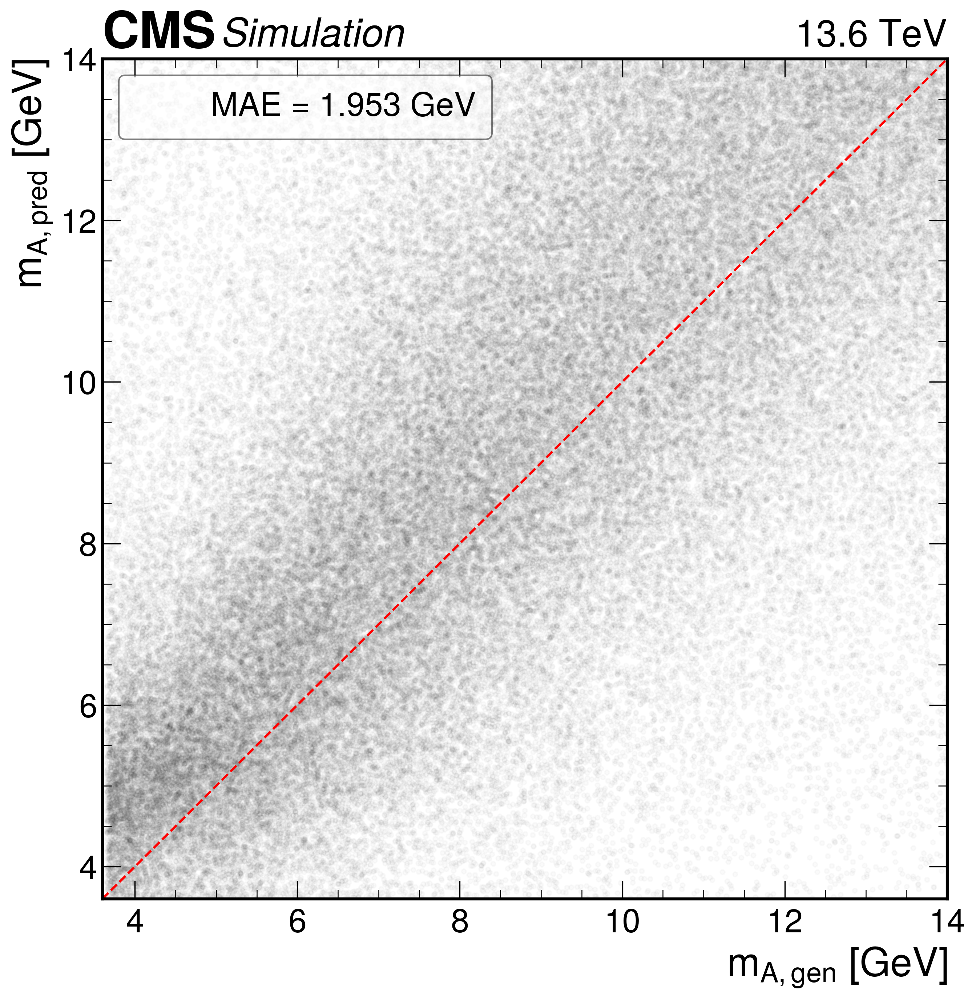

In [83]:
epoch_selected=[9,11,66,75,79,96,100]
epoch= epoch_selected[-1]

data_dir = "../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new"
ua_dir = "ResNet_mapA_1_mN1p2To22_unbaised"
model_dir = "13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2"
data_file = glob.glob(f"{data_dir}/{ua_dir}/{model_dir}/INFERENCE_DATA/epoch{epoch}_*.pkl")[0]

# print(f"loaded data file ------>  {data_file}")
infile = open(f"{data_file}", "rb")
data = pickle.load(infile)
print("keys", data.keys())
# print(f"data.keys()------>  {data.keys()}")
infile.close()

m_true = data["m_true"]
m_pred = data["m_pred"]
# m0 = data["m0"]

mask1 = (m_true >= 3.6) & (m_true <=14)
m_true_ = m_true[mask1]
m_pred_ = m_pred[mask1]
# m0_ = m0[mask1]
mask2 = (m_pred_ >=3.6) & (m_pred_ <=14)
m_true__ = m_true_[mask2]
m_pred__ = m_pred_[mask2]
# m0__ = m0_[mask2]


m0_min = -1.2
m0_max = 22.1
bin_size =0.4

fig, ax = plt.subplots(dpi=300)
plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true - m_pred)))
h1 = np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h1, histtype='step', yerr=False, label=r'$m_{A, pred}$', linestyle='-', color='red', density=True)
h2 = np.histogram(m_true, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h2, histtype='step', yerr=False, label=r'$m_{A, gen}$', linestyle='-', color='blue', density=True)
plt.xlabel(r'$m_{A}$ [GeV]')
plt.ylabel('Normalized  Events/0.4 [GeV]')
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.legend(loc='best', frameon=False, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}/mtrue_mpred_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_full_1d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()

    
    
fig, ax = plt.subplots(dpi=300)
plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true__ - m_pred__)))
h3 = np.histogram(m_pred__, bins=np.arange(m0_min+4,m0_max-7,bin_size))
hep.histplot(h3, histtype='step', yerr=False, label=r'$m_{A, pred}$', linestyle='-', color='red', density=True)
h4 = np.histogram(m_true__, bins=np.arange(m0_min+4,m0_max-7,bin_size))
hep.histplot(h4, histtype='step', yerr=False, label=r'$m_{A, gen}$', linestyle='-', color='blue', density=True)
plt.xlabel(r'$m_{A}$ [GeV]')
plt.ylabel(r'Noemalised Events/0.4 [GeV]')
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}//mtrue_mpred_roi_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_1d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()
    
print("Reconstruction efficiency:", len(m_pred__)/len(m_true_)*100 ,"%")

    
fig, ax = plt.subplots(figsize=(10,8),dpi=300)
plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true - m_pred)))
hist = plt.hist2d(np.squeeze(m_true), np.squeeze(m_pred), bins=[np.arange(m0_min, m0_max, .4), np.arange(m0_min, m0_max, .4)], cmap=cms_cmap)
plt.xlabel(r'$m_{A, gen}$ [GeV]')
plt.ylabel(r'$m_{A, pred}$ [GeV]')
plt.plot((m0_min, m0_max), (m0_min, m0_max), color='r', linestyle='--')
plt.colorbar().set_label(label='Events/ {0.4, 0.4} [GeV]')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.legend(loc='upper left', frameon=True, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}//mtrue_mpred_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_full_2d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()

fig, ax = plt.subplots(figsize=(10,8),dpi=300)
plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true__ - m_pred__)))
hist = plt.hist2d(np.squeeze(m_true__), np.squeeze(m_pred__), bins=[np.arange(3.6, 14.1, .4), np.arange(3.6, 14.1, .4)], cmap=cms_cmap)
plt.xlabel(r'$m_{A, gen}$ [GeV]')
plt.ylabel(r'$m_{A, pred}$ [GeV]')
plt.plot((m0_min, m0_max), (m0_min, m0_max), color='r', linestyle='--')
plt.colorbar().set_label(label='Events/ {0.4, 0.4} [GeV]')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.legend(loc='upper left', frameon=True, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}/mtrue_mpred_roi_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_2d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()


fig, ax = plt.subplots(dpi=300)
plt.plot(m_true__, m_pred__, ".", color='black', alpha=0.02, label='MAE = %.3f GeV'%np.mean(np.abs(m_true__ - m_pred__)))
plt.xlabel(r'$m_{A, gen}$ [GeV]')
plt.ylabel(r'$m_{A, pred}$ [GeV]')
m0_min, m0_max = 3.6, 14.0
plt.plot((m0_min, m0_max), (m0_min, m0_max), color='r', linestyle='--')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.xlim(m0_min, m0_max)
plt.ylim(m0_min, m0_max)
plt.legend(loc='upper left', frameon=True, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}/mtrue_mpred_roi_scatter_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()



In [ ]:
def correction(mass_raw,a=-0.04922334  ,b=-1.25575772):
            # mass = m + polynomial_mode(m)
            mass = mass_raw + a*mass_raw + b
            return mass
        
        
m0_min = 3.6
m0_max = 14.
bin_size =0.4
epoch= 100

data_dir = "../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new"
ua_dir = "ResNet_mapA_mN1p2To22_unbaised"
model_dir = "13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2"
data_file = glob.glob(f"{data_dir}/{ua_dir}/{model_dir}/epoch_{epoch}_inference_data_m3p6To14.pkl")[0]

# print(f"loaded data file ------>  {data_file}")
infile = open(f"{data_file}", "rb")
data = pickle.load(infile)
print("keys", data.keys())
# print(f"data.keys()------>  {data.keys()}")
infile.close()

m_true = data["m_true"].flatten()
m_pred = correction(data["m_pred"].flatten())
m0 = data["m0"].flatten()

bins = np.arange(m0_min, m0_max + bin_size, bin_size)

# total number of true events in each bin
total, _ = np.histogram(m_true, bins=bins)


# number of events reconstructed properly (m_pred in ROI)
reconstructed_mask = (m_pred >= 3.6) & (m_pred <= 14)

reconstructed, _ = np.histogram(m_true[reconstructed_mask], bins=bins)
reconstructed0, _ = np.histogram(m0[reconstructed_mask], bins=bins)

# efficiency
efficiency = np.divide(reconstructed, total, out=np.zeros_like(reconstructed, dtype=float), where=total > 0)
efficiency0 = np.divide(reconstructed0, total, out=np.zeros_like(reconstructed, dtype=float), where=total > 0)

# Bin centers for plotting
bin_centers = 0.5 * (bins[1:] + bins[:-1])

# Binomial errors
errors = np.sqrt(efficiency * (1 - efficiency) / total)
errors[total == 0] = 0  # avoid nan for empty bins

errors0 = np.sqrt(efficiency0 * (1 - efficiency0) / total)
errors0[total0 == 0] = 0  # avoid nan for empty bins

# Plot
fig, ax = plt.subplots(dpi=300)
# plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true__ - m_pred__)))
plt.errorbar(bin_centers, efficiency, yerr=errors, xerr=bin_size/2,
             fmt=".", color="r", markersize=1, linewidth=1,
             label="E2E Efficiency")

plt.errorbar(bin_centers, efficiency0, yerr=errors0, xerr=bin_size/2,
             fmt=".", color="b", markersize=1, linewidth=1,
             label="PF Efficiency")

plt.xlabel(r"$m_{A, gen}$ [GeV]")
plt.ylabel("$m_A$ Reconstruction Efficiency")
plt.ylim(0, 1.05)
plt.grid(alpha=0.3)
plt.legend()
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.savefig(f'{out_dir}/mass_regressor_reconstruction_e2e_pf_effficiency.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()


keys dict_keys(['m_true', 'm_pred', 'm0', 'mar', 'mre'])


In [41]:

# def plot_pred_signal_mass_jet_mass(Mass, data_file, model_dir):
#     infile = open(f"{data_file}", "rb")
#     data = pickle.load(infile)
#     print(model_dir)
#     infile.close()

#     m_true = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)
#     m_pred = data["m_pred"]
#     jet_mass = data["jet_mass"]
#     jet_pt = data["jet_pt"]

#     mask2 = (m_pred >=3.6) & (m_pred <=14)
#     m_pred_ = m_pred[mask2]
#     jet_mass_ = jet_mass[mask2]
#     jet_pt_ = jet_pt[mask2]

#     m0_min=-1.2
#     m0_max=25.1
#     bin_size =0.4
#     fig, ax = plt.subplots(dpi=300)
#     plt.axvline(m_true, label=r"$m_{true}$" + f"={m_true} GeV")
#     plt.hist(m_pred, bins=np.arange(m0_min,m0_max,bin_size), histtype='step', label=r'$m_{pred}$  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred)), linestyle='-', color='red', linewidth=2)
#     plt.hist(jet_mass, bins=np.arange(m0_min,m0_max,bin_size), histtype='step', label=r'$jet_{mass}$', linestyle='-', color='black')
#     plt.xlabel(r'$m_{A, gen}$ [GeV]')
#     plt.ylabel('Events/ 0.4 [GeV]')
#     plt.legend(loc='upper right', fontsize=12)
#     hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
#     # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_{model_dir}_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
#     plt.show()

In [9]:

def plot_pred_signal_mass_jet_mass(Mass, data_file, model_dir):
    infile = open(f"{data_file}", "rb")
    data = pickle.load(infile)
    print(model_dir)
    infile.close()

    m_true = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)
    m_pred = data["m_pred"]
    jet_mass = data["jet_mass"]
    jet_pt = data["jet_pt"]

    # mask2 = (m_pred >=3.6) & (m_pred <=14)
    # m_pred_ = m_pred[mask2]
    # jet_mass_ = jet_mass[mask2]
    # jet_pt_ = jet_pt[mask2]

    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots(dpi=300)
    plt.axvline(m_true, label=r"$m_{true}$" + f"={m_true} GeV")
    h1=np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h1, histtype='step', yerr=True, label=r'$m_{pred}$  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred)), color='red')
    h2=np.histogram(jet_mass, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$jet_{mass}$', linestyle='-', color='black')
    plt.xlabel(r'$m_{A, gen}$ [GeV]')
    plt.ylabel('Events/ 0.4 [GeV]')
    plt.legend(loc='upper right', fontsize=12)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_{model_dir}_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

13_ResNet_map_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2


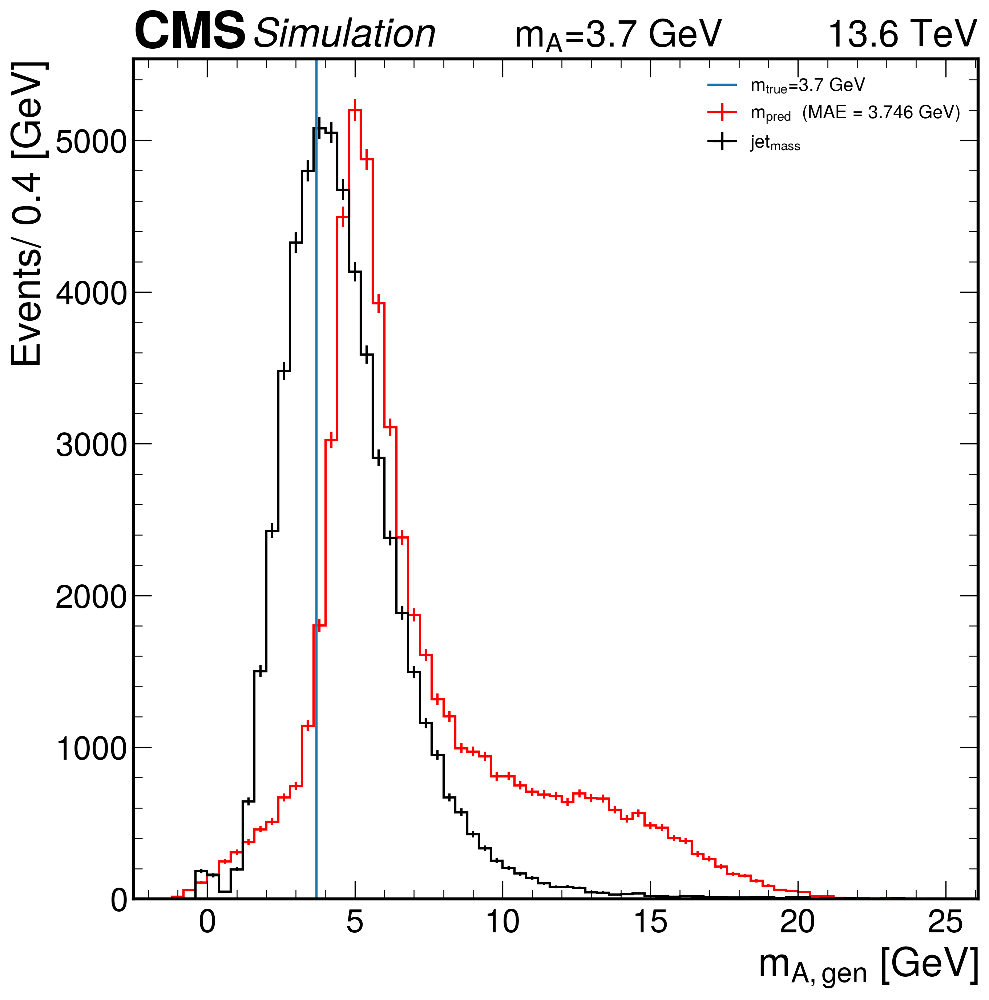

In [10]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'

ua_dir = 'ResNet_min_max_scaling_mN1p2To22_unbiased_map_no_relu'
model_dir_ua = ['13_ResNet_map_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2']




epoch=100
Mass = ['3p7', '14']
Mass=Mass[0]
for model_dir in model_dir_ua:
    data_file = glob.glob(f"{data_dir}/{ua_dir}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    plot_pred_signal_mass_jet_mass(Mass, data_file, model_dir)

### Plot e2e prediction for different jet pt ranges

In [72]:

def plot_e2e_prediction_pf_jet_mass(mass=3.7, plot="m_pred", in_file="../analysis_run3/Data_for_plots/mass_regression_test_data/upper_lower_streching_epoch_36_signal_mass_3p7_inference_data.pkl", channels=[0]):
    infile = open(f"{in_file}", "rb")
    data = pickle.load(infile)
    print(f"loaded data file ------>  {in_file}")
    infile.close()
    m0_min, m0_max, bin_size = -1.2, 22.2, 0.4
    m_true = mass
    m_pred = data[f"{plot}"]
    jet_mass = data["jet_mass"]
    jet_pt = data["jet_pt"]

    mask1 = (jet_pt >=20) & (jet_pt <55)
    mask2 = (jet_pt >=55) & (jet_pt <70)
    mask3 = (jet_pt >=70) & (jet_pt <100)
    mask4 = jet_pt >=100
    
    def correction(mass_raw,a=-0.04922334  ,b=-1.25575772):
            # mass = m + polynomial_mode(m)
            mass = mass_raw + a*mass_raw + b
            return mass
        
    m_pred1= correction(m_pred[mask1])
    m_pred2= correction(m_pred[mask2]) 
    m_pred3= correction(m_pred[mask3])
    m_pred4= correction(m_pred[mask4])



    fig, ax = plt.subplots(dpi=300)
    if plot=='m_pred': 
        plt.plot([], [], ' ', label=f'From E2E {len(channels)} Channel')
        name_tag='E2E'
    else: 
         plt.plot([], [], ' ', label='From PF Jet mass')
         name_tag='Jet_mass'
    plt.axvline(m_true, linestyle='--', label=r"$m_{true}$" + f"={m_true} GeV", color='grey', alpha=0.5)

    # Define bin edges and centers
    bins = np.arange(m0_min, m0_max, bin_size)
    bin_centers = 0.5 * (bins[1:] + bins[:-1])




    # Helper to plot histogram and error bars
    def plot_with_errors(data, label, color, error_bar):
        counts, _ = np.histogram(data, bins=bins)
        norm = np.sum(counts)
        counts_norm = counts / norm
        errors = np.sqrt(counts) / norm
        # plt.hist(data, bins=bins, histtype='step', label=label, color=color, density=True, linewidth=2)
        plt.errorbar(bin_centers, counts_norm, yerr=errors, fmt=error_bar, color=color, markersize=6, linewidth=1, label=label)

    # Plot each pt region
    plot_with_errors(m_pred1, r'low $p_{T,jet}$ '+' (MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred1)), 'red', 'o')
    plot_with_errors(m_pred2, r'mid $p_{T,jet}$ '+' (MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred2)), 'black', 's')
    plot_with_errors(m_pred3, r'high $p_{T,jet}$ '+' (MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred3)), 'blue', 'v')
    plot_with_errors(m_pred4, r'ultra $p_{T,jet}$ '+' (MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred4)), 'green', 'd')
    plt.xlabel(r'$m_{A,pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    if mass==3.7:
        plt.ylim(0,0.15)
    if mass==14:
        plt.ylim(0,0.09)
    plt.legend(loc='best', fontsize=20)
    hep.cms.label(llabel="Simulation  ", rlabel=f"$m_A$={m_true} GeV           "   +   "13.6 TeV", loc=0, ax=ax)
    plt.tight_layout()
    mass_str = str(mass).replace('.', 'p')
    # plt.savefig(f'{out_dir}/mass_reg_channel_test_signal_mass_{mass_str}_prediction_from_{len(channels)}_model.pdf',facecolor='w',dpi=300)
    plt.show()


loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_3p7_epoch_100_inference_data.pkl


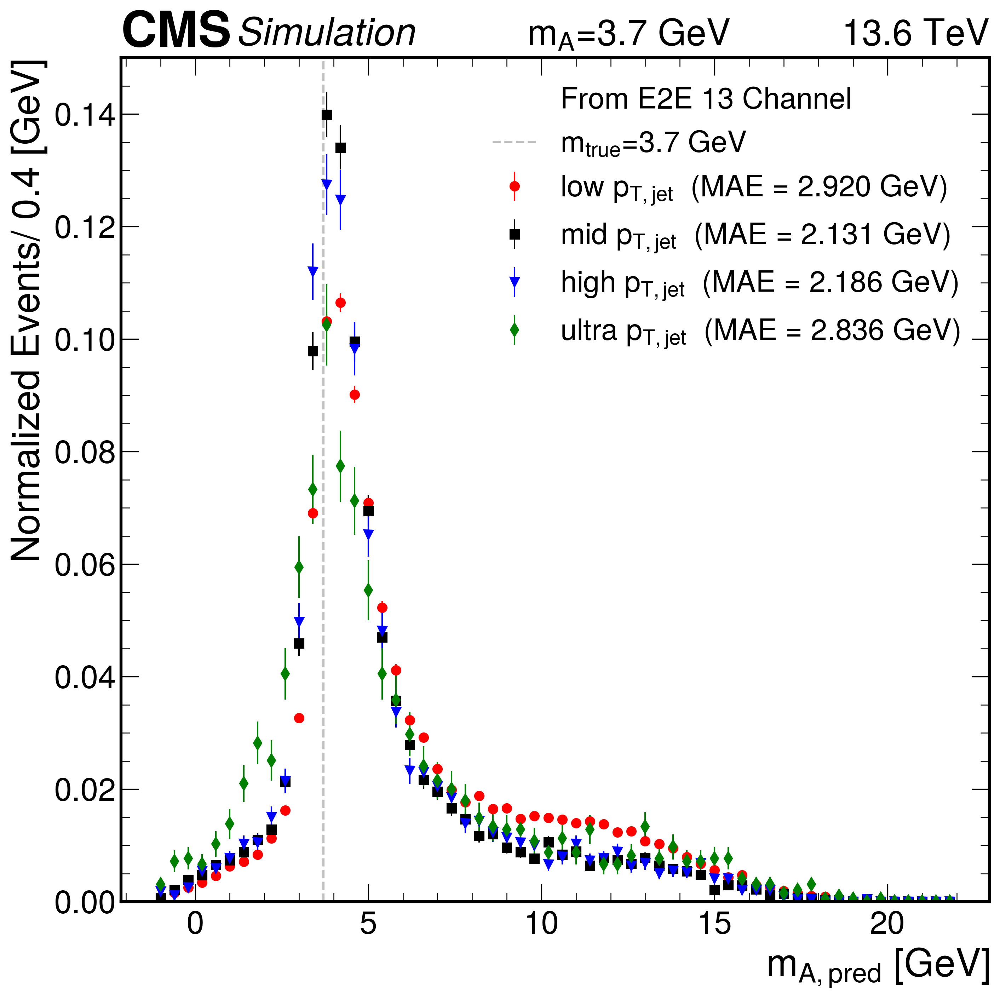

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/12_ResNet_mapA_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_3p7_epoch_100_inference_data.pkl


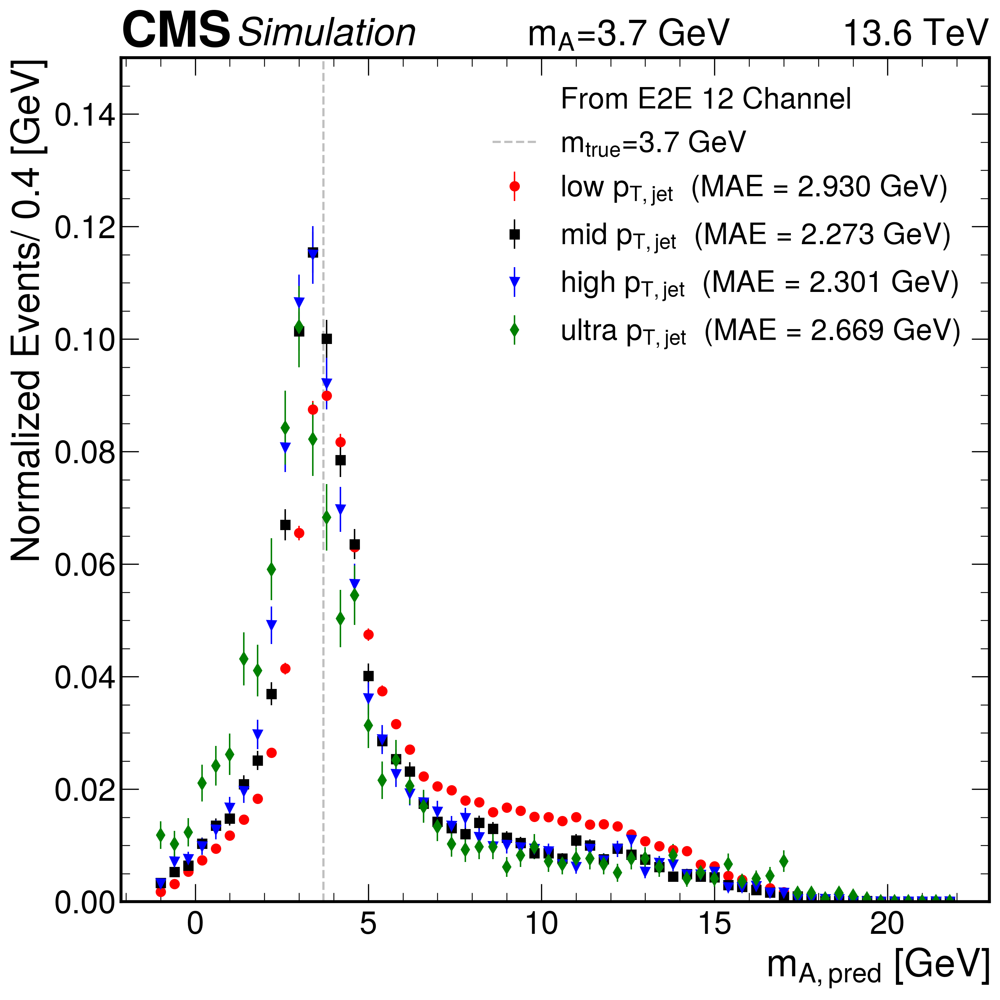

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/11_ResNet_mapA_Tracks_pt_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_3p7_epoch_100_inference_data.pkl


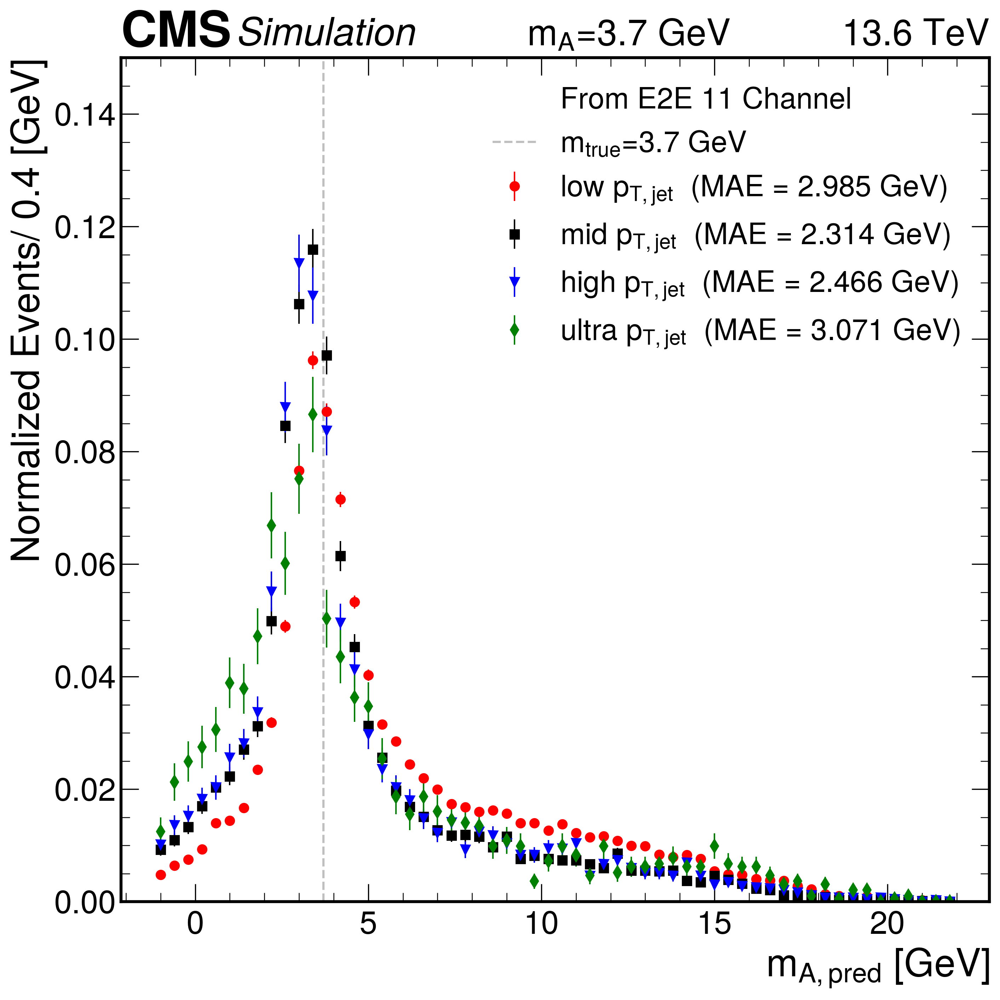

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/10_ResNet_mapA_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_3p7_epoch_100_inference_data.pkl


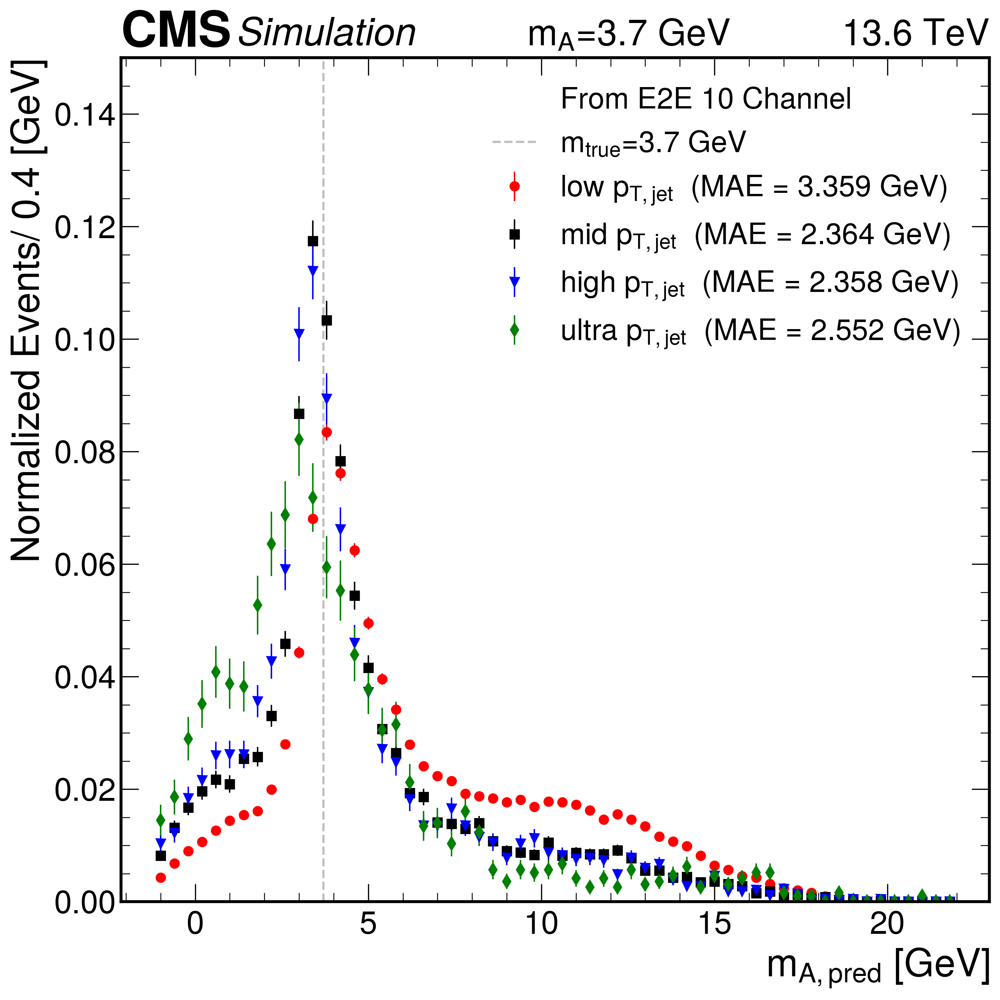

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/5_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy/signal_3p7_epoch_100_inference_data.pkl


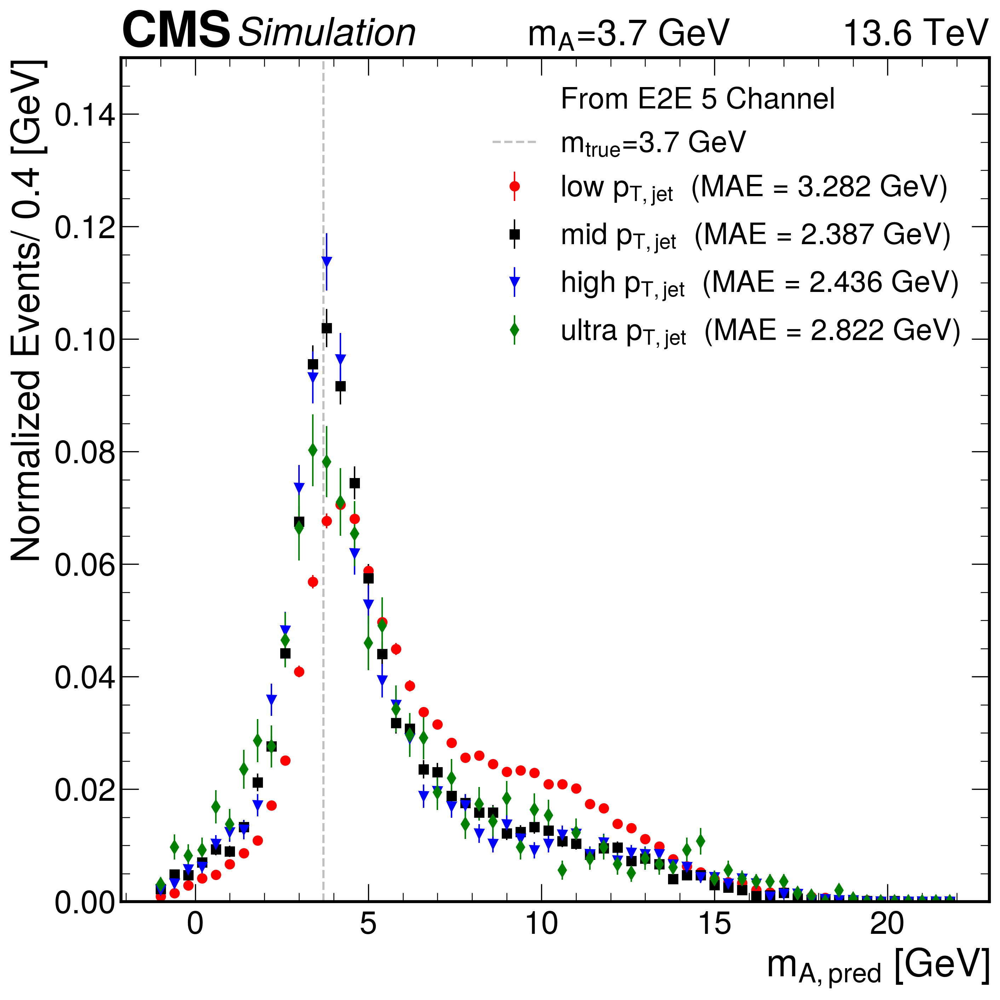

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/4_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy/signal_3p7_epoch_100_inference_data.pkl


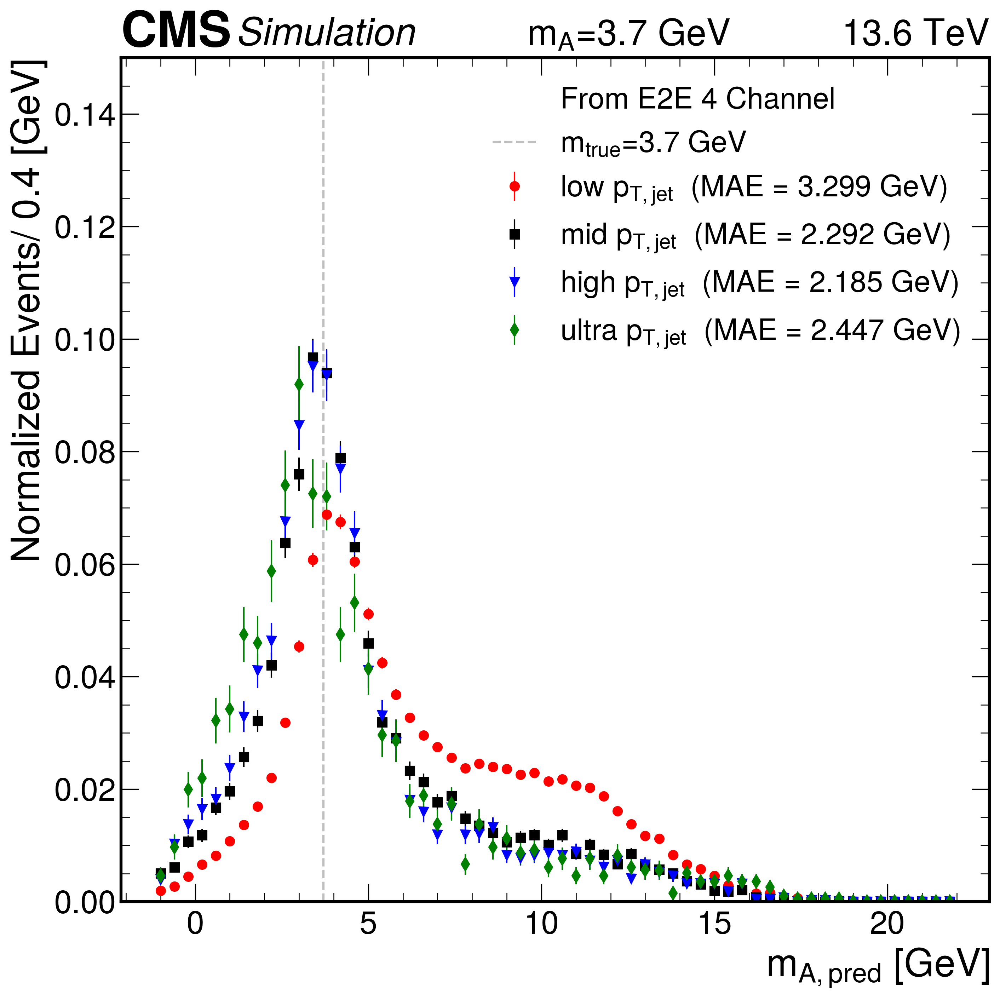

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_14_epoch_100_inference_data.pkl


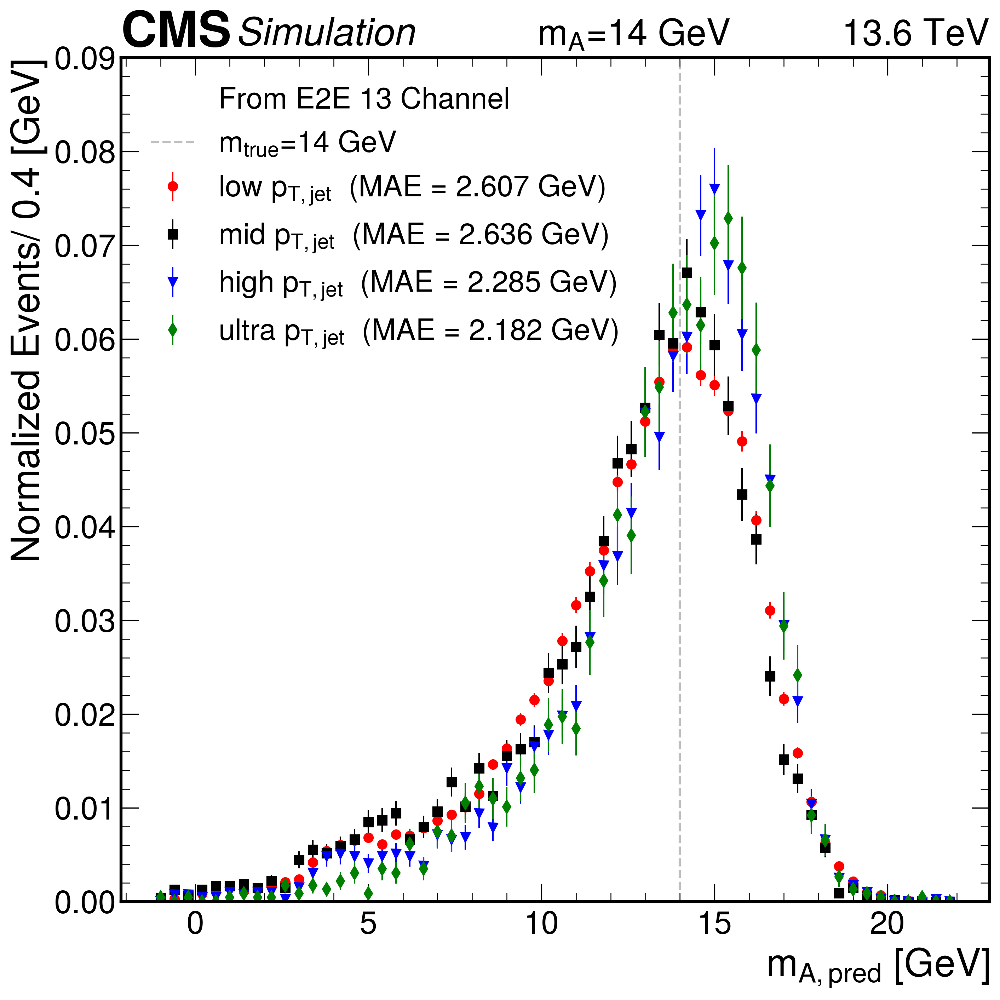

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/12_ResNet_mapA_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_14_epoch_100_inference_data.pkl


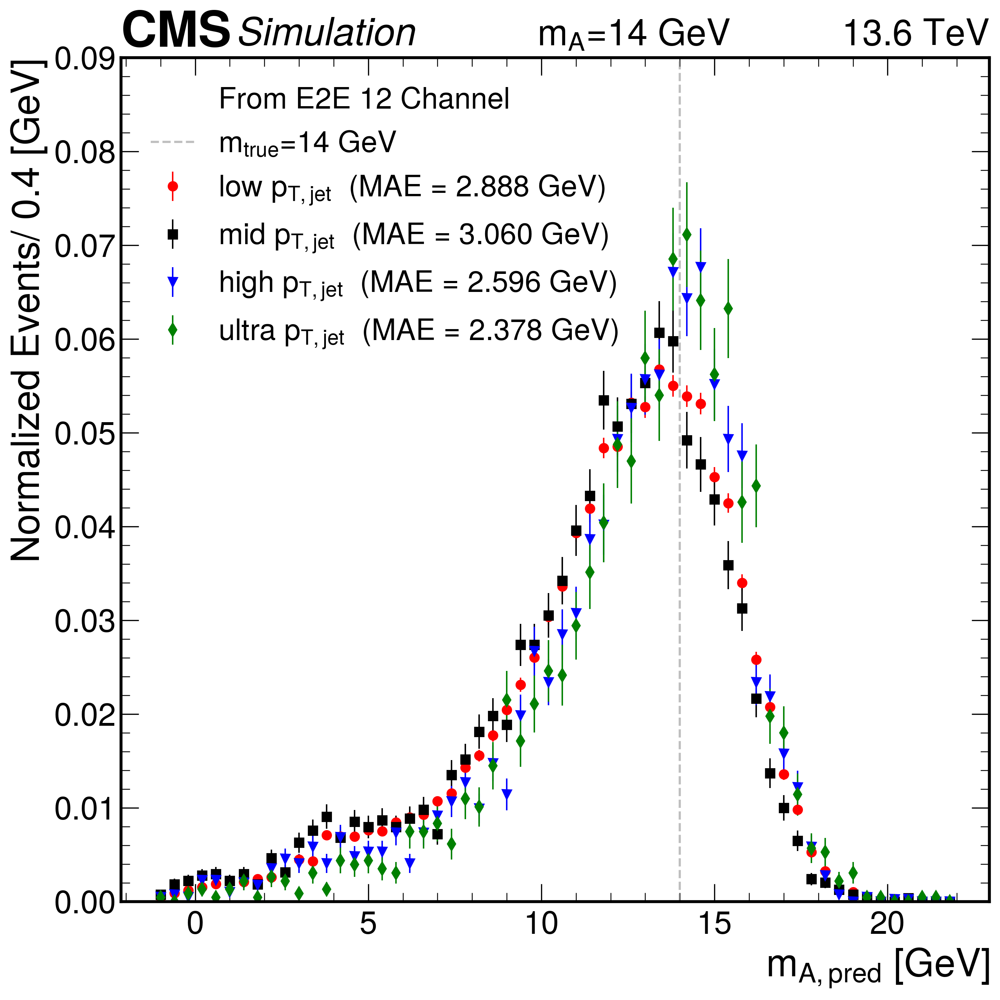

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/11_ResNet_mapA_Tracks_pt_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_14_epoch_100_inference_data.pkl


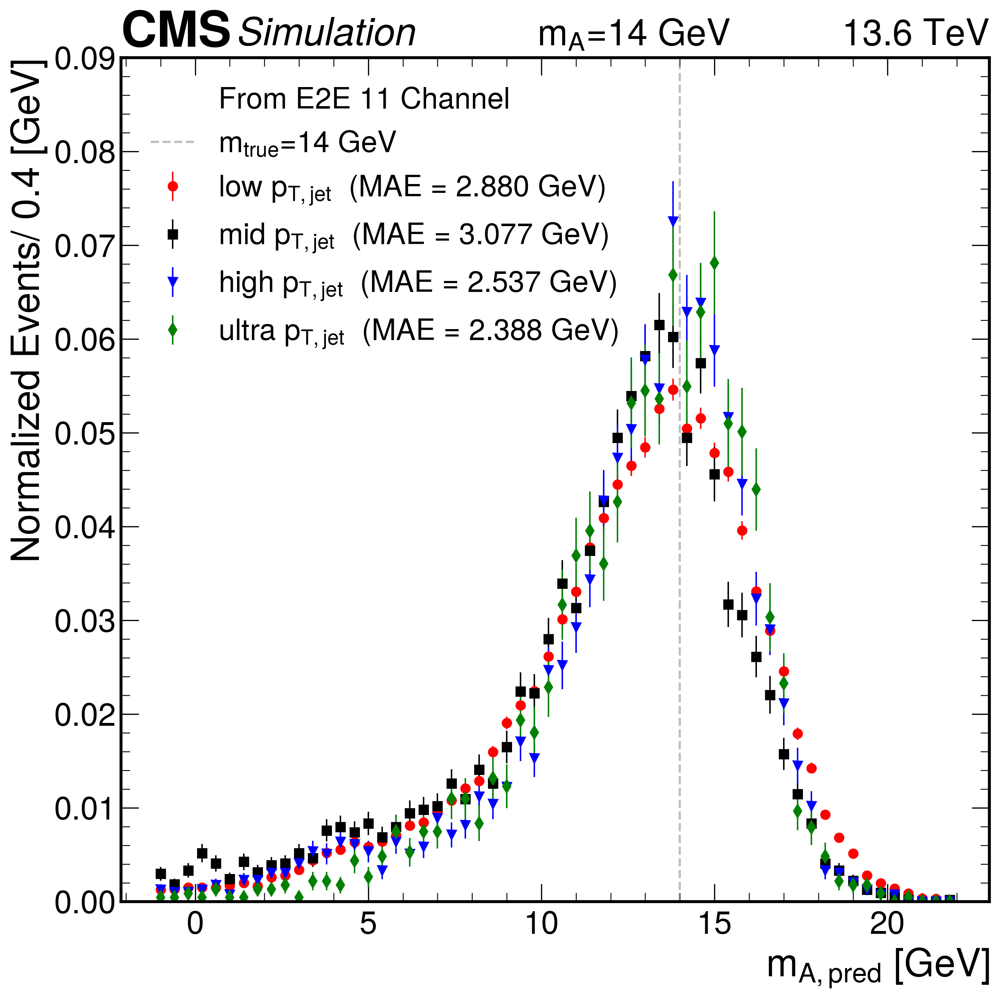

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/10_ResNet_mapA_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_14_epoch_100_inference_data.pkl


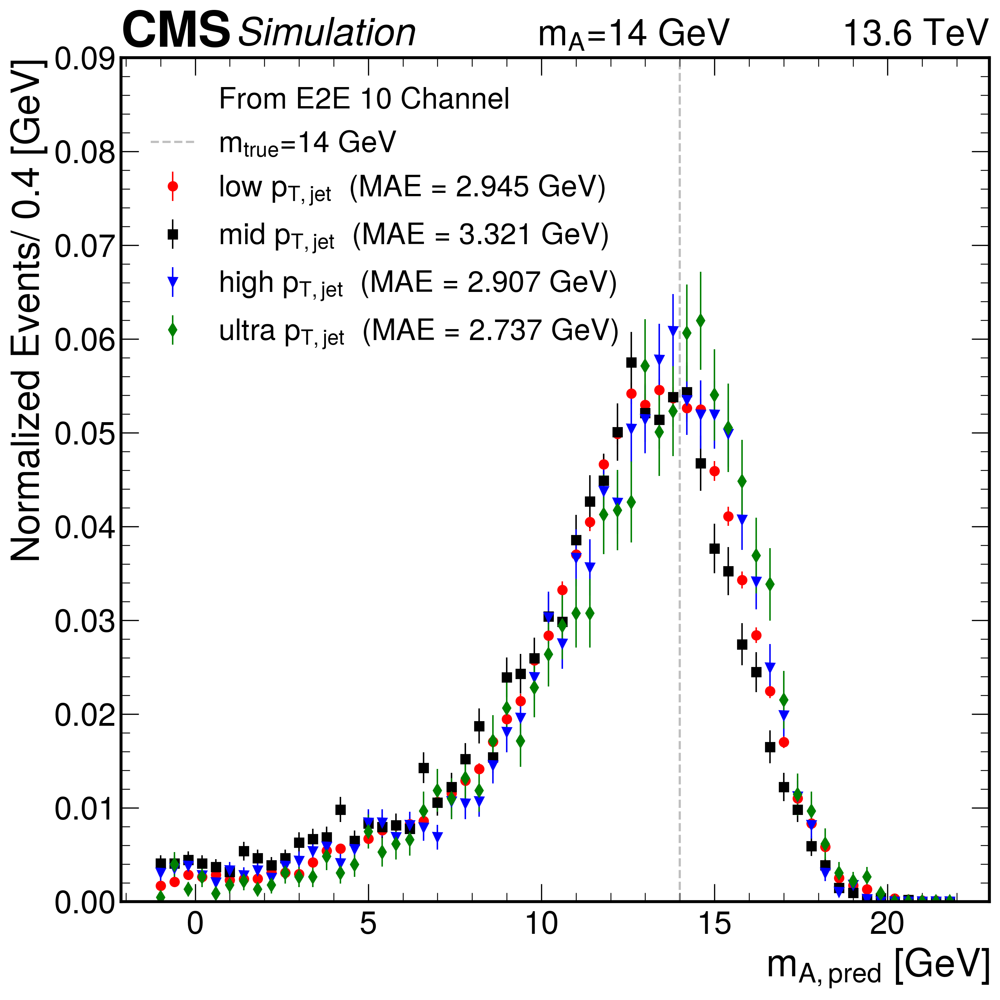

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/5_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy/signal_14_epoch_100_inference_data.pkl


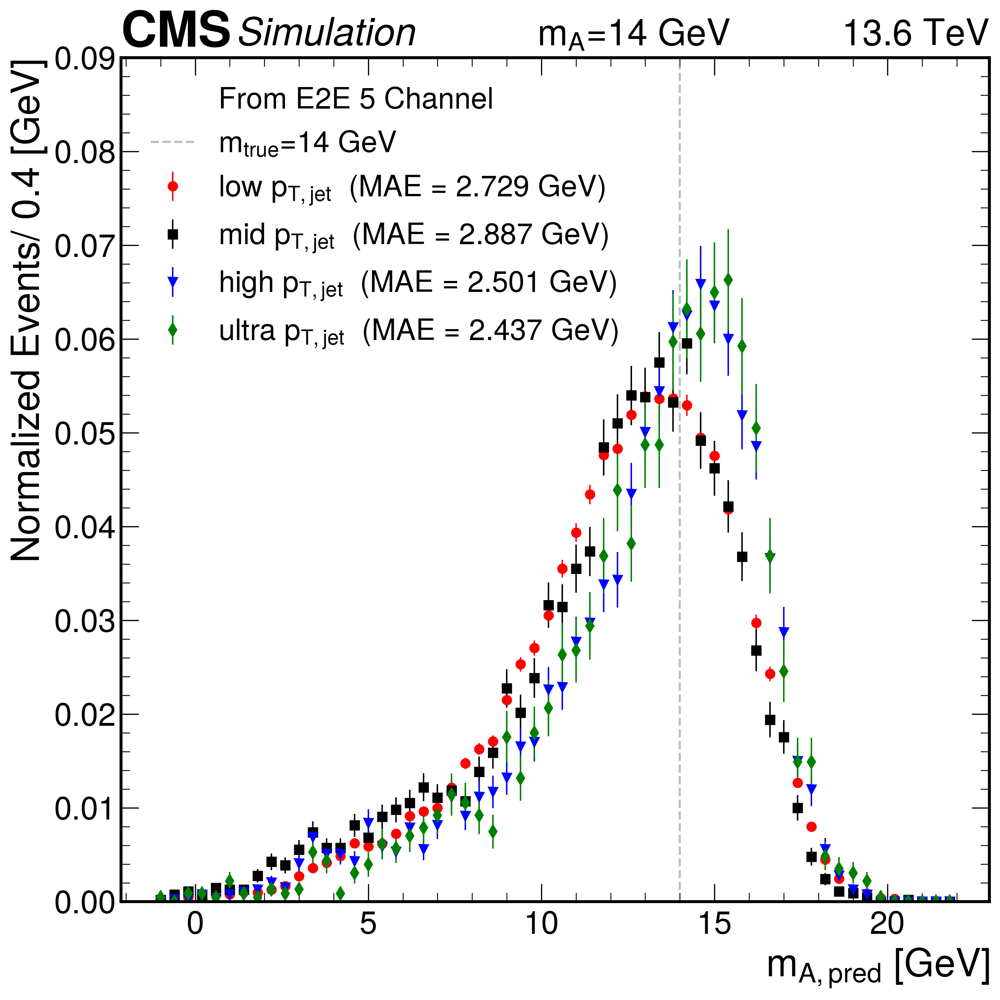

loaded data file ------>  ../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised/4_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy/signal_14_epoch_100_inference_data.pkl


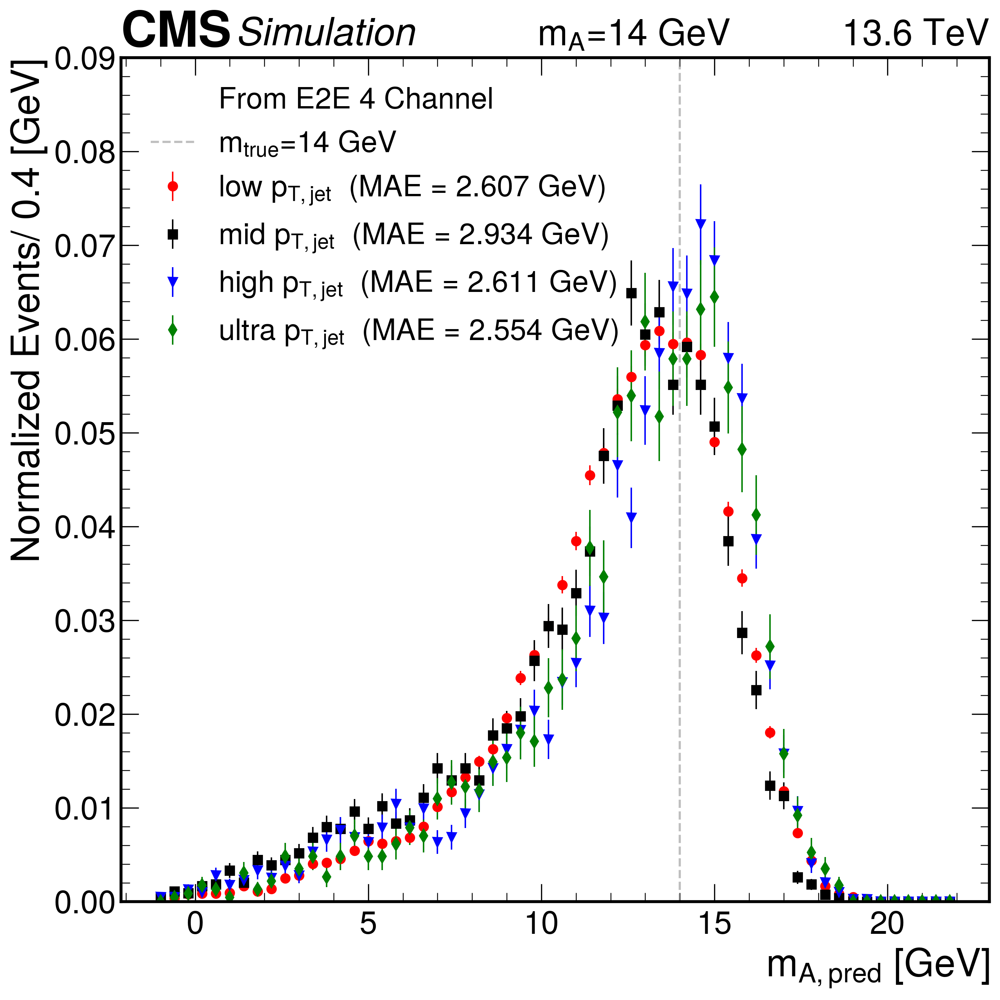

In [73]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
epoch=100

ua_dir_mapA = 'ResNet_mapA_mN1p2To22_unbaised'


model_dirs = ['13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'12_ResNet_mapA_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'11_ResNet_mapA_Tracks_pt_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'10_ResNet_mapA_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
              ,'5_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy'
              ,'4_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy'
               ]

channels = [[0,1,2,3,4,5,6,7,8,9,10,11,12]
            ,[1,2,3,4,5,6,7,8,9,10,11,12]
            ,[0,3,4,5,6,7,8,9,10,11,12]
            ,[3,4,5,6,7,8,9,10,11,12]
            ,[0,1,2,3,4]
            ,[0,1,2,3]
           ]

Masses = ['3p7', '14']


colors =['r', 'green', 'blue', 'yellow', 'violet','black']      
for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)
    for ch, model_dir in enumerate(model_dirs):
        data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
        plot_e2e_prediction_pf_jet_mass(mass=m_true_mass, plot="m_pred", in_file=data_file_map, channels=channels[ch])
    
    

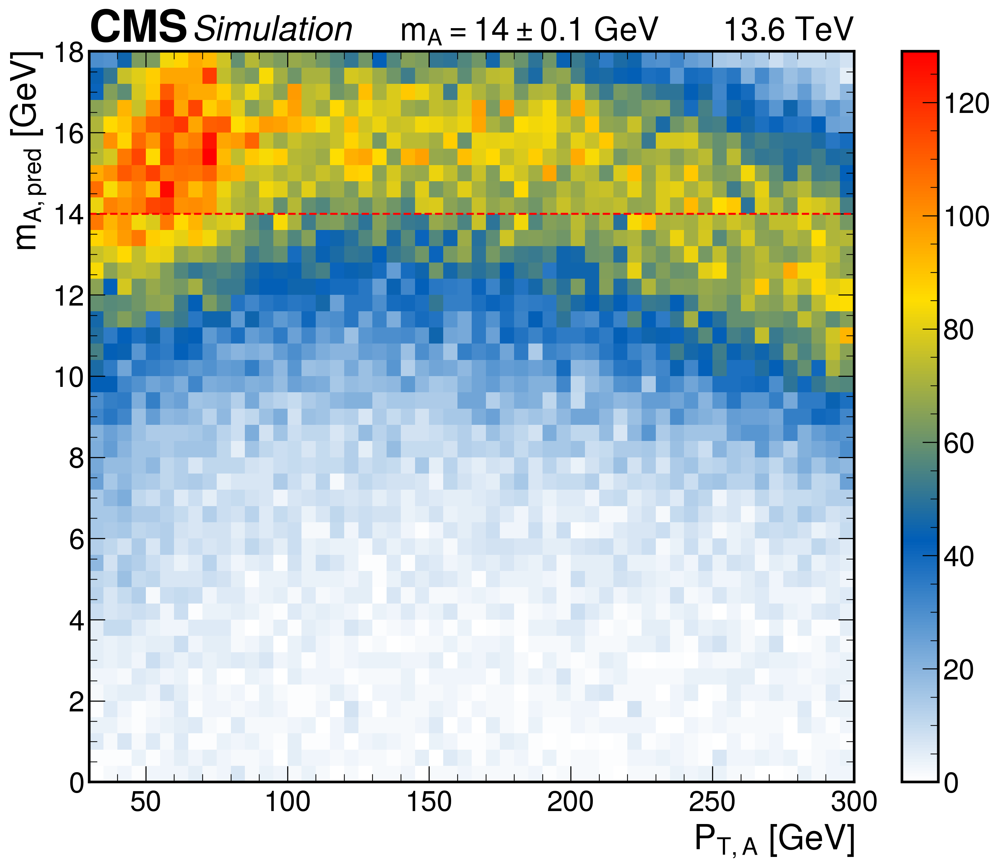

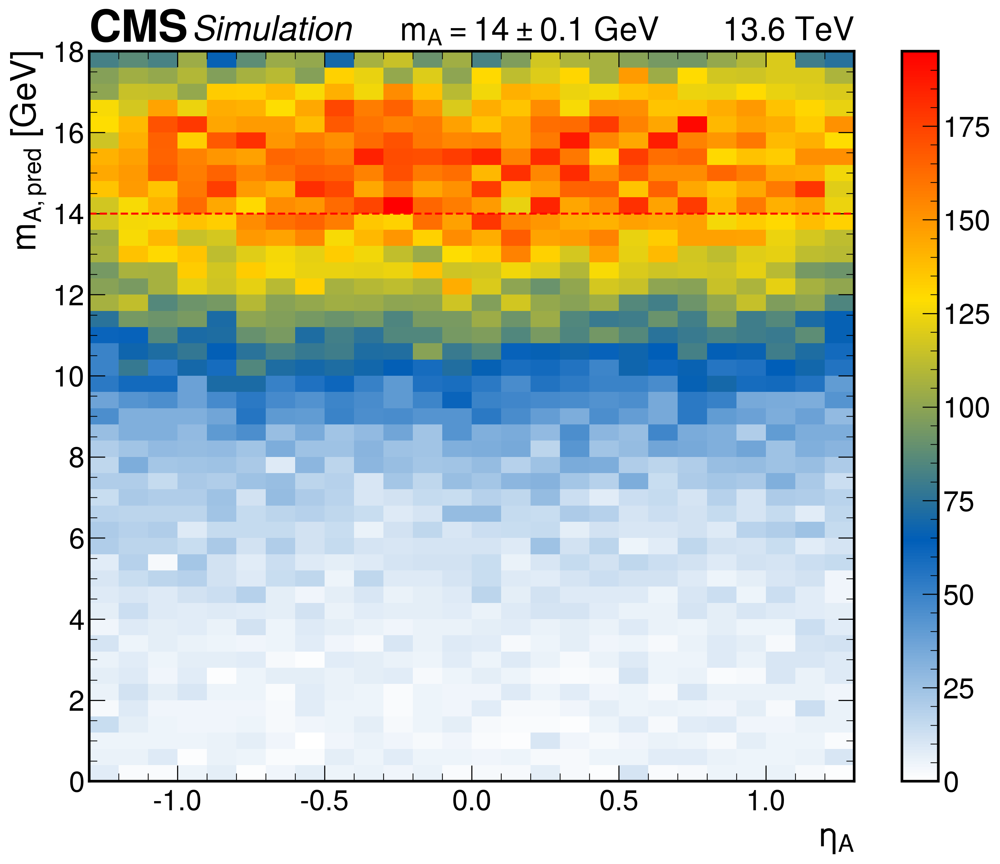

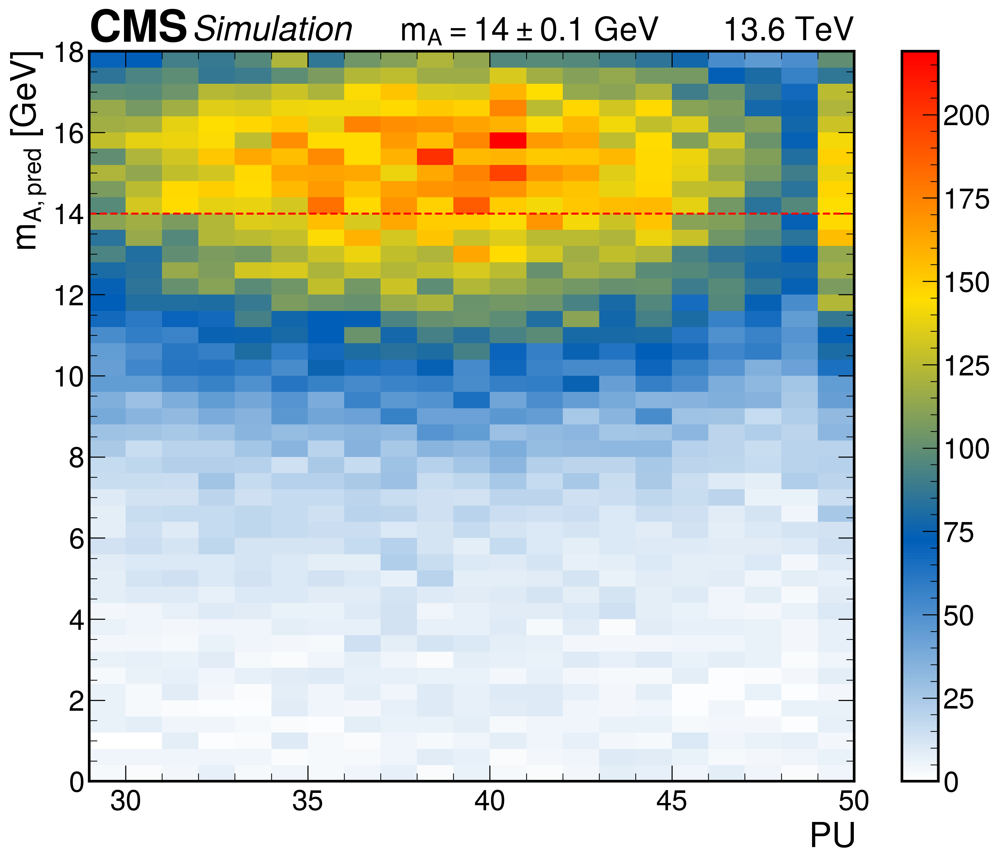

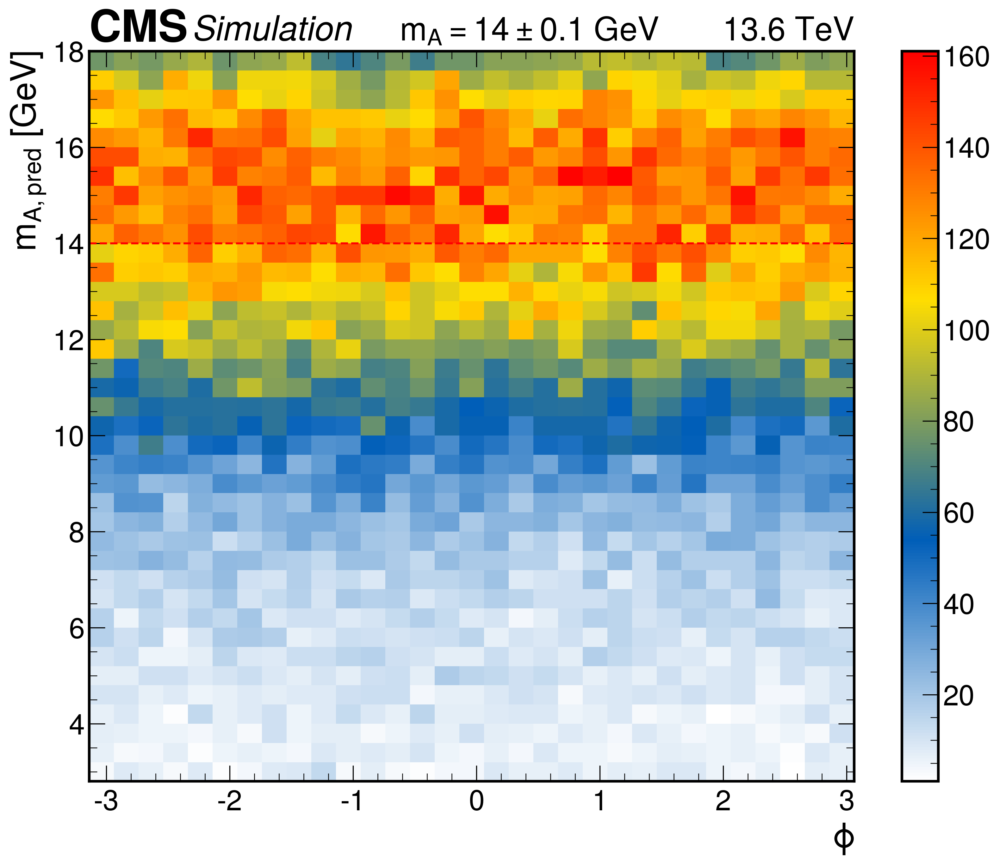

In [65]:
epoch=100
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_min_max_scaling_mN1p2To22_unbiased_map_no_relu'


model_dirs = ['13_ResNet_map_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2']

# model_dirs = model_dirs[0]

# Plot settings
m0_min, m0_max, bin_size = -1.2, 25.1, 0.4
bins = np.arange(m0_min, m0_max, bin_size)
colors = ['red', 'green', 'blue', 'orange', 'purple','grey']





Mass='14'
mass = {'3p7':3.7, '8':8, '14':14}.get(Mass, None)
# print(mass)
# Loop over models
for i, model_dir in enumerate(model_dirs):
    try:
        data_file = glob.glob(f"{data_dir}/{model_dir}/Validation_ATo2Tau_mass{Mass}_epoch_{epoch}_inference.pkl")[0]
        with open(data_file, "rb") as f:
            data = pickle.load(f)
            # print('keys', data.keys())
        m_pred = data["m_pred"].flatten()
        # m_pred = corrected_pred_mean(data["m_pred"].flatten())
        # m_pred = corrected_pred_mode(data["m_pred"].flatten())
        m_true = data["m_true"]
        jet_mass = data["jet_mass"] 
        jet_pt = data["jet_pt"].flatten()
        jet_e = data["jet_e"]
        a_pt = data["a_pt"].flatten()
        a_eta = data["a_eta"].flatten()
        a_phi = data["a_phi"].flatten()
        TaudR = data["TaudR"].flatten()
        nVtx = data["nVtx"].flatten()
        
        
        ch = model_dir.split('_')[0]
        # print(ch)
        # fig, ax = plt.subplots(figsize=(13,10),dpi=300)
        # ax.hist(nVtx, color='r', alpha=0.3, label='PU')
        
        fig, ax = plt.subplots(figsize=(13,10),dpi=300)
        norm = mcolors.TwoSlopeNorm(vmin=1000, vmax = 5000, vcenter=3000)
        # plt.hist2d(a_pt, m_pred, bins=[np.arange(30,301,5), np.arange(0,18.1, .4)], cmap='gist_heat_r')
        plt.hist2d(a_pt, m_pred, bins=[np.arange(30,301,5), np.arange(0,18.1, .4)], cmap=cms_cmap)
        # plt.hist(a_pt,bins=np.arange(30,301,5), color='r', label='Pt_true')
        plt.xlabel(r'${P_{T,A}}$ [GeV]')
        plt.ylabel(r'${m_{A, pred}}$ [GeV]')
        plt.colorbar().set_label(label='' )
        plt.axhline(mass,  color='r', linestyle='--')
        hep.cms.label(llabel=f"Simulation", rlabel=rf"$m_A = {mass} \pm 0.1$ GeV       13.6 TeV", loc=0, ax=ax)
        # plt.savefig(f'{out_dir}/m_pred_vs_a_pt_{ch}_channel_aTo2Tau_mass_{Mass}_GeV.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
        plt.show() 
        
        
        fig, ax = plt.subplots(figsize=(13,10),dpi=300)
        norm = mcolors.TwoSlopeNorm(vmin=1000, vmax = 5000, vcenter=3000)
        plt.hist2d(a_eta, m_pred, bins=[np.arange(-1.3,1.4,.1), np.arange(0,18.1, .4)], cmap=cms_cmap)
        plt.xlabel(r'${\eta_A}$')
        plt.ylabel(r'${m_{A, pred}}$ [GeV]')
        plt.colorbar().set_label(label='' )
        plt.axhline(mass,  color='r', linestyle='--')
        hep.cms.label(llabel=f"Simulation", rlabel=rf"$m_A = {mass} \pm 0.1$ GeV       13.6 TeV", loc=0, ax=ax)
        plt.savefig(f'{out_dir}/m_pred_vs_a_eta_{ch}_channel_aTo2Tau_mass_{Mass}_GeV.pdf.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
        plt.show() 
        
        fig, ax = plt.subplots(figsize=(13,10),dpi=300)
        norm = mcolors.TwoSlopeNorm(vmin=1000, vmax = 5000, vcenter=3000)
        plt.hist2d(nVtx, m_pred, bins=[np.arange(29,51,1), np.arange(0,18.1, .4)], cmap=cms_cmap)
        plt.xlabel(r'${PU}$')
        plt.ylabel(r'${m_{A, pred}}$ [GeV]')
        plt.colorbar().set_label(label='' )
        plt.axhline(mass,  color='r', linestyle='--')
        hep.cms.label(llabel=f"Simulation", rlabel=rf"$m_A = {mass} \pm 0.1$ GeV       13.6 TeV", loc=0, ax=ax)
        # plt.savefig(f'{out_dir}/m_pred_vs_PU_{ch}_channel_aTo2Tau_mass_{Mass}_GeV.pdf.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
        plt.show() 
        
        
        fig, ax = plt.subplots(figsize=(13,10),dpi=300)
        norm = mcolors.TwoSlopeNorm(vmin=1000, vmax = 5000, vcenter=3000)
        plt.hist2d(a_phi, m_pred, bins=[np.arange(-3.14,3.141,0.2), np.arange(2.8,18.1, .4)], cmap=cms_cmap)
        plt.xlabel(r'$\phi$')
        plt.ylabel(r'${m_{A, pred}}$ [GeV]')
        plt.colorbar().set_label(label='' )
        plt.axhline(mass,  color='r', linestyle='--')
        hep.cms.label(llabel=f"Simulation", rlabel=rf"$m_A = {mass} \pm 0.1$ GeV       13.6 TeV", loc=0, ax=ax)
        # plt.savefig(f'{out_dir}/m_pred_vs_a_phi_{ch}_channel_aTo2Tau_mass_{Mass}_GeV.pdf.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
        plt.show() 
        
        
        # fig, ax = plt.subplots(figsize=(13,10),dpi=300)
        # norm = mcolors.TwoSlopeNorm(vmin=1000, vmax = 5000, vcenter=3000)
        # plt.hist2d(TaudR, m_pred, bins=[np.arange(0,1.5,0.1), np.arange(2.8,18.1, .4)])
        # plt.xlabel(r'$\Delta$R')
        # plt.ylabel(r'${m_{A, pred}}$ [GeV]')
        # plt.colorbar().set_label(label='' )
        # plt.axhline(mass,  color='r', linestyle='--')
        # hep.cms.label(llabel=f"Simulation", rlabel=rf"$m_A = {mass} \pm 0.1$ GeV       13.6 TeV", loc=0, ax=ax)
        # # plt.savefig(f'{out_dir}m_pred_vs_TaudR.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
        # plt.show() 
        
        # fig, ax = plt.subplots(figsize=(13,10),dpi=300)
        # norm = mcolors.TwoSlopeNorm(vmin=1000, vmax = 5000, vcenter=3000)
        # plt.hist2d(jet_pt, m_pred, bins=[np.arange(20,201,5), np.arange(2.8,18.1, .4)])
        # plt.xlabel(r'${P_{T,jet}}$ [GeV]')
        # plt.ylabel(r'${m_{A, pred}}$ [GeV]')
        # plt.colorbar().set_label(label='' )
        # plt.axhline(mass,  color='r', linestyle='--')
        # hep.cms.label(llabel=f"Simulation", rlabel=rf"$m_A = {mass} \pm 0.1$ GeV       13.6 TeV", loc=0, ax=ax)
        # # plt.savefig(f'{out_dir}m_pred_vs_jet_pt.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
        # plt.show() 
        

    except IndexError:
        print(f"❌ No data file found for: {model_dir}")
    except Exception as e:
        print(f"⚠️ Error loading {model_dir}: {e}")

# # Final touches
# plt.xlabel(r"$m_A$ [GeV]")
# plt.ylabel("Normalized Events / 0.4 GeV")
# plt.legend(loc='upper right', fontsize=9)
# hep.cms.label(llabel="Simulation", rlabel=rf"E2E Prediction          13.6 TeV", loc=0, ax=ax)
# plt.axvline(mass,  color='green', linestyle='--', label='m_true',  )
# plt.tight_layout()
# # plt.savefig(f'{out_dir}/mass_reg_channel_test_validation_data_prediction.pdf',facecolor='w',dpi=300)
# plt.show()


### comparing map and non map model

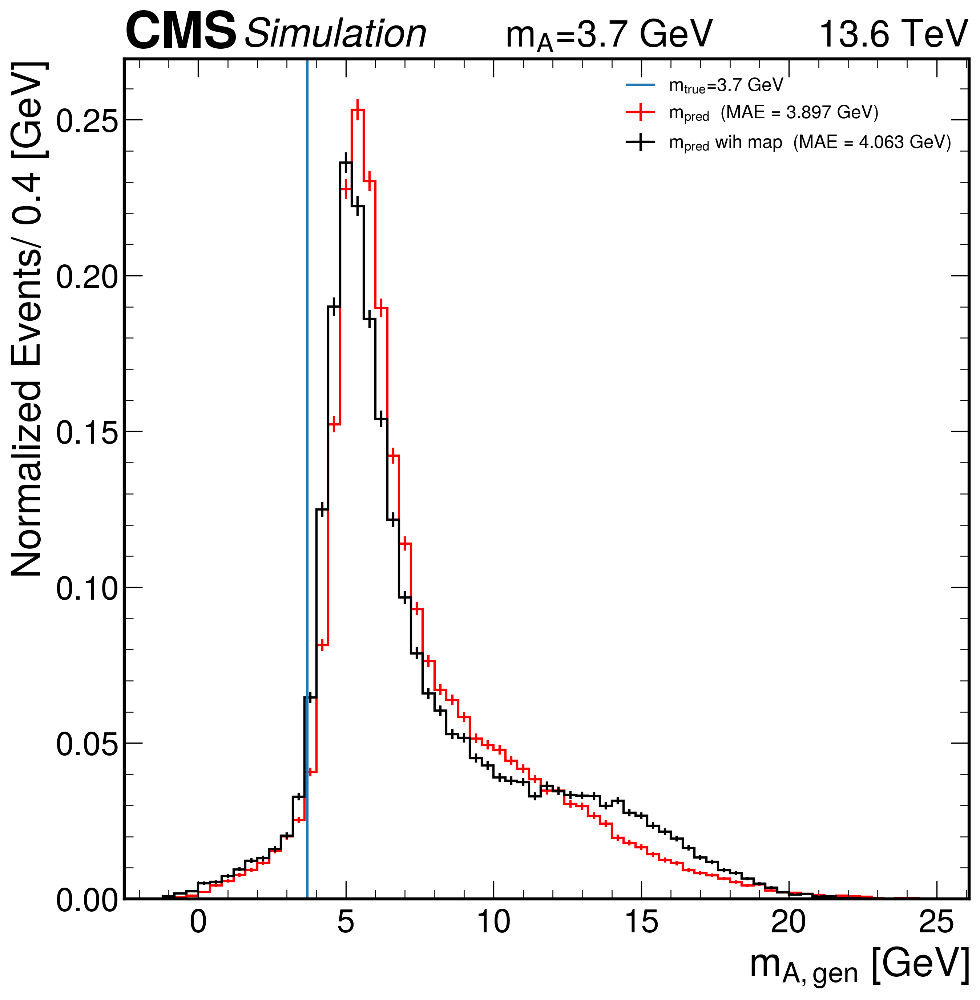

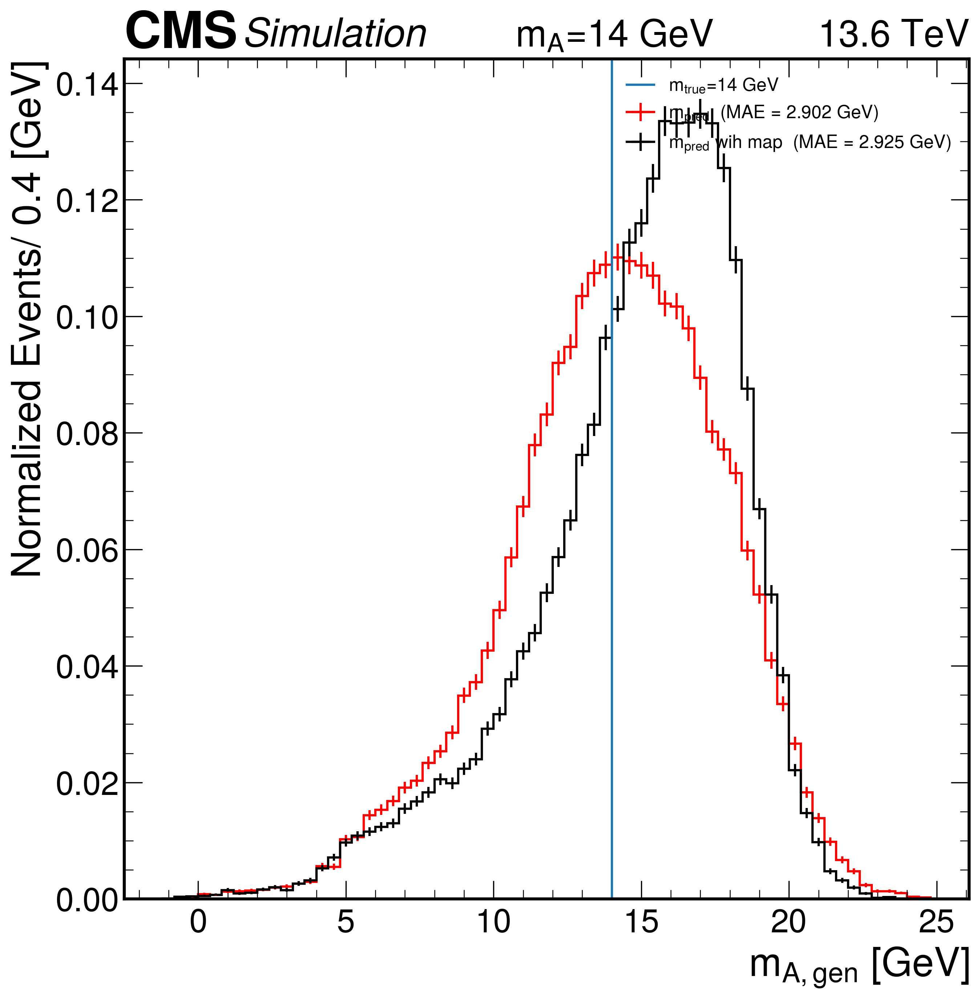

In [52]:
epoch=100
Mass = ['3p7','14']
for Mass in Mass:
    mass_true = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_min_max_scaling_mN1p2To22_chanel_test_UA'
    model_dir = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
    data_file = glob.glob(f"{data_dir}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile = open(f"{data_file}", "rb")
    data = pickle.load(infile)
    infile.close()
    m_true = data["m_true"]
    m_pred = data["m_pred"]

    data_dir_m ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_min_max_scaling_mN1p2To22_unbiased_map'
    model_dir_m = '13_ResNet_map_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
    data_file_m = glob.glob(f"{data_dir_m}/{model_dir_m}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_m = open(f"{data_file_m}", "rb")
    data_m = pickle.load(infile_m)
    infile_m.close()
    m_true_m = data_m["m_true"]
    m_pred_m = data_m["m_pred"]


    # data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_min_max_scaling_mN1p2To22_unbiased_map_no_relu'
    # model_dir = '13_ResNet_map_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
    # data_file = glob.glob(f"{data_dir}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    # infile = open(f"{data_file}", "rb")
    # data = pickle.load(infile)
    # infile.close()
    # m_true = data["m_true"]
    # m_pred = data["m_pred"]



    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots(dpi=300)
    plt.axvline(mass_true, label=r"$m_{true}$" + f"={mass_true} GeV")
    h1=np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h1, histtype='step', yerr=True, label=r'$m_{pred}$  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred)), color='red', density = True)
    h2=np.histogram(m_pred_m, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{pred}$ wih map  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true_m - m_pred_m)), color='black', density=True)
    plt.xlabel(r'$m_{A, gen}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='upper right', fontsize=12)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={mass_true} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_{model_dir}_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

### corrected using mean

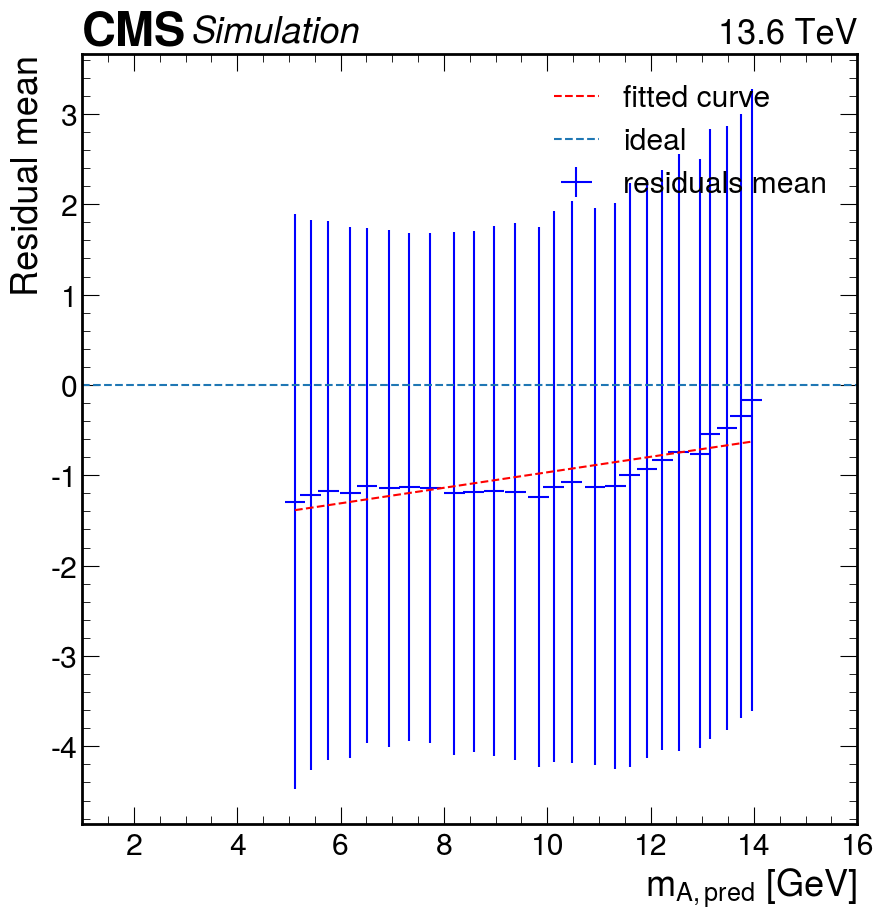

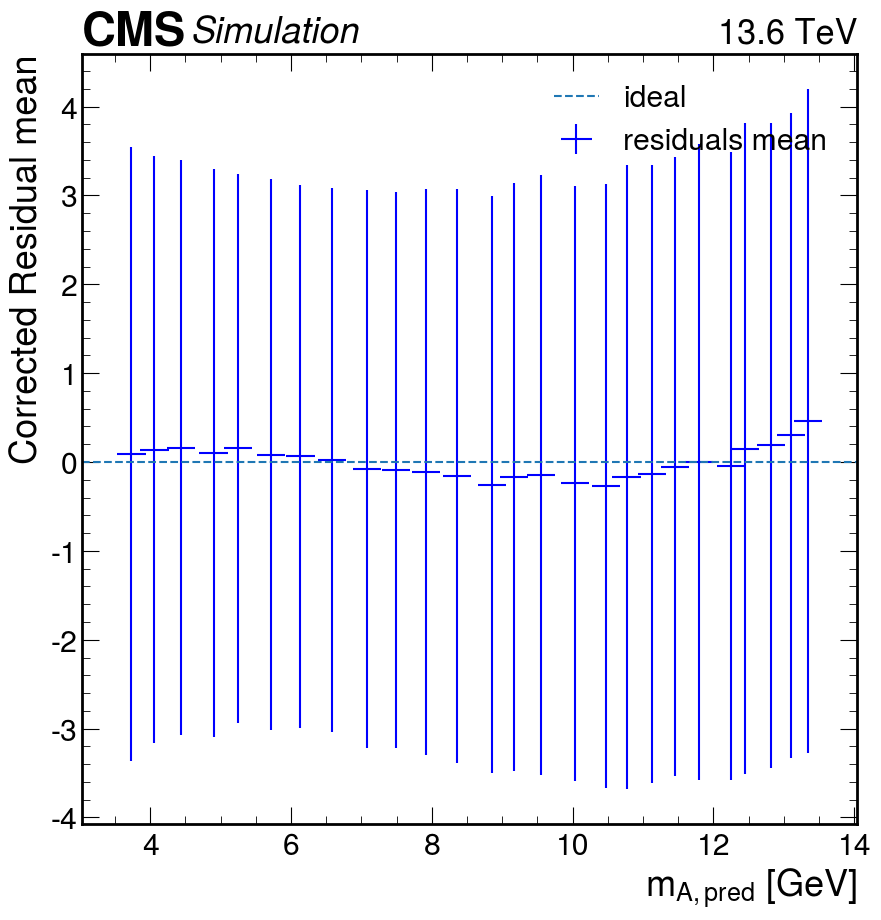

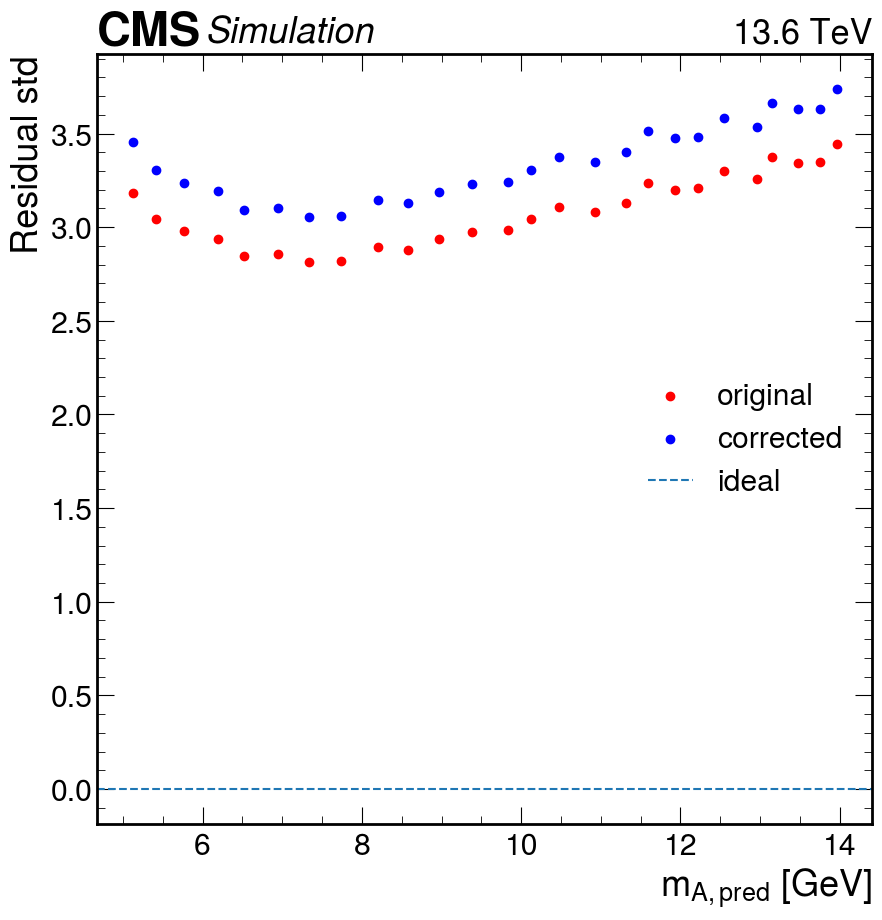

In [53]:
epoch=100

data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
ua_dir_mapA = 'ResNet_mapA_1_mN1p2To22_unbaised'
model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'





# ua_dir_mapA = 'ResNet_mapA_1_mN1p2To22_unbaised'
# model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

file_in = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/INFERENCE_DATA/epoch{epoch}_*.pkl")[0]


degree = 1
def corrected_pred_mean(m):
        mass = m + polynomial_mean(m)
        return mass

infile = open(f"{file_in}", "rb")
data = pickle.load(infile)
infile.close()

m_true=data["m_true"].flatten()
m_pred=data["m_pred"].flatten()
mask = (m_true >= 0) & (m_true <= 18.0)
# m_pred = m_pred[mask]
# m_true = m_true[mask]
# mask2 = (m_pred >= 3.6) & (m_pred <= 14.0)
# m_pred = m_pred[mask2]
# m_true = m_true[mask2]


bins=np.arange(3.6,14.1,0.4)
mean_pred_bins = []
mean_true_bins =[]
residuals_mean = []
residuals_std = []
for i in range(len(bins)-1):
    temp_mass_pred = m_pred[(m_true >= bins[i]) & (m_true< bins[i+1])]
    temp_mean_mass_pred = np.mean(temp_mass_pred)
    mean_pred_bins.append(temp_mean_mass_pred)
    temp_mass_true = m_true[(m_true >= bins[i]) & (m_true< bins[i+1])]
    mean_true_bins.append(np.mean(temp_mass_true))
    temp_residual = temp_mass_true - temp_mass_pred
    mu, std = norm.fit(temp_residual)
    residuals_mean.append(mu)
    residuals_std.append(std)



coeff_mean = np.polyfit(mean_pred_bins, residuals_mean, degree)
polynomial_mean = np.poly1d(coeff_mean)
x = np.linspace(min(mean_pred_bins),max(mean_pred_bins), num=1000)
y_fit_mean = polynomial_mean(x)    

# print("---------------------- Original plot ---------------------------------")
fig, ax = plt.subplots()   
plt.errorbar(mean_pred_bins, residuals_mean, xerr=(bins[1] - bins[0]) / 2, yerr=residuals_std, fmt='none', color='b', label='residuals mean')
plt.plot(x,y_fit_mean, color='r',linestyle='--', label = f"fitted curve" )
plt.xlim(1,16)
plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Residual mean")
plt.legend()
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}/residual_mean_from_original_prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show() 






# print("---------------------- frist correction plot ---------------------------------")


m_pred_c = corrected_pred_mean(m_pred).flatten()

mean_pred_bins_c = []
mean_true_bins_c =[]
residuals_mean_c = []
residuals_std_c = []
for i in range(len(bins)-1):
    temp_mass_pred_c = m_pred_c[(m_true >= bins[i]) & (m_true< bins[i+1])]
    temp_mean_mass_pred_c = np.mean(temp_mass_pred_c)
    mean_pred_bins_c.append(temp_mean_mass_pred_c)
    temp_mass_true_c = m_true[(m_true >= bins[i]) & (m_true< bins[i+1])]
    mean_true_bins_c.append(np.mean(temp_mass_true_c))
    temp_residual_c = temp_mass_true_c - temp_mass_pred_c
    mu_c, std_c = norm.fit(temp_residual_c)
    residuals_mean_c.append(mu_c)
    residuals_std_c.append(std_c)

coeff_mean1 = np.polyfit(mean_pred_bins_c, residuals_mean_c, 1)
polynomial_mean1 = np.poly1d(coeff_mean1)
y_fit_mean1 = polynomial_mean1(x)

fig, ax = plt.subplots() 
# plt.scatter(mean_pred_bins, residuals_mean,color='b',marker='o',label='residuals mean')
plt.errorbar(mean_pred_bins_c, residuals_mean_c, xerr=(bins[1] - bins[0]) / 2, yerr=residuals_std_c, fmt='none', color='b', label='residuals mean')
# plt.ylim(-4,4)
plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Corrected Residual mean")
plt.legend()
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}/residual_mean_from_corrected_prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show() 


# coeff_std1 = np.polyfit(mean_pred_bins, residuals_std, 1)
# polynomial_std1 = np.poly1d(coeff_std1)
# y_fit_std1 = polynomial_std1(x)
fig, ax = plt.subplots()
plt.scatter(mean_pred_bins,residuals_std,color='r',marker='o',label='original')
plt.scatter(mean_pred_bins,residuals_std_c,color='b',marker='o',label='corrected')
plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Residual std")
plt.legend()
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}/std_from_original_corredted_residuals_prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show() 




### fitting using mean with prediction at signal sample prediction

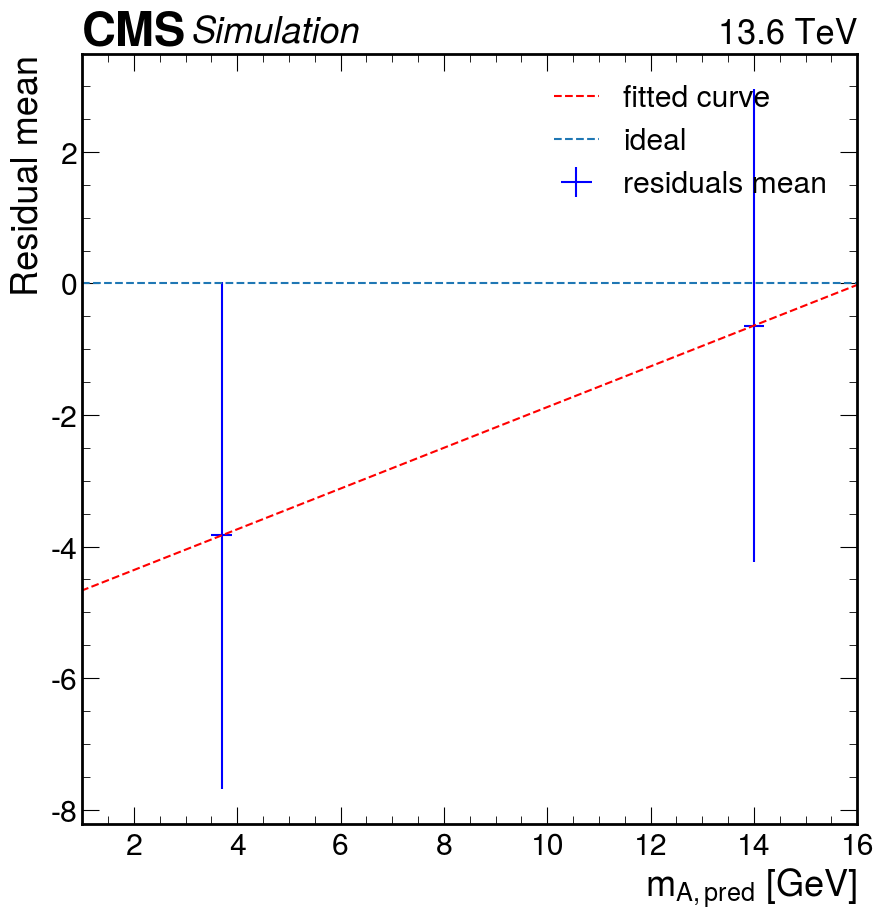

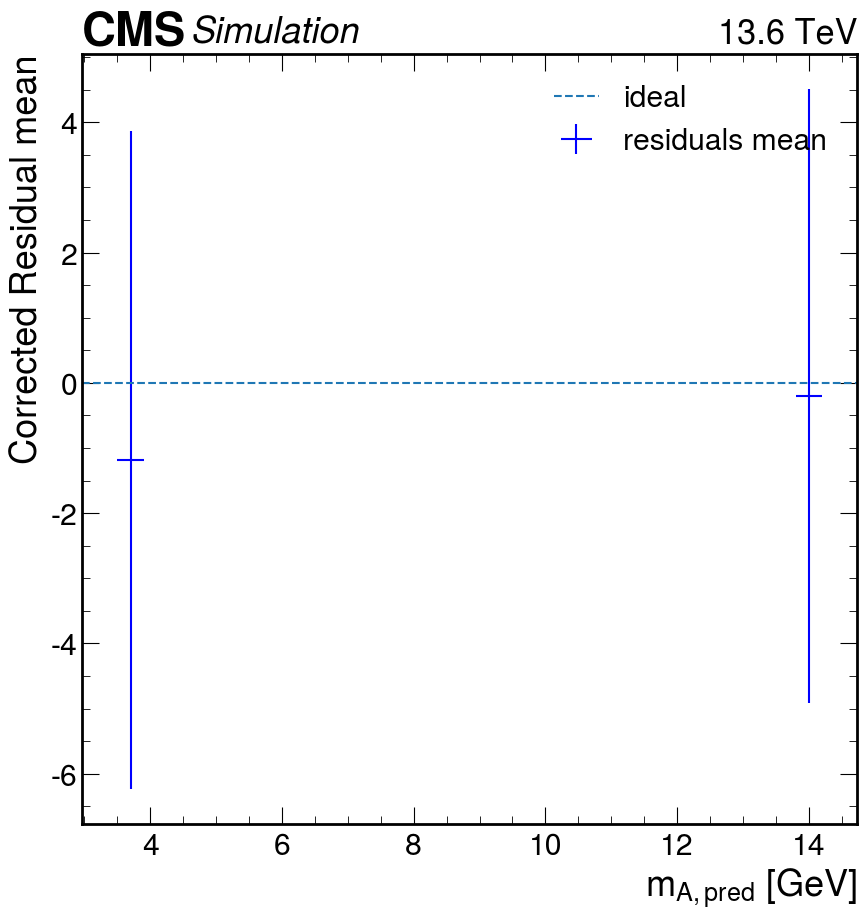

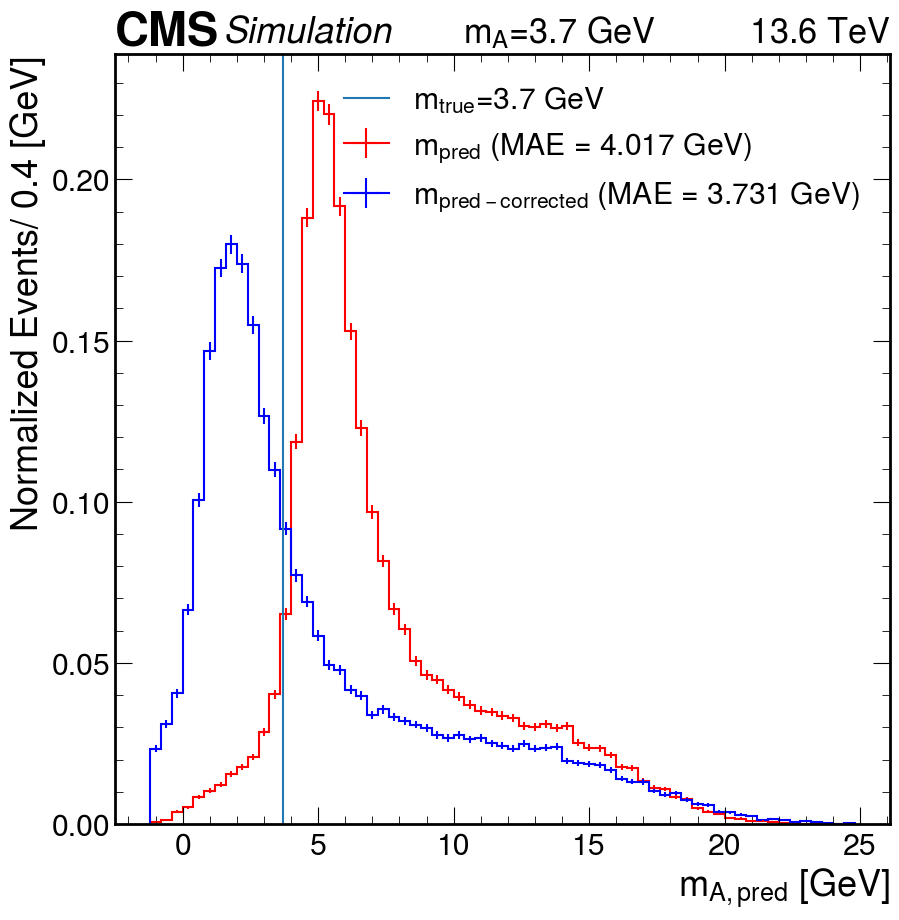

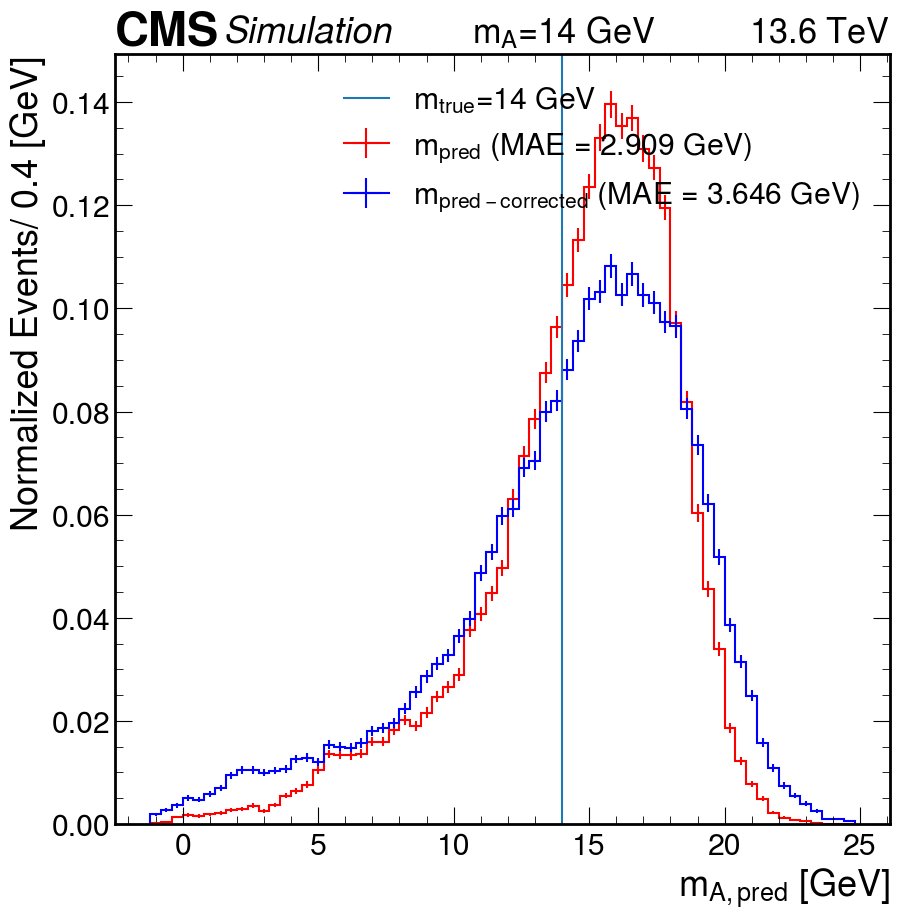

In [54]:


epoch=100
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
# ua_dir_mapA = 'ResNet_mapA_1_mN1p2To22_unbaised'
ua_dir_mapA = 'ResNet_min_max_scaling_mN1p2To22_unbiased'
# model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
model_dir_map = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

def corrected_pred_mean(m):
        mass = m + polynomial_mean(m)
        return mass
    
def get_mode(data, bins=len(np.arange(-1.2,22.1,0.4))):
    counts, bin_edges = np.histogram(data, bins=bins)

    # Find the index of the mode bin
    mode_bin_index = np.argmax(counts)

    # Get the mode bin range
    mode_bin_start = bin_edges[mode_bin_index]
    mode_bin_end = bin_edges[mode_bin_index + 1]
    
    return (mode_bin_end + mode_bin_start)/2


mass_, mean_, mean_std,  mode_, mode_std = [], [], [], [], []
for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    mass_.append(m_true_mass)
    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    data_map.keys()
    infile_map.close()
    m_pred_map = data_map["m_pred"]
    m_true_map = data_map["m_true"]
    temp_residual = m_true_map - m_pred_map
    mean_.append(np.mean(temp_residual))
    mean_std.append(np.std(temp_residual))
    mode_.append(get_mode(temp_residual))
    mode_std.append(np.std(temp_residual))

    
    
coeff_mean = np.polyfit(mass_, mean_, 1)
polynomial_mean = np.poly1d(coeff_mean)
x = np.linspace(-1.2,22, num=1000)
y_fit_mean = polynomial_mean(x)    


#---------------------------original best fit plot--------------------------------------------------------------------------------
fig, ax = plt.subplots()   
plt.errorbar(mass_, mean_, xerr=(bins[1] - bins[0]) / 2, yerr=mean_std, fmt='none', color='b', label='residuals mean')
plt.plot(x,y_fit_mean, color='r',linestyle='--', label = f"fitted curve" )
plt.xlim(1,16)
plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Residual mean")
plt.legend()
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}/residual_mean_from_original_prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show() 
#------------------------------



mass_c, mean_c, mean_std_c= [], [], []
for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    mass_c.append(m_true_mass)
    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    infile_map.close()
    m_pred_map_c =  corrected_pred_mean(data_map["m_pred"].flatten())
    m_true_map_c = data_map["m_true"].flatten()
    temp_residual_c = m_true_map_c - m_pred_map_c
    mean_c.append(np.mean(temp_residual_c))
    mean_std_c.append(np.std(temp_residual_c))
fig, ax = plt.subplots() 
plt.errorbar(mass_c, mean_c, xerr=(bins[1] - bins[0]) / 2, yerr=mean_std_c, fmt='none', color='b', label='residuals mean')
plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Corrected Residual mean")
plt.legend()
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}/residual_mean_from_corrected_prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show() 




for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    mass_c.append(m_true_mass)
    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    infile_map.close()
    m_pred_map =  data_map["m_pred"].flatten()
    m_pred_map_c = corrected_pred_mean(m_pred_map)
    m_true_map = data_map["m_true"].flatten()
    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots()
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    
    h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{pred}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color='red', density=True)
    
    h3=np.histogram(m_pred_map_c, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h3, histtype='step', yerr=True, label=r'$m_{pred-corrected}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map -m_pred_map_c)), linestyle='-', color='blue', density=True)
   
    plt.xlabel(r'$m_{A, pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='best')
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_comparion_with_map_true_and_corrected_predictions_with_mean_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

### fitting using pridicted mode at from signal samples

[-0.04922334 -1.25575772]


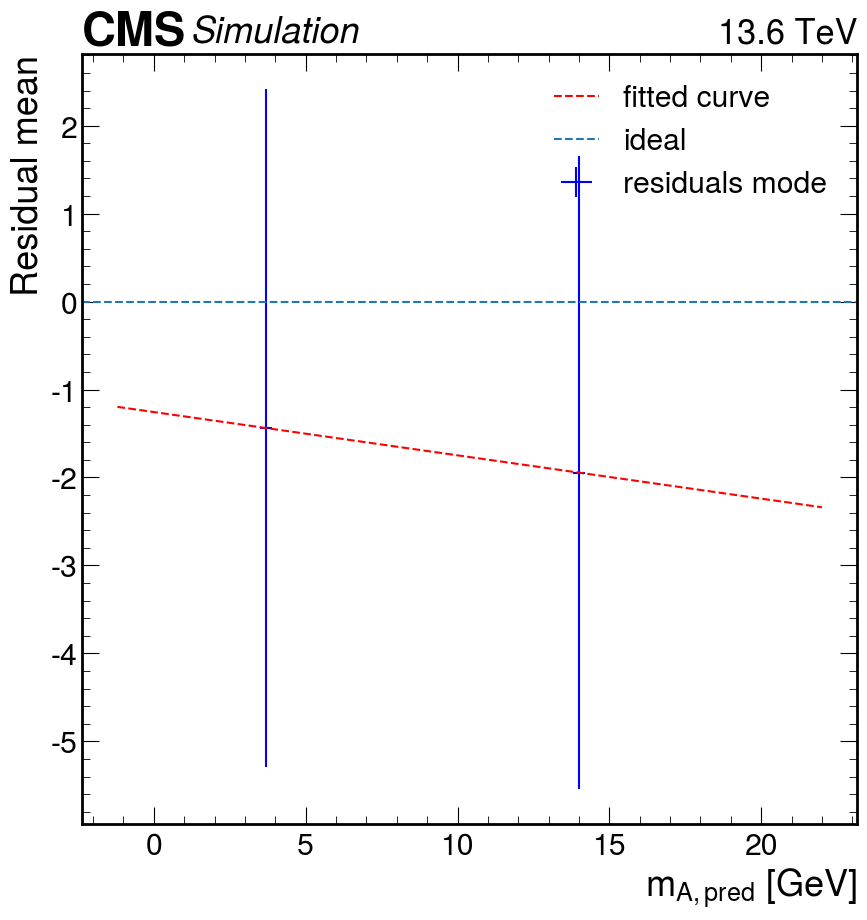

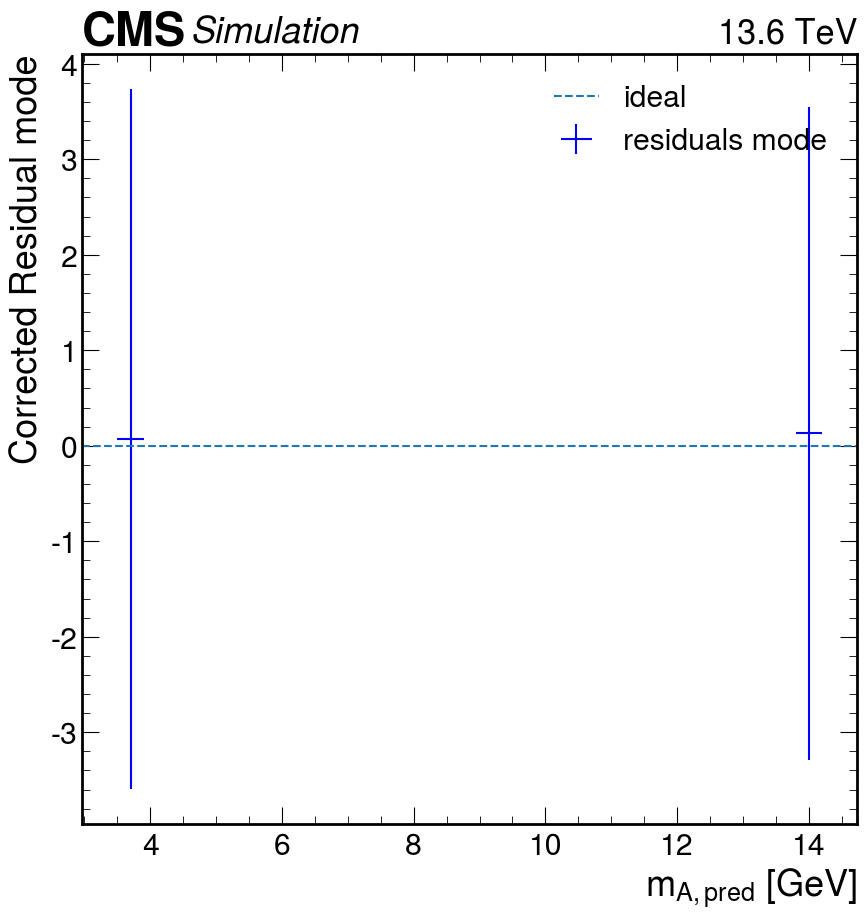

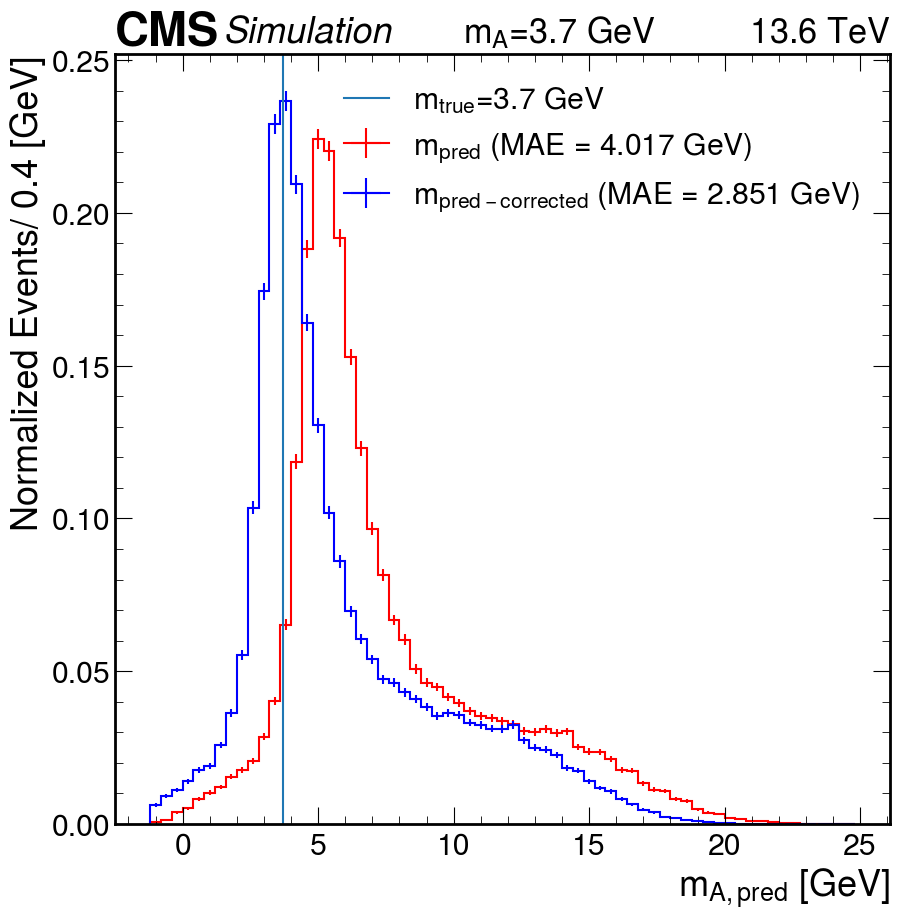

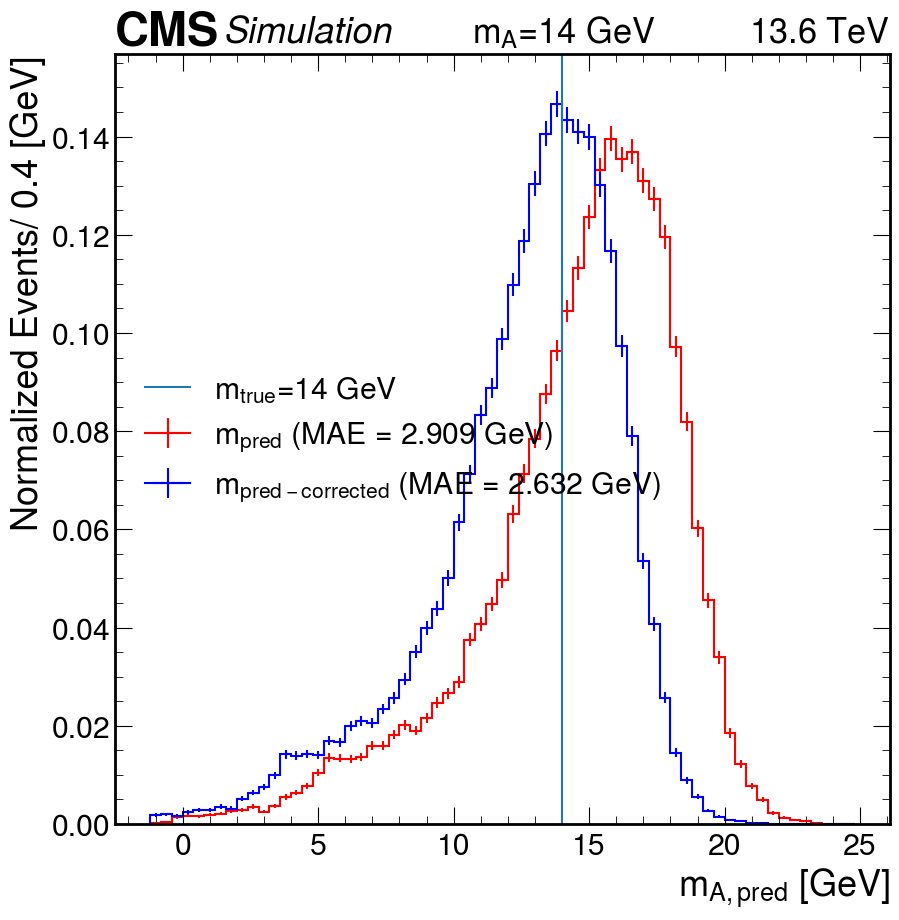

In [55]:


epoch=100
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
# ua_dir_mapA = 'ResNet_mapA_1_mN1p2To22_unbaised'
ua_dir_mapA = 'ResNet_min_max_scaling_mN1p2To22_unbiased'
# model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
model_dir_map = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

def corrected_pred_mode(m):
        mass = m + polynomial_mode(m)
        # mass = m +a*m +b
        return mass
    
def get_mode(data, bins=len(np.arange(-22.2,22.1,0.01))):
    counts, bin_edges = np.histogram(data, bins=bins)

    # Find the index of the mode bin
    mode_bin_index = np.argmax(counts)

    # Get the mode bin range
    mode_bin_start = bin_edges[mode_bin_index]
    mode_bin_end = bin_edges[mode_bin_index + 1]
    
    return (mode_bin_end + mode_bin_start)/2


mass_, mode_, mode_std = [], [], []
for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    mass_.append(m_true_mass)
    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    data_map.keys()
    infile_map.close()
    m_pred_map = data_map["m_pred"]
    m_true_map = data_map["m_true"]
    temp_residual = m_true_map - m_pred_map
    
    mode_.append(get_mode(temp_residual))
    mode_std.append(np.std(temp_residual))

    

coeff_mode = np.polyfit(mass_, mode_, 1)
print(coeff_mode)
polynomial_mode = np.poly1d(coeff_mode)
x = np.linspace(-1.2,22, num=1000)
y_fit_mode = polynomial_mode(x)    


#---------------------------original best fit plot--------------------------------------------------------------------------------
fig, ax = plt.subplots()   
plt.errorbar(mass_, mode_, xerr=(bins[1] - bins[0]) / 2, yerr=mode_std, fmt='none', color='b', label='residuals mode')
plt.plot(x,y_fit_mode, color='r',linestyle='--', label = f"fitted curve" )

plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Residual mean")
plt.legend()
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}/residual_mean_from_original_prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show() 
#------------------------------



mass_c, mean_c, mean_std_c= [], [], []
for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    mass_c.append(m_true_mass)
    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    infile_map.close()
    m_pred_map_c =  corrected_pred_mode(data_map["m_pred"].flatten())
    m_true_map_c = data_map["m_true"].flatten()
    temp_residual_c = m_true_map_c - m_pred_map_c
    mean_c.append(get_mode(temp_residual_c))
    mean_std_c.append(np.std(temp_residual_c))
fig, ax = plt.subplots() 
plt.errorbar(mass_c, mean_c, xerr=(bins[1] - bins[0]) / 2, yerr=mean_std_c, fmt='none', color='b', label='residuals mode')
plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Corrected Residual mode")
plt.legend()
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}/residual_mean_from_corrected_prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show() 




for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

    mass_c.append(m_true_mass)
    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    infile_map.close()
    m_pred_map =  data_map["m_pred"].flatten()
    m_pred_map_c = corrected_pred_mode(m_pred_map)
    m_true_map = data_map["m_true"].flatten()
    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots()
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    
    h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{pred}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color='red', density=True)
    
    h3=np.histogram(m_pred_map_c, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h3, histtype='step', yerr=True, label=r'$m_{pred-corrected}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map -m_pred_map_c)), linestyle='-', color='blue', density=True)
   
    plt.xlabel(r'$m_{A, pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='best')
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_comparion_with_map_true_and_corrected_predictions_with_mean_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

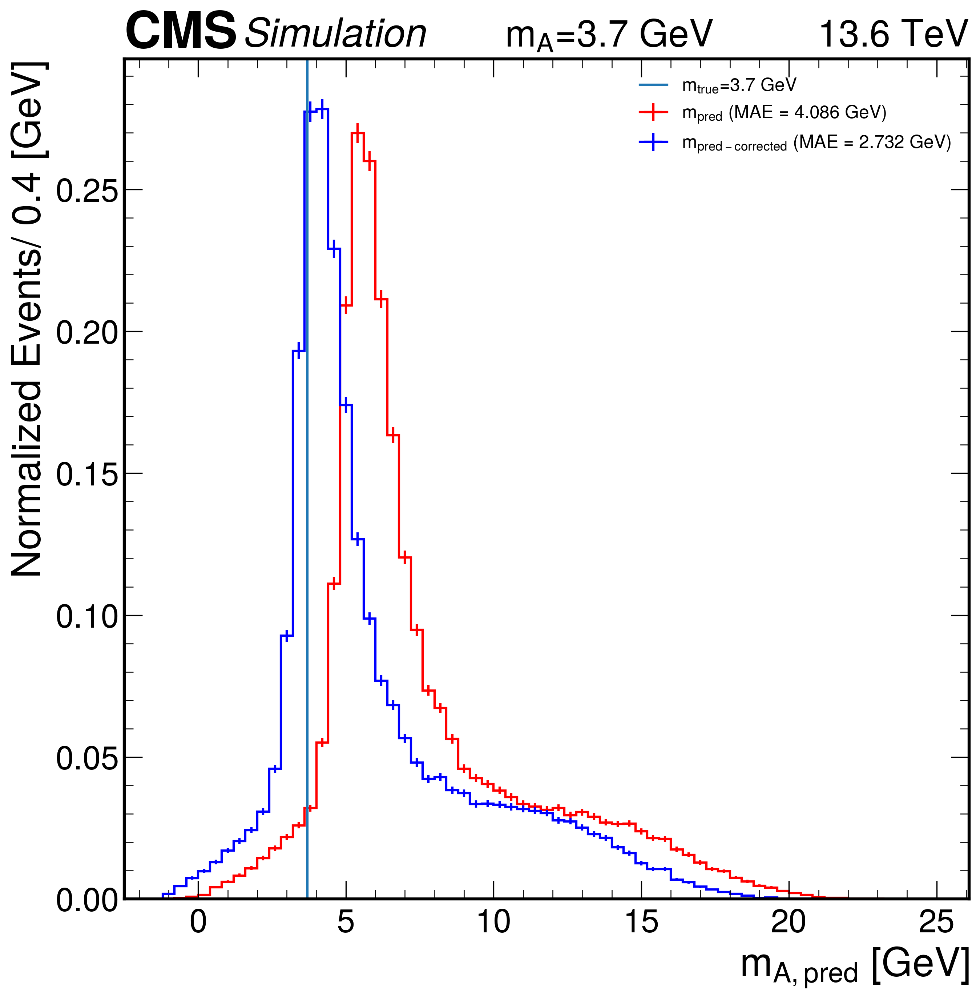

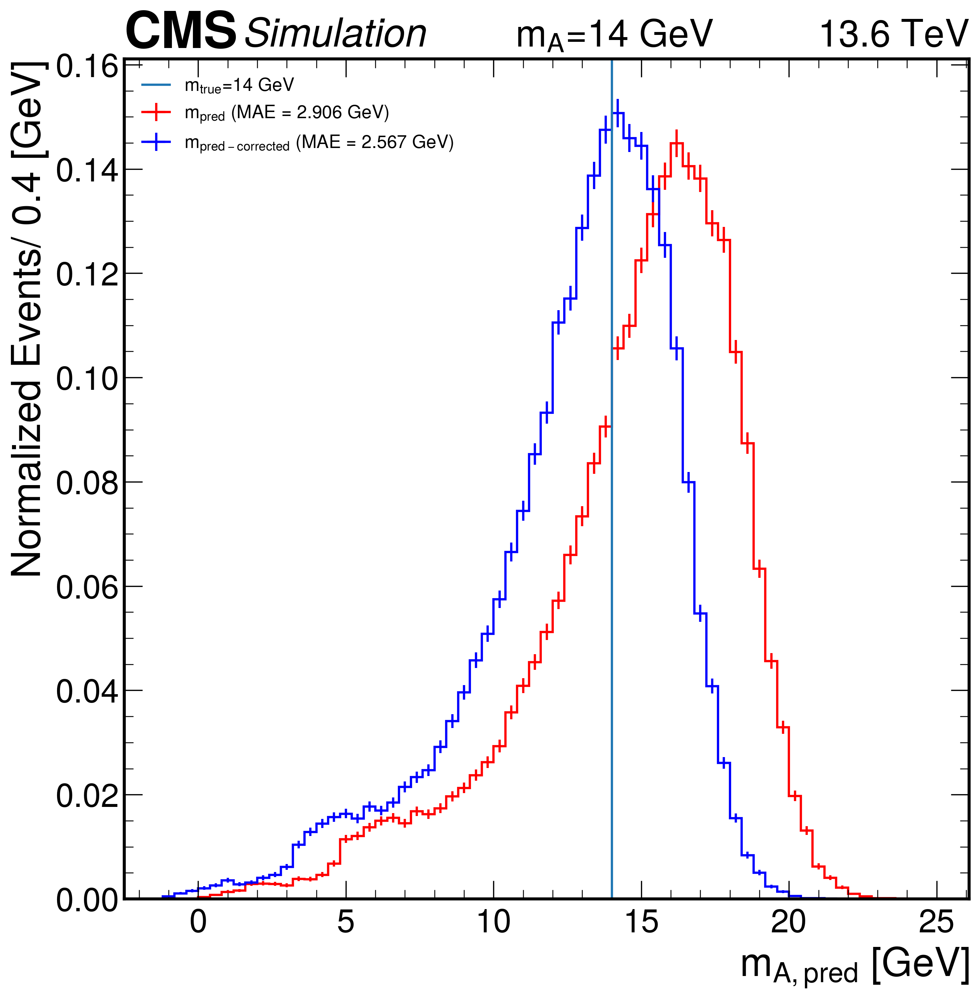

In [57]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
epoch=100
# ua_dir = 'ResNet_min_max_scaling_mN1p2To22_unbiased'
# ua_dir_no_relu = 'ResNet_min_max_scaling_mN1p2To22_unbiased_no_relu'
# model_dir = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

ua_dir_mapA = 'ResNet_mapA_1_mN1p2To22_unbaised'
# ua_dir_mapA0p5 = 'ResNet_mapA_0p5_mN1p2To22_unbaised'
model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
model_dir_map_11 = '11_ResNet_mapA_Tracks_pt_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'


for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)


    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    data_map.keys()
    infile_map.close()
    m_pred_map = data_map["m_pred"]
    m_true_map = data_map["m_true"]

 
    m_pred_map_correct = corrected_pred_mode(m_pred_map)
    # m_pred_map_correct = m_pred_map-1.9
    
    
    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots(dpi=300)
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    
    h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{pred}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color='red', density=True)
    
    h3=np.histogram(m_pred_map_correct, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h3, histtype='step', yerr=True, label=r'$m_{pred-corrected}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map -m_pred_map_correct)), linestyle='-', color='blue', density=True)
   
    plt.xlabel(r'$m_{A, pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='best', fontsize=12)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_comparion_with_map_true_and_corrected_predictions_with_mean_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

### Correction using mode

In [10]:
epoch=100
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'


ua_dir_mapA = 'ResNet_mapA_1_mN1p2To22_unbaised'
model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

data_file = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/INFERENCE_DATA/epoch{epoch}_*.pkl")[0]

# print(f"loaded data file ------>  {data_file}")
infile = open(f"{data_file}", "rb")
data = pickle.load(infile)
print("keys", data.keys())
# print(f"data.keys()------>  {data.keys()}")
infile.close()

m_true = data["m_true"]
m_pred = data["m_pred"]
# m0 = data["m0"]

mask1 = (m_true >= 3.6) & (m_true <=14)
m_true_ = m_true[mask1]
m_pred_ = m_pred[mask1]
# m0_ = m0[mask1]
mask2 = (m_pred_ >=3.6) & (m_pred_ <=14)
m_true__ = m_true_[mask2]
m_pred__ = m_pred_[mask2]
# m0__ = m0_[mask2]

keys dict_keys(['m_true', 'm_pred', 'mae', 'mre'])


Converged after 1100 bootstraps.
Converged after 1100 bootstraps.
Converged after 1100 bootstraps.
Converged after 3100 bootstraps.
Converged after 2100 bootstraps.
Converged after 3100 bootstraps.
Converged after 3100 bootstraps.
Converged after 1100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 3100 bootstraps.
Converged after 2100 bootstraps.
Converged after 2100 bootstraps.
Converged after 2100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 3100 bootstraps.
Converged after 2100 bootstraps.
Converged after 3100 bootstraps.
Converged 

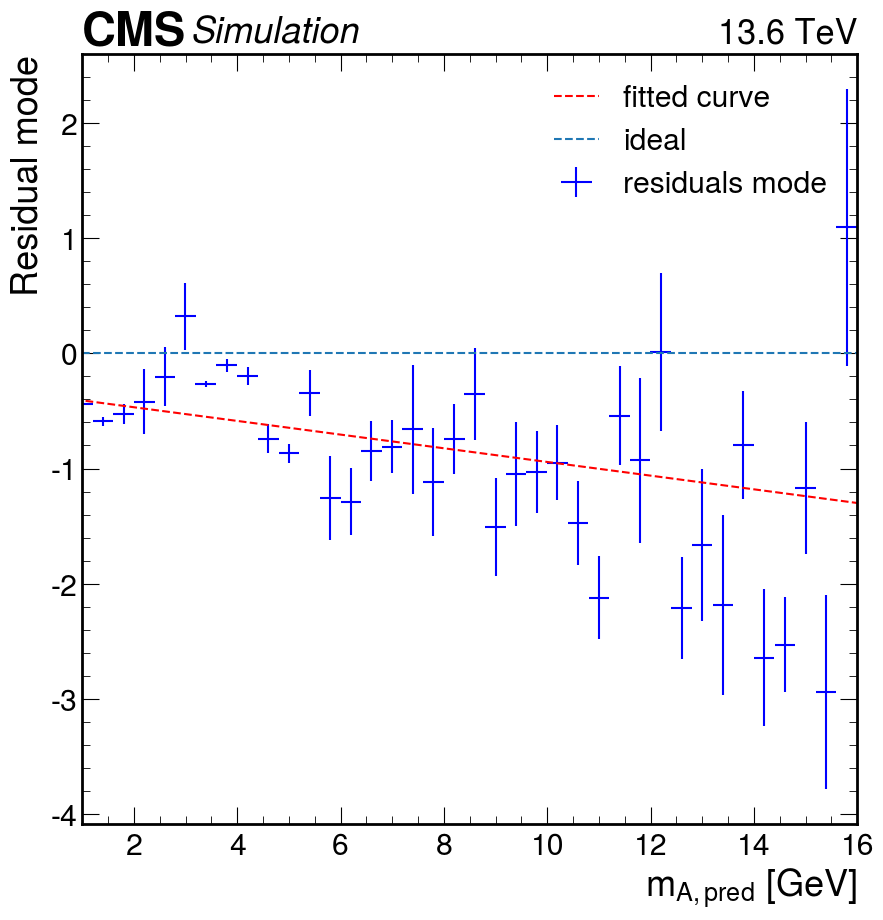

Converged after 1100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 5100 bootstraps.
Converged after 1100 bootstraps.
Converged after 3100 bootstraps.
Converged after 3100 bootstraps.
Converged after 2100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 3100 bootstraps.
Converged after 3100 bootstraps.
Converged after 3100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 1100 bootstraps.
Converged after 2100 bootstraps.
Converged after 3100 bootstraps.
Converged after 3100 bootstraps.
Converged after 3100 bootstraps.
Converged after 1100 bootstraps.
Converged 

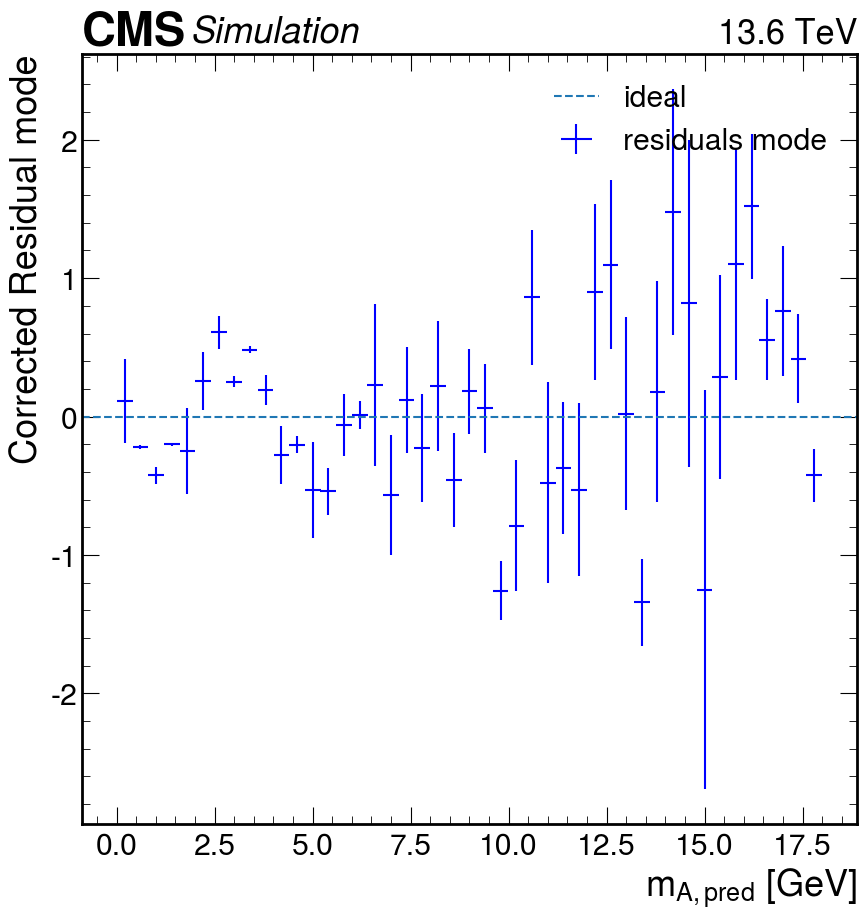

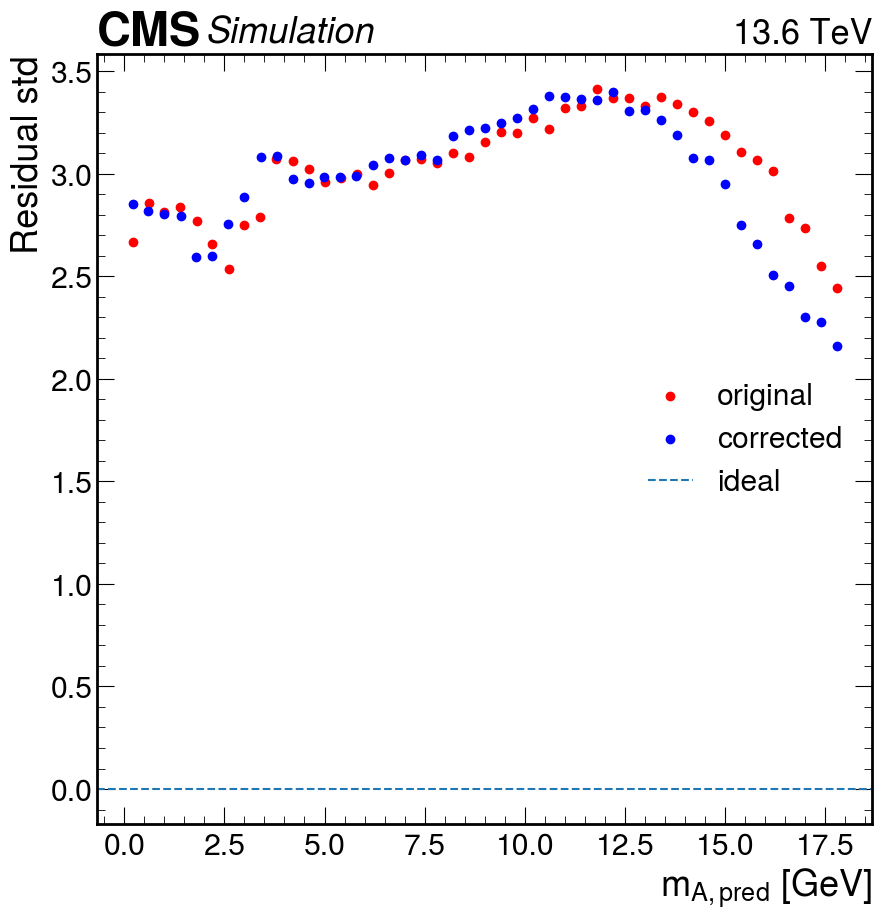

In [27]:
epoch=100
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'


ua_dir_mapA = 'ResNet_mapA_1_mN1p2To22_unbaised'
model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

file_in = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/INFERENCE_DATA/epoch{epoch}_*.pkl")[0]




def get_hist_mode(data, bins=len(np.arange(3.6,14.01,0.05))):
    counts, bin_edges = np.histogram(data, bins=bins)

    # Find the index of the mode bin
    mode_bin_index = np.argmax(counts)

    # Get the mode bin range
    mode_bin_start = bin_edges[mode_bin_index]
    mode_bin_end = bin_edges[mode_bin_index + 1]
    
    return (mode_bin_end + mode_bin_start)/2

def compute_uncertainty(data, n_bootstraps=10):
    mode_bins = []

    for _ in range(n_bootstraps):
        bootstrap_sample = np.random.choice(data, size=len(data), replace=True)
        counts, bin_edges = np.histogram(bootstrap_sample, bins=30)
        mode_bin_index = np.argmax(counts)
        mode_bin_start = bin_edges[mode_bin_index]
        mode_bin_end = bin_edges[mode_bin_index + 1]
        mode_bins.append((mode_bin_start + mode_bin_end) / 2)

    return np.std(mode_bins)

def find_convergence(data, initial_bootstraps=100, max_bootstraps=10000, step=1000, threshold=0.01):
    n_bootstraps = initial_bootstraps
    prev_uncertainty = compute_uncertainty(data, n_bootstraps)
    uncertainties = [(n_bootstraps, prev_uncertainty)]
    
    while n_bootstraps <= max_bootstraps:
        n_bootstraps += step
        current_uncertainty = compute_uncertainty(data, n_bootstraps)
        uncertainties.append((n_bootstraps, current_uncertainty))
        
        # Check for convergence
        if abs(current_uncertainty - prev_uncertainty) < threshold:
            print(f"Converged after {n_bootstraps} bootstraps.")
            break
            
        prev_uncertainty = current_uncertainty
    
    return prev_uncertainty, n_bootstraps






######
# data_dir = '../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_min_max_scaling_mN1p2To22_chanel_test_UA'
# model_dir = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
# file_in = glob.glob(f"{data_dir}/{model_dir}/INFERENCE_DATA/epoch100_*.pkl")[0]
#######
infile = open(f"{file_in}", "rb")
data = pickle.load(infile)
infile.close()

m0_min = 1.2
m0_max = 18.2


m_true_=data["m_true"]
m_pred_=data["m_pred"]
m_true = np.concatenate(m_true_).flatten()
m_pred = np.concatenate(m_pred_).flatten()
mask = (m_true >= 0) & (m_true <= 18.0)
m_pred = m_pred[mask]
m_true = m_true[mask]
# mask2 = (m_pred >= 3.6) & (m_pred <= 14.0)
# m_pred = m_pred[mask2]
# m_true = m_true[mask2]


# Initial calculations
bins = np.arange(0, 18.1, 0.4)
mean_pred_bins = []
mean_true_bins = []
residuals_mean = []
residuals_std = []
residuals_mode = []
mode_errors = []
for i in range(len(bins) - 1):
    temp_mass_pred = m_pred[(m_pred >= bins[i]) & (m_pred < bins[i + 1])]
    temp_mean_mass_pred = np.mean(temp_mass_pred)
    mean_pred_bins.append(temp_mean_mass_pred)
    temp_mass_true = m_true[(m_pred >= bins[i]) & (m_pred < bins[i + 1])]
    mean_true_bins.append(np.mean(temp_mass_true))
    temp_residual = temp_mass_true - temp_mass_pred
    mu, std = temp_residual.mean(), temp_residual.std()
    residuals_mean.append(mu)
    residuals_std.append(std)
    residuals_mode.append(get_hist_mode(temp_residual))
    uncertainty, n_bootstraps = find_convergence(temp_residual)
    mode_errors.append(uncertainty)

# Polynomial fit
coeff_mode = np.polyfit(mean_pred_bins, residuals_mode, 1)
polynomial_mode = np.poly1d(coeff_mode)
x = np.linspace(min(mean_pred_bins), max(mean_pred_bins), num=1000)
y_fit_mean = polynomial_mode(x)

# First plot with error bars
fig, ax = plt.subplots()
plt.errorbar(mean_pred_bins, residuals_mode, xerr=(bins[1] - bins[0]) / 2, yerr=mode_errors, fmt='none', color='b', label='residuals mode')
plt.plot(x, y_fit_mean, color='r', linestyle='--', label=f"fitted curve")
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.xlim(1, 16)
plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Residual mode")
plt.legend()
# plt.savefig(f'{out_dir}/residual_mode_from_original_prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show()

# Correction function
def corrected_pred_mode(m):
    mass = m + polynomial_mode(m)
    return mass

m_pred = corrected_pred_mode(m_pred)

# Recalculate for corrected predictions
mean_pred_bins_2 = []
mean_true_bins_2 = []
residuals_mean_2 = []
residuals_std_2 = []
residuals_mode_2 = []
mode_errors_2 = []
for i in range(len(bins) - 1):
    temp_mass_pred = m_pred[(m_pred >= bins[i]) & (m_pred < bins[i + 1])]
    temp_mean_mass_pred = np.mean(temp_mass_pred)
    mean_pred_bins_2.append(temp_mean_mass_pred)
    temp_mass_true = m_true[(m_pred >= bins[i]) & (m_pred < bins[i + 1])]
    mean_true_bins_2.append(np.mean(temp_mass_true))
    temp_residual = temp_mass_true - temp_mass_pred
    mu, std = norm.fit(temp_residual)
    residuals_mean_2.append(mu)
    residuals_std_2.append(std)
    residuals_mode_2.append(get_hist_mode(temp_residual))
    uncertainty, n_bootstraps = find_convergence(temp_residual)
    mode_errors_2.append(uncertainty)

# Second plot with error bars
fig, ax = plt.subplots()
plt.errorbar(mean_pred_bins, residuals_mode_2, xerr=(bins[1] - bins[0]) / 2, yerr=mode_errors_2, fmt='none', color='b', label='residuals mode')
plt.axhline(y=0, linestyle='--', label="ideal")
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Corrected Residual mode")
plt.legend()
# plt.savefig(f'{out_dir}/residual_mode_from_corrected__prediction_from_{model_dir}.pdf',facecolor='w',dpi=300)
plt.show()


fig, ax = plt.subplots()
plt.scatter(mean_pred_bins,residuals_std,color='r',marker='o',label='original')
plt.scatter(mean_pred_bins_2,residuals_std_2,color='b',marker='o',label='corrected')
plt.axhline(y=0, linestyle='--', label="ideal")
plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel("Residual std")
plt.legend()
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.show() 

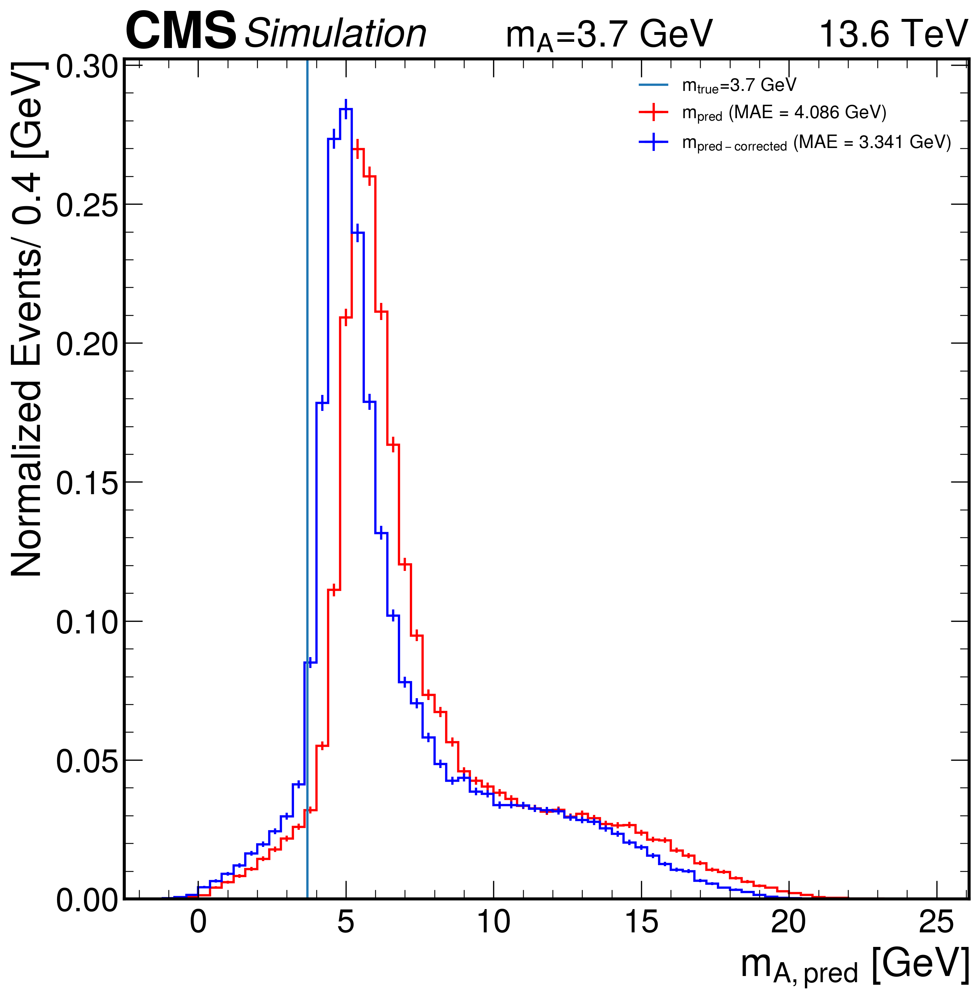

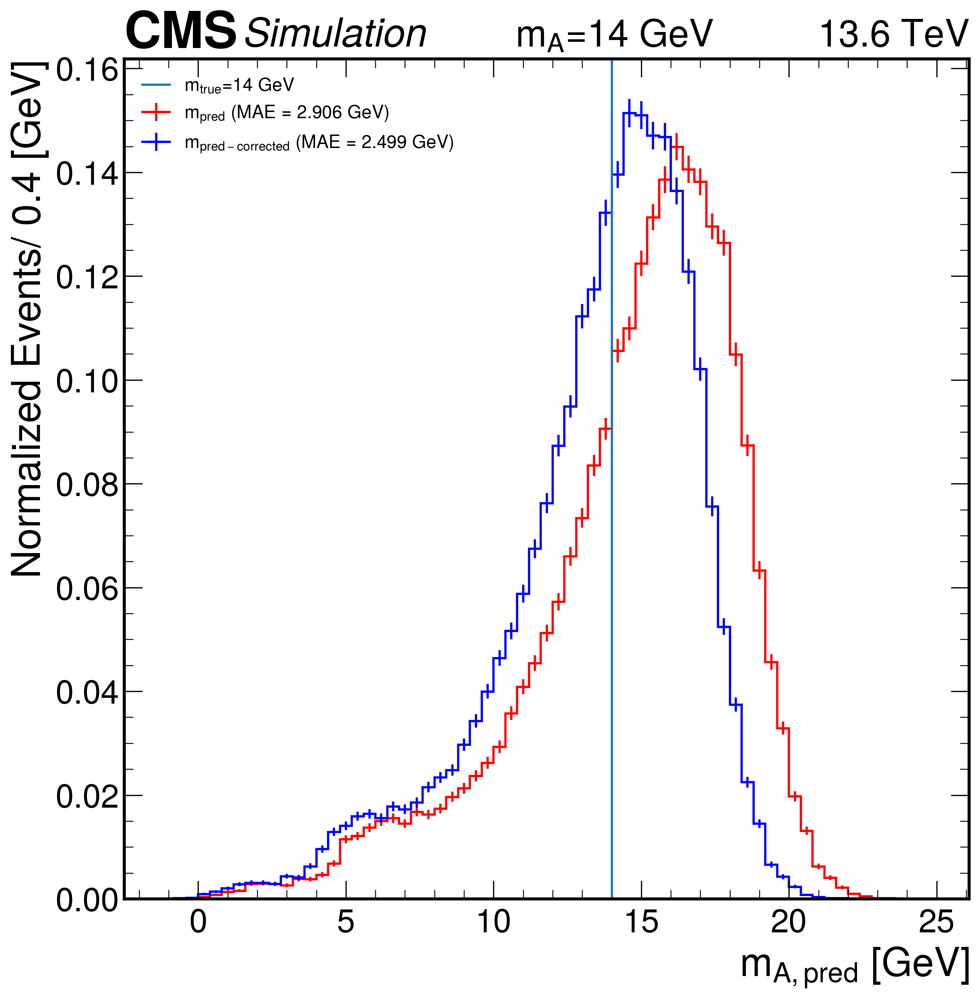

In [28]:
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
epoch=100
# ua_dir = 'ResNet_min_max_scaling_mN1p2To22_unbiased'
# ua_dir_no_relu = 'ResNet_min_max_scaling_mN1p2To22_unbiased_no_relu'
# model_dir = '13_ResNet_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

ua_dir_mapA = 'ResNet_mapA_1_mN1p2To22_unbaised'
# ua_dir_mapA0p5 = 'ResNet_mapA_0p5_mN1p2To22_unbaised'
model_dir_map = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'
model_dir_map_11 = '11_ResNet_mapA_Tracks_pt_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'


for Mass in ['3p7', '14']:
    m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)


    data_file_map = glob.glob(f"{data_dir}/{ua_dir_mapA}/{model_dir_map}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    infile_map = open(f"{data_file_map}", "rb")
    data_map = pickle.load(infile_map)
    data_map.keys()
    infile_map.close()
    m_pred_map = data_map["m_pred"]
    m_true_map = data_map["m_true"]

 
    m_pred_map_correct = corrected_pred_mode(m_pred_map)
    
    
    m0_min=-1.2
    m0_max=25.1
    bin_size =0.4
    fig, ax = plt.subplots(dpi=300)
    plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
    
    h2=np.histogram(m_pred_map, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h2, histtype='step', yerr=True, label=r'$m_{pred}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map - m_pred_map)), linestyle='-', color='red', density=True)
    
    h3=np.histogram(m_pred_map_correct, bins=np.arange(m0_min,m0_max,bin_size))
    hep.histplot(h3, histtype='step', yerr=True, label=r'$m_{pred-corrected}$' + ' (MAE = %.3f GeV)' % np.mean(np.abs(m_true_map -m_pred_map_correct)), linestyle='-', color='blue', density=True)
   
    plt.xlabel(r'$m_{A, pred}$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='best', fontsize=12)
    hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
    # plt.savefig(f'{out_dir}/signal_mass_{Mass}_inference_comparion_with_map_true_and_corrected_predictions_using_mode_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
    plt.show()

In [62]:
def plot_e2e_prediction_pf_jet_mass_corrected(mass='3p7', plot="m_pred", method="mean", in_file="../analysis_run3/Data_for_plots/mass_regression_test_data/upper_lower_streching_epoch_36_signal_mass_3p7_inference_data.pkl"):
    infile = open(f"{in_file}", "rb")
    data = pickle.load(infile)
    # print(f"loaded data file ------>  {data}")
    infile.close()
    mass  = {'3p7':3.7,'4':4, '5':5, '6':6, '8':8, '10':10, '12':12, '14':14}.get(Mass, None)
    m0_min, m0_max, bin_size = -1.2, 22.2, 0.4
    m_true = mass
    m_pred = data[f"{plot}"]
    jet_mass = data["jet_mass"]
    jet_pt = data["jet_pt"]
    if method=="mean": m_pred = corrected_pred_mean(m_pred)
    if method=="mode": m_pred = corrected_pred_mode(m_pred)
    mask1 = (jet_pt >=20) & (jet_pt <55)
    mask2 = (jet_pt >=55) & (jet_pt <70)
    mask3 = (jet_pt >=70) & (jet_pt <100)
    mask4 = jet_pt >=100

    m_pred1= m_pred[mask1]
    m_pred2= m_pred[mask2] 
    m_pred3= m_pred[mask3]
    m_pred4= m_pred[mask4]



    fig, ax = plt.subplots(dpi=300)
    if plot=='m_pred': 
        plt.plot([], [], ' ', label='From E2E Corrected')
        name_tag='E2E'
    else: 
         plt.plot([], [], ' ', label='From PF Jet mass')
         name_tag='Jet_mass'
    plt.axvline(m_true, linestyle='--', label=r"$m_{true}$" + f"={m_true} GeV", color='grey', alpha=0.5)

    # Define bin edges and centers
    bins = np.arange(m0_min, m0_max, bin_size)
    bin_centers = 0.5 * (bins[1:] + bins[:-1])




    # Helper to plot histogram and error bars
    def plot_with_errors(data, label, color, error_bar):
        counts, _ = np.histogram(data, bins=bins)
        norm = np.sum(counts)
        counts_norm = counts / norm
        errors = np.sqrt(counts) / norm
        # plt.hist(data, bins=bins, histtype='step', label=label, color=color, density=True, linewidth=2)
        plt.errorbar(bin_centers, counts_norm, yerr=errors, fmt=error_bar, color=color, markersize=6, linewidth=1, label=label)

    # Plot each pt region
    plot_with_errors(m_pred1, r'low $p_{T,jet}$ '+' (MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred1)), 'red', 'o')
    plot_with_errors(m_pred2, r'mid $p_{T,jet}$ '+' (MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred2)), 'black', 's')
    plot_with_errors(m_pred3, r'high $p_{T,jet}$ '+' (MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred3)), 'blue', 'v')
    plot_with_errors(m_pred4, r'ultra $p_{T,jet}$ '+' (MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred4)), 'green', 'd')
    plt.xlabel('$m_A$ [GeV]')
    plt.ylabel('Normalized Events/ 0.4 [GeV]')
    plt.legend(loc='best', fontsize=14)
    hep.cms.label(llabel="Simulation  ", rlabel=f"$m_A$={m_true} GeV           "   +   "13.6 TeV", loc=0, ax=ax)
    plt.tight_layout()
    mass_str = str(mass).replace('.', 'p')
    plt.savefig(f'{out_dir}/signal_mass_{mass_str}_prediction_from_{name_tag}_corrected_using_{method}.pdf',facecolor='w',dpi=300)
    plt.show()
    


../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_1_mN1p2To22_unbaised/13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_3p7_epoch_100_inference_data.pkl


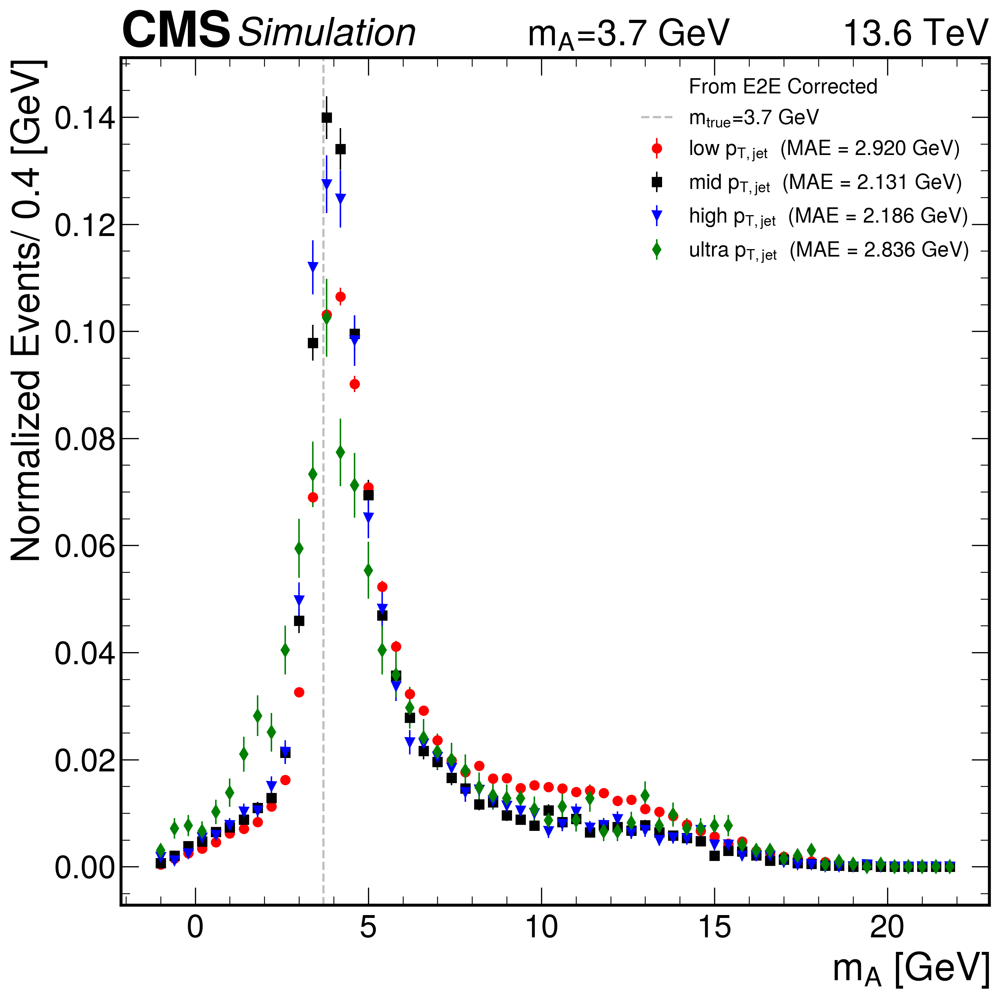

../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_1_mN1p2To22_unbaised/13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_14_epoch_100_inference_data.pkl


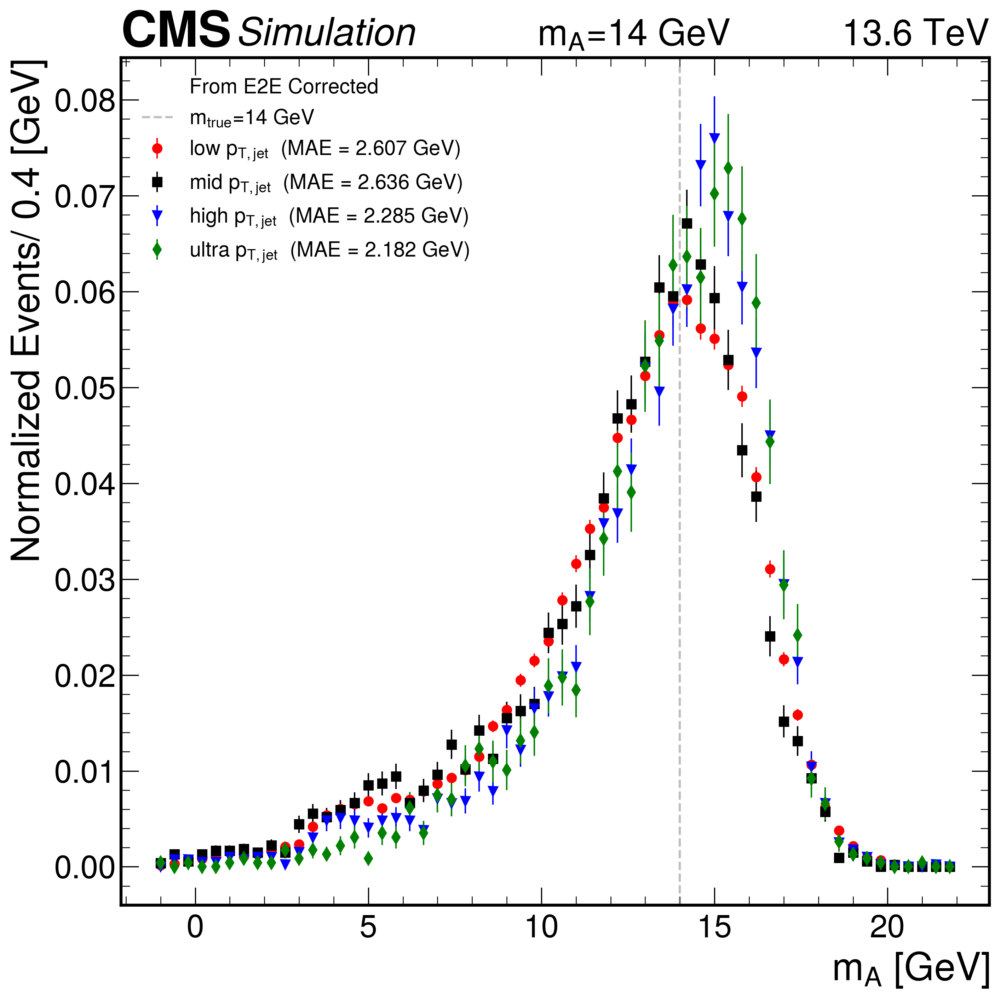

In [63]:
epoch=100
data_dir ='../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new'
ua_dir = 'ResNet_mapA_1_mN1p2To22_unbaised'
model_dir = '13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2'

Masses = ['3p7', '14']
for Mass in Masses:
    # model_dir = model_dir_ua[-1]
    in_file = glob.glob(f"{data_dir}/{ua_dir}/{model_dir}/signal_{Mass}_epoch_{epoch}_inference_data.pkl")[0]
    print(in_file)
    plot_e2e_prediction_pf_jet_mass_corrected(mass=Mass, plot="m_pred", method="mode", in_file=in_file)

keys dict_keys(['m_true', 'm_pred', 'mae', 'mre'])


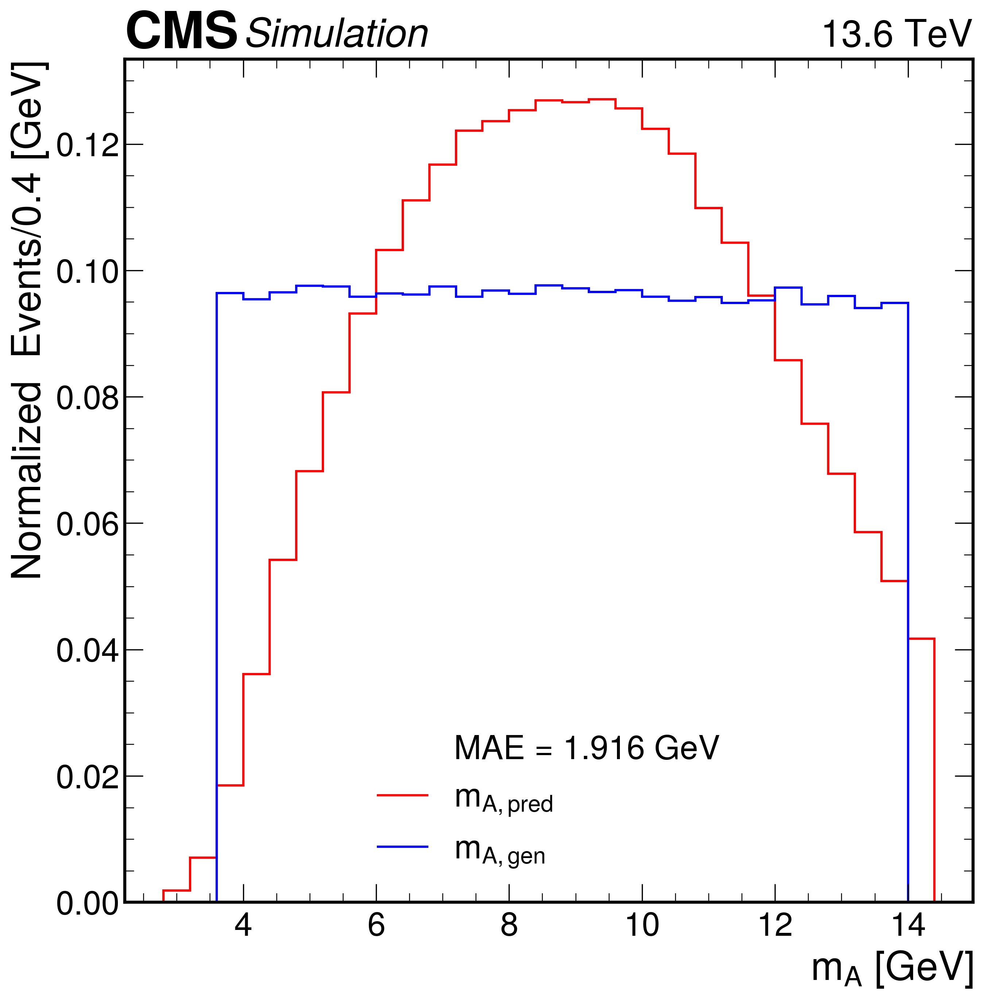

In [86]:
epoch_selected=[1,2,3,4,5,6,7,8,9,10,11,12]
epoch= epoch_selected[6]

data_dir = "../analysis_run3/Data_for_plots/mass_regression_test_data"
model_dir = "mass_trainer_aToTauTau_m1p2To17p2_unphysical_over_populated_less_data_lowerUnPhysical_range_huber"
data_file = glob.glob(f"{data_dir}/{model_dir}/INFERENCE_DATA/epoch{epoch}_*.pkl")[0]

# print(f"loaded data file ------>  {data_file}")
infile = open(f"{data_file}", "rb")
data = pickle.load(infile)
print("keys", data.keys())
# print(f"data.keys()------>  {data.keys()}")
infile.close()

m_true = data["m_true"]
m_pred = data["m_pred"]
# m0 = data["m0"]

mask1 = (m_true >= 3.6) & (m_true <=14)
m_true_ = m_true[mask1]
m_pred_ = m_pred[mask1]
# m0_ = m0[mask1]
mask2 = (m_pred_ >=3.6) & (m_pred_ <=14)
m_true__ = m_true_[mask2]
m_pred__ = m_pred_[mask2]
# m0__ = m0_[mask2]


m0_min = 2.8
m0_max = 14.8
bin_size =0.4

fig, ax = plt.subplots(dpi=300)
plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true - m_pred)))
h1 = np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h1, histtype='step', yerr=False, label=r'$m_{A, pred}$', linestyle='-', color='red', density=True)
h2 = np.histogram(m_true, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h2, histtype='step', yerr=False, label=r'$m_{A, gen}$', linestyle='-', color='blue', density=True)
plt.xlabel(r'$m_{A}$ [GeV]')
plt.ylabel('Normalized  Events/0.4 [GeV]')
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.legend(loc='best', frameon=False, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}/mtrue_mpred_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_full_1d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()

    
    
# fig, ax = plt.subplots(dpi=300)
# plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true__ - m_pred__)))
# h3 = np.histogram(m_pred__, bins=np.arange(m0_min,m0_max,bin_size))
# hep.histplot(h3, histtype='step', yerr=False, label=r'$m_{A, pred}$', linestyle='-', color='red', density=True)
# h4 = np.histogram(m_true__, bins=np.arange(m0_min+4,m0_max-7,bin_size))
# hep.histplot(h4, histtype='step', yerr=False, label=r'$m_{A, gen}$', linestyle='-', color='blue', density=True)
# plt.xlabel(r'$m_{A}$ [GeV]')
# plt.ylabel(r'Noemalised Events/0.4 [GeV]')
# plt.legend(loc='best')
# hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.savefig(f'{out_dir}//mtrue_mpred_roi_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_1d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
# plt.show()
    
# print("Reconstruction efficiency:", len(m_pred__)/len(m_true_)*100 ,"%")

    
# fig, ax = plt.subplots(figsize=(10,8),dpi=300)
# plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true - m_pred)))
# hist = plt.hist2d(np.squeeze(m_true), np.squeeze(m_pred), bins=[np.arange(m0_min, m0_max, .4), np.arange(m0_min, m0_max, .4)], cmap=cms_cmap)
# plt.xlabel(r'$m_{A, gen}$ [GeV]')
# plt.ylabel(r'$m_{A, pred}$ [GeV]')
# plt.plot((m0_min, m0_max), (m0_min, m0_max), color='r', linestyle='--')
# plt.colorbar().set_label(label='Events/ {0.4, 0.4} [GeV]')
# hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.legend(loc='upper left', frameon=True, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}//mtrue_mpred_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_full_2d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
# plt.show()

# fig, ax = plt.subplots(figsize=(10,8),dpi=300)
# plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true__ - m_pred__)))
# hist = plt.hist2d(np.squeeze(m_true__), np.squeeze(m_pred__), bins=[np.arange(3.6, 14.1, .4), np.arange(3.6, 14.1, .4)], cmap=cms_cmap)
# plt.xlabel(r'$m_{A, gen}$ [GeV]')
# plt.ylabel(r'$m_{A, pred}$ [GeV]')
# plt.plot((m0_min, m0_max), (m0_min, m0_max), color='r', linestyle='--')
# plt.colorbar().set_label(label='Events/ {0.4, 0.4} [GeV]')
# hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.legend(loc='upper left', frameon=True, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}/mtrue_mpred_roi_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_2d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
# plt.show()


# fig, ax = plt.subplots(dpi=300)
# plt.plot(m_true__, m_pred__, ".", color='black', alpha=0.02, label='MAE = %.3f GeV'%np.mean(np.abs(m_true__ - m_pred__)))
# plt.xlabel(r'$m_{A, gen}$ [GeV]')
# plt.ylabel(r'$m_{A, pred}$ [GeV]')
# m0_min, m0_max = 3.6, 14.0
# plt.plot((m0_min, m0_max), (m0_min, m0_max), color='r', linestyle='--')
# hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
# plt.xlim(m0_min, m0_max)
# plt.ylim(m0_min, m0_max)
# plt.legend(loc='upper left', frameon=True, framealpha=0.5, facecolor='white', edgecolor='black')
# # plt.savefig(f'{out_dir}/mtrue_mpred_roi_scatter_epoch_{epoch}.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
# plt.show()



keys dict_keys(['m_true', 'm_pred'])


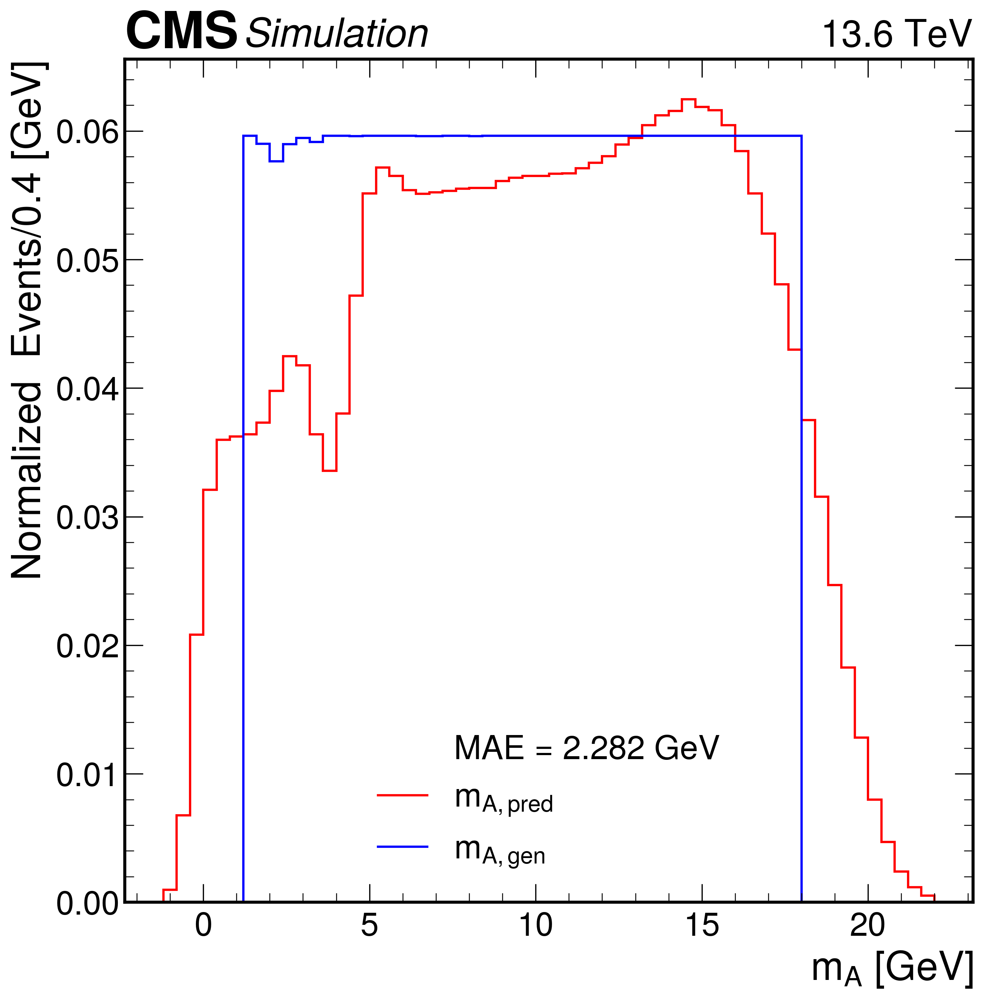

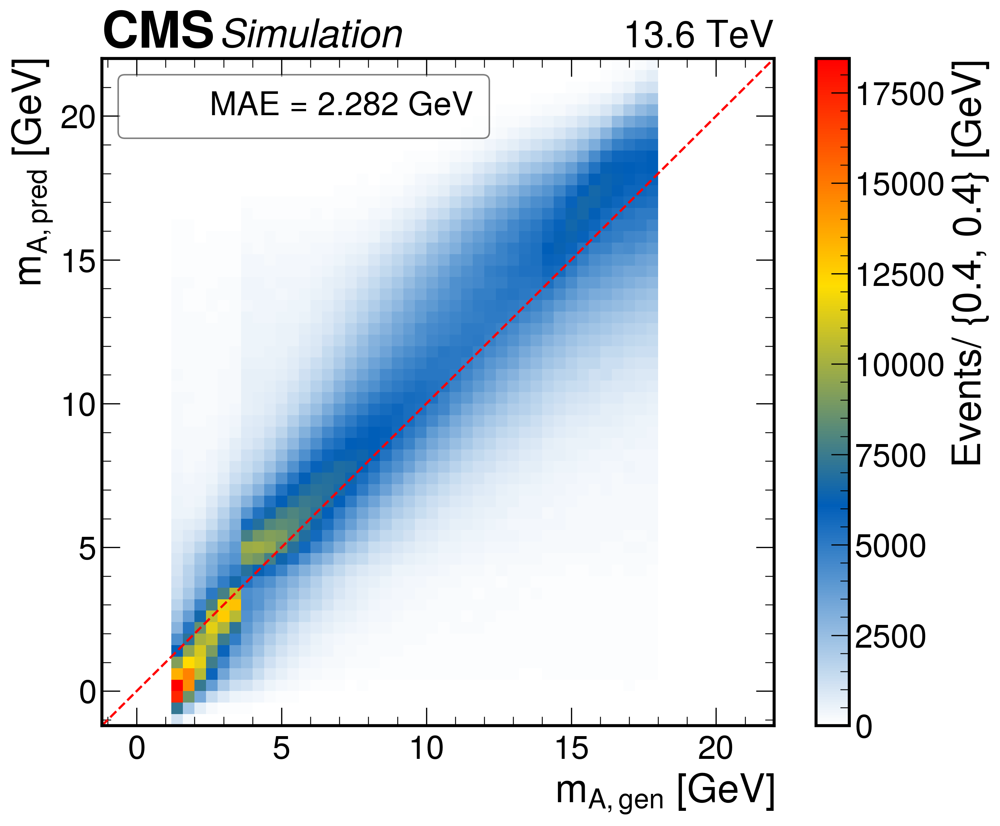

In [94]:

epoch=100
data_dir = "../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_mN1p2To22_unbaised"
model_dir = "13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2"
data_file = f"{data_dir}/{model_dir}/epoch_100_inference_data_train.pkl"

# print(f"loaded data file ------>  {data_file}")
infile = open(f"{data_file}", "rb")
data = pickle.load(infile)
print("keys", data.keys())
# print(f"data.keys()------>  {data.keys()}")
infile.close()

m_true = data["m_true"]
m_pred = data["m_pred"]
# m0 = data["m0"]

mask1 = (m_true >= 3.6) & (m_true <=14)
m_true_ = m_true[mask1]
m_pred_ = m_pred[mask1]
# m0_ = m0[mask1]
mask2 = (m_pred_ >=3.6) & (m_pred_ <=14)
m_true__ = m_true_[mask2]
m_pred__ = m_pred_[mask2]
# m0__ = m0_[mask2]


m0_min = -1.2
m0_max = 22.3
bin_size =0.4

fig, ax = plt.subplots(dpi=300)
plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true - m_pred)))
h1 = np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h1, histtype='step', yerr=False, label=r'$m_{A, pred}$', linestyle='-', color='red', density=1)
h2 = np.histogram(m_true, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h2, histtype='step', yerr=False, label=r'$m_{A, gen}$', linestyle='-', color='blue', density=1)
plt.xlabel(r'$m_{A}$ [GeV]')
plt.ylabel('Normalized  Events/0.4 [GeV]')
plt.legend(loc='best')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.legend(loc='best', frameon=False, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}/mtrue_mpred_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_full_1d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()


    
fig, ax = plt.subplots(figsize=(10,8),dpi=300)
plt.plot([], [], ' ', label='MAE = %.3f GeV'%np.mean(np.abs(m_true - m_pred)))
hist = plt.hist2d(np.squeeze(m_true), np.squeeze(m_pred), bins=[np.arange(m0_min, m0_max, .4), np.arange(m0_min, m0_max, .4)], cmap=cms_cmap)
plt.xlabel(r'$m_{A, gen}$ [GeV]')
plt.ylabel(r'$m_{A, pred}$ [GeV]')
plt.plot((m0_min, m0_max), (m0_min, m0_max), color='r', linestyle='--')
plt.colorbar().set_label(label='Events/ {0.4, 0.4} [GeV]')
hep.cms.label(llabel="Simulation", rlabel="13.6 TeV", loc=0, ax=ax)
plt.legend(loc='upper left', frameon=True, framealpha=0.5, facecolor='white', edgecolor='black')
# plt.savefig(f'{out_dir}//mtrue_mpred_ResNet_min_max_scaling_mN1p2To22_epoch_{epoch}_full_2d_hist.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()

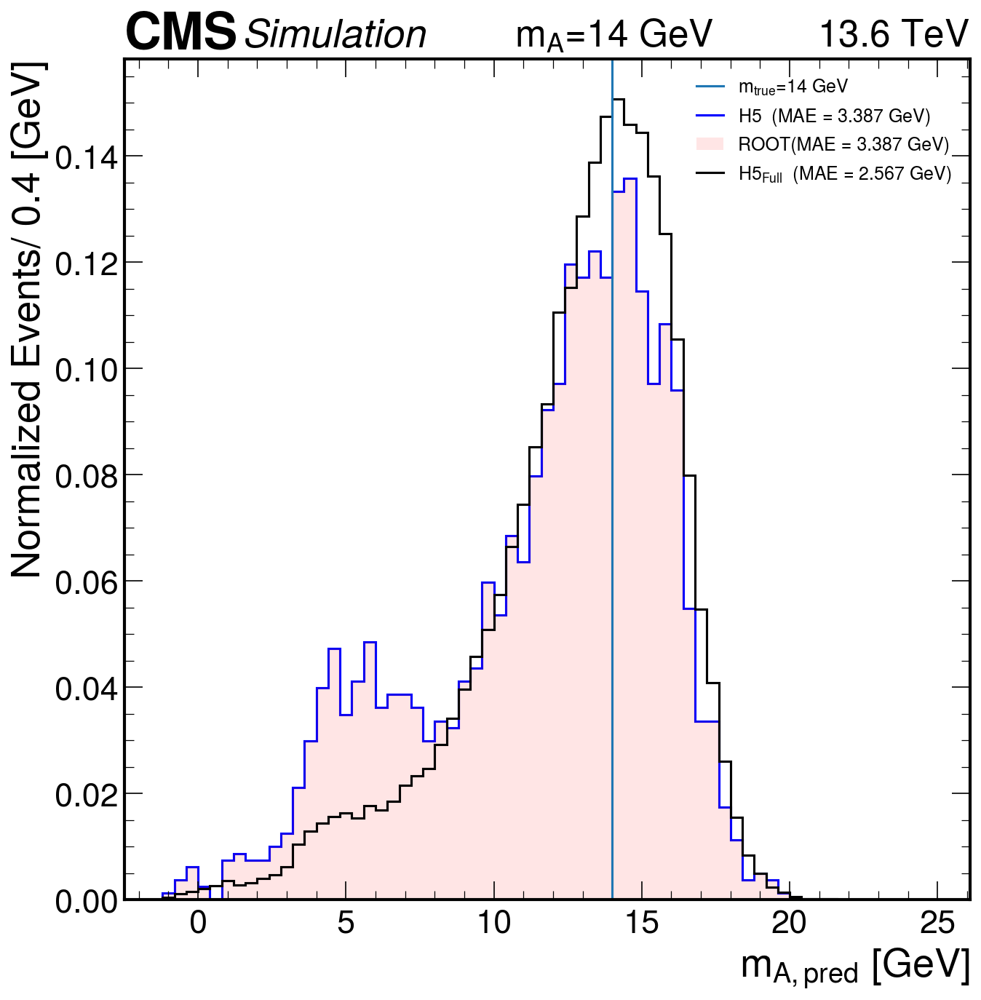

In [20]:
epoch=100
Mass = '14'
m0_min=-1.2
m0_max=25.1
bin_size =0.4
m_true_mass = {'3p7':3.7, '4':4, '6':6, '14':14}.get(Mass, None)

data_file = glob.glob(f"../analysis_run3/Data_for_plots/ResNet_mapA/signal_14_epoch_100_inference_data_from_h5.pkl")[0]
infile = open(f"{data_file}", "rb")
data = pickle.load(infile)
infile.close()
m_pred = data["m_pred"]
m_true = data["m_true"]

def correction(mass_raw,a=-0.04922334  ,b=-1.25575772):
            # mass = m + polynomial_mode(m)
            mass = mass_raw + a*mass_raw + b
            return mass
        
data_file1 = glob.glob(f"../analysis_run3/Data_for_plots/mass_regression_test_data/jupyter_notebook_new/ResNet_mapA_1_mN1p2To22_unbaised/13_ResNet_mapA_Tracks_pt_Tracks_dZSig_Tracks_d0Sig_ECAL_energy_HBHE_energy_Pix_1_Pix_2_Pix_3_Pix_4_Tib_1_Tib_2_Tob_1_Tob_2/signal_14_epoch_100_inference_data.pkl")[0]
infile1 = open(f"{data_file1}", "rb")
data1 = pickle.load(infile1)
infile1.close()
m_pred1 = correction(data1["m_pred"])
m_true1 = data1["m_true"]


mass_A1, mass_A2 = [], []
needed = ["am", "mass_A1", "mass_A2"]
infile= glob.glob("../analysis_run3/Data_for_plots/mass_regression_test_data/*.root")[0]
for arrays in uproot.iterate(
    infile + ":fevt/RHTree",
    filter_name=needed,
    step_size=10,
    library="np"
):
    # flatten properly to 1D
    mass_A1.append(np.ravel(arrays["mass_A1"][:,0]))
    mass_A2.append(np.ravel(arrays["mass_A2"][:,1]))
   

mass_A1 = np.concatenate(mass_A1)
mass_A2 = np.concatenate(mass_A2)
mass_A1 = mass_A1[mass_A1 > -999.99]
mass_A2 = mass_A2[mass_A2 > -999.99]

mass_A=np.concatenate((mass_A1, mass_A2), axis=0) 



fig, ax = plt.subplots(dpi=150)
plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")

h1=np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h1, histtype='step', yerr=False, label=r'$H5$  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred)), color='b', density=True)

h2=np.histogram(mass_A, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h2, histtype="fill",yerr=False, label=r'ROOT'+'(MAE = %.3f GeV)'%np.mean(np.abs(mass_A - 14)), color='red', alpha=0.1, density=True)


h11=np.histogram(m_pred1, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h11, histtype='step', yerr=False, label=r'$H5_{Full}$  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true1 - m_pred1)), color='black', density=True)

plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel('Normalized Events/ 0.4 [GeV]')
plt.legend(loc='upper right', fontsize=12)
hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
plt.show()

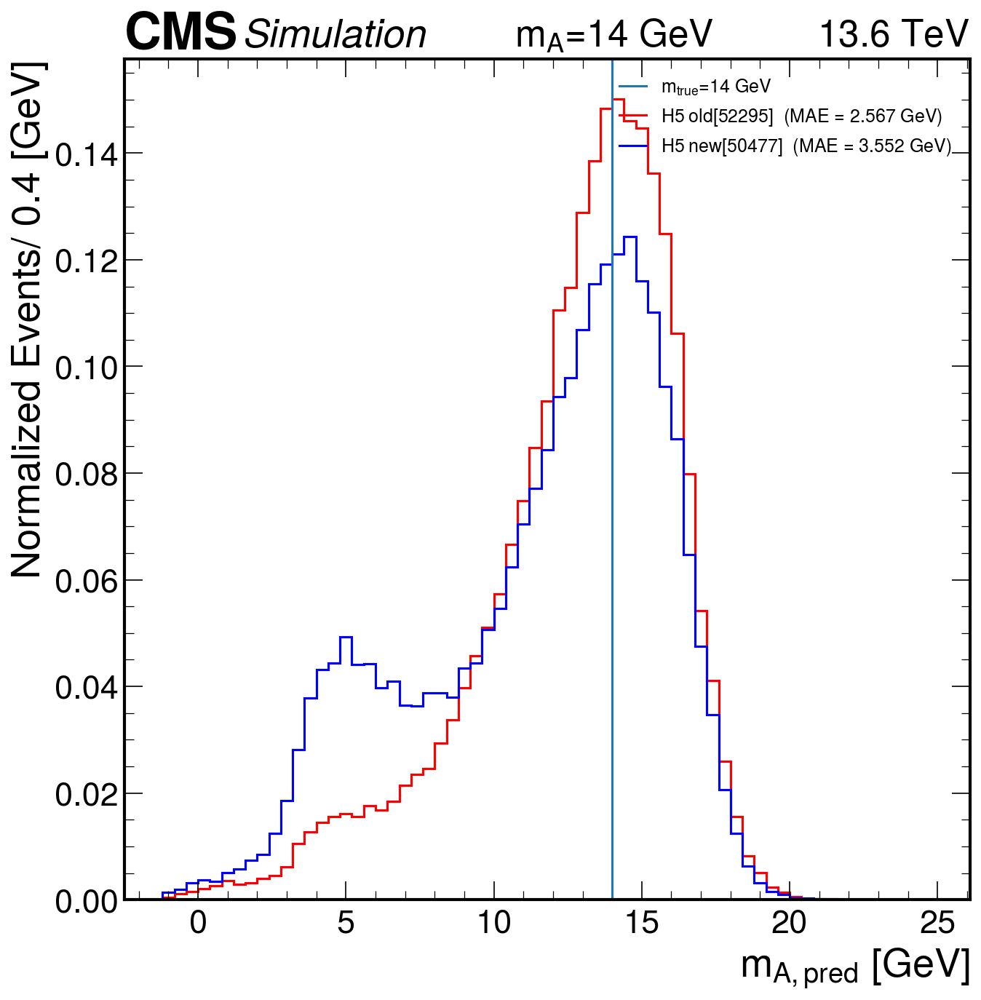

In [15]:
import glob, pickle
import numpy as np
import matplotlib.pyplot as plt
import mplhep as hep

epoch = 100
Mass = '14'
m0_min = -1.2
m0_max = 25.1
bin_size = 0.4
m_true_mass = {'3p7': 3.7, '4': 4, '6': 6, '14': 14}.get(Mass, None)

data_file_o = glob.glob("../analysis_run3/Data_for_plots/ResNet_mapA_from_old_h5/signal_14_epoch_100_inference_data_from_h5.pkl")[0]
with open(data_file_o, "rb") as infile_o:
    data_o = pickle.load(infile_o)

m_pred_o = data_o["m_pred"]
m_true_o = data_o["m_true"]
# Load data
data_file = glob.glob("../analysis_run3/Data_for_plots/ResNet_mapA_jet_mult_test/signal_14_epoch_100_inference_data_from_h5.pkl")[0]
with open(data_file, "rb") as infile:
    data = pickle.load(infile)
mask = (jet_mul > 1)
m_pred = data["m_pred"]
m_true = data["m_true"]
# jet_mul = data["jet_mult"]

fig, ax = plt.subplots(dpi=150)
plt.axvline(m_true_mass, label=r"$m_{true}$" + f"={m_true_mass} GeV")
ho=np.histogram(m_pred_o, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(ho, histtype='step', yerr=False, label=r'$H5\; old$'+f'[{len(m_pred_o)}]  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true_o - m_pred_o)), color='r', density=True)

h1=np.histogram(m_pred, bins=np.arange(m0_min,m0_max,bin_size))
hep.histplot(h1, histtype='step', yerr=False, label=r'$H5\; new$'+f'[{len(m_pred)}]  '+'(MAE = %.3f GeV)'%np.mean(np.abs(m_true - m_pred)), color='b', density=True)

plt.xlabel(r'$m_{A, pred}$ [GeV]')
plt.ylabel('Normalized Events/ 0.4 [GeV]')
plt.legend(loc='upper right', fontsize=12)
hep.cms.label(llabel="Simulation", rlabel=f"$m_A$={m_true_mass} GeV          "    +   "13.6 TeV", loc=0, ax=ax)
plt.show()

719 96


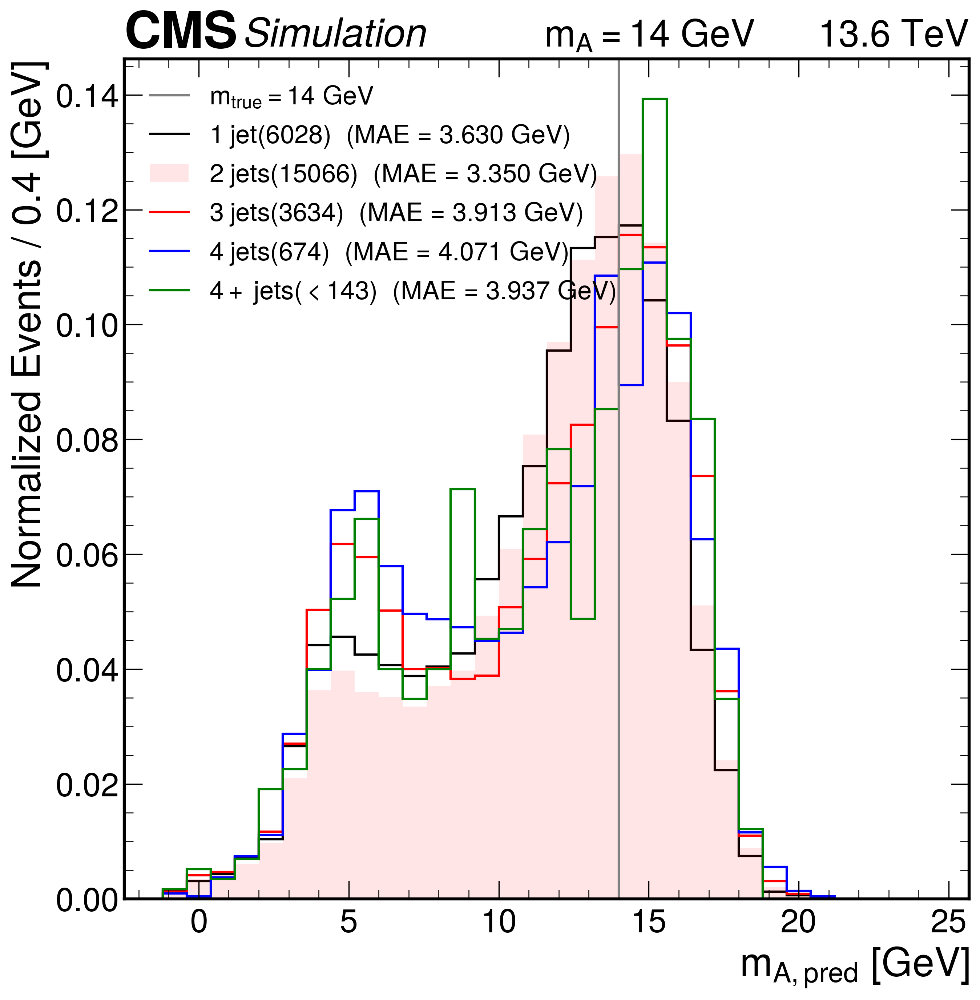

In [6]:
import glob, pickle
import numpy as np
import matplotlib.pyplot as plt
import mplhep as hep

epoch = 100
Mass = '14'
m0_min = -1.2
m0_max = 25.1
bin_size = 0.8
m_true_mass = {'3p7': 3.7, '4': 4, '6': 6, '14': 14}.get(Mass, None)

# Load data
data_file = glob.glob("../analysis_run3/Data_for_plots/ResNet_mapA_jet_mult/signal_14_epoch_100_inference_data_from_h5.pkl")[0]
with open(data_file, "rb") as infile:
    data = pickle.load(infile)

m_pred = data["m_pred"]
m_true = data["m_true"]
jet_mul = data["jet_mult"]

# Boolean masks
mask_1 = (jet_mul == 1)
mask_2 = (jet_mul == 2)
mask_3 = (jet_mul == 3)
mask_4 = (jet_mul == 4)
mask_5 = (jet_mul >=5)
mask_6 = (jet_mul == 6)

# Subset predictions
m_pred_1 = m_pred[mask_1]
m_pred_2 = m_pred[mask_2]
m_pred_3 = m_pred[mask_3]
m_pred_4 = m_pred[mask_4]
m_pred_5 = m_pred[mask_5]
m_pred_6 = m_pred[mask_6]

print(len(m_pred_5), len(m_pred_6))
def correction(mass_raw, a=-0.04922334, b=-1.25575772):
    return mass_raw + a*mass_raw + b

# Plot
fig, ax = plt.subplots(dpi=300)
plt.axvline(m_true_mass, label=rf"$m_{{true}}={m_true_mass}$ GeV", color="gray")

h1 = np.histogram(m_pred_1, bins=np.arange(m0_min, m0_max, bin_size))
hep.histplot(
    h1, histtype="step", yerr=False,
    label=rf"$1\; jet ({len(m_pred_1)})$  (MAE = {np.mean(np.abs(m_true[mask_1] - m_pred_1)):.3f} GeV)",
    color="black", density=True
)

h2 = np.histogram(m_pred_2, bins=np.arange(m0_min, m0_max, bin_size))
hep.histplot(
    h2, histtype="fill", yerr=False, alpha=0.1,
    label=rf"$2\; jets ({len(m_pred_2)//2})$  (MAE = {np.mean(np.abs(m_true[mask_2] - m_pred_2)):.3f} GeV)",
    color="r", density=True
)

h3 = np.histogram(m_pred_3, bins=np.arange(m0_min, m0_max, bin_size))
hep.histplot(
    h3, histtype="step", yerr=False,
    label=rf"$3\; jets ({len(m_pred_3)//3})$  (MAE = {np.mean(np.abs(m_true[mask_3] - m_pred_3)):.3f} GeV)",
    color="r", density=True
)

h4 = np.histogram(m_pred_4, bins=np.arange(m0_min, m0_max, bin_size))
hep.histplot(
    h4, histtype="step", yerr=False,
    label=rf"$4\; jets ({len(m_pred_4)//4})$  (MAE = {np.mean(np.abs(m_true[mask_4] - m_pred_4)):.3f} GeV)",
    color="b", density=True
)

h5 = np.histogram(m_pred_5, bins=np.arange(m0_min, m0_max, bin_size))
hep.histplot(
    h5, histtype="step", yerr=False,
    label=rf"$4+ \; jets (<{len(m_pred_5)//5})$  (MAE = {np.mean(np.abs(m_true[mask_5] - m_pred_5)):.3f} GeV)",
    color="g", density=True
)

plt.xlabel(r"$m_{A, pred}$ [GeV]")
plt.ylabel("Normalized Events / 0.4 [GeV]")
plt.legend(loc="best", fontsize=17)
hep.cms.label(llabel="Simulation", rlabel=f"$m_A={m_true_mass}$ GeV      13.6 TeV", loc=0, ax=ax)
plt.savefig(f'{out_dir}/signal_mass_14_inference_for_diff_number_of_selected_jets_in_event.pdf', bbox_inches='tight',dpi=300, facecolor = "w")
plt.show()


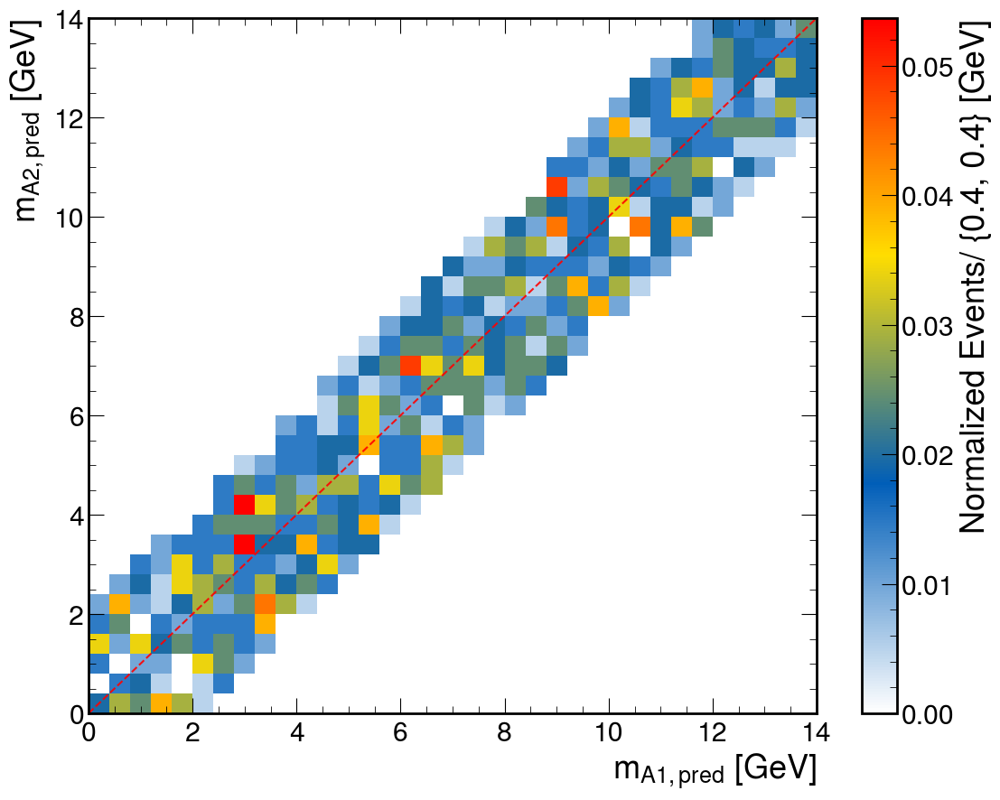

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


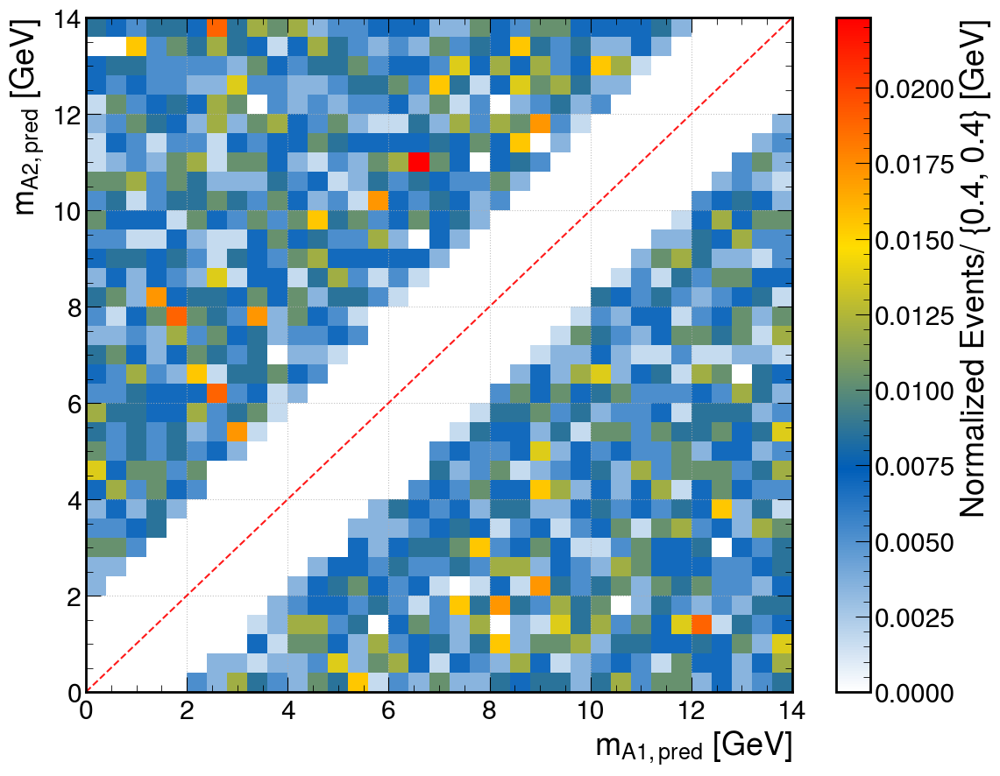

In [52]:
import numpy as np
import matplotlib.pyplot as plt

# Generate random samples
N = 5000  # total points
m1 = np.random.uniform(0, 14.1, N)
m2 = np.random.uniform(0, 14.1, N)


mask_SR = np.abs(m1 - m2) < 2
mask_SB = np.abs(m1 - m2) >= 2
m1_SR = m1[mask_SR]
m2_SR = m2[mask_SR]

m1_SB = m1[mask_SB]
m2_SB = m2[mask_SB]

m0_min, m0_max, bin_ = 0, 14.1, 0.4

plt.figure(figsize=(13,10))
plt.plot((0, 14.1), (0, 14.1), color='r', linestyle='--', alpha=0.9)
hist = plt.hist2d(m1_SR, m2_SR, bins=[np.arange(m0_min, m0_max, bin_), np.arange(m0_min, m0_max, bin_)],density=True, cmap=cms_cmap)
plt.colorbar().set_label(label='Normalized Events/ {0.4, 0.4} [GeV]')
plt.xlabel(r"$m_{A1, pred}$ [GeV]")
plt.ylabel(r"$m_{A2, pred}$ [GeV]")
# plt.legend(title=r"|$m_{A1} - m_{A2}$| < 2 GeV")
plt.show()

plt.figure(figsize=(13,10))
plt.plot((0, 14.1), (0, 14.1), color='r', linestyle='--', alpha=0.9)
hist = plt.hist2d(m1_SB, m2_SB, bins=[np.arange(m0_min, m0_max, bin_), np.arange(m0_min, m0_max, bin_)],density=True, cmap=cms_cmap)
plt.colorbar().set_label(label='Normalized Events/ {0.4, 0.4} [GeV]')
# plt.legend(title=r"|$m_{A1} - m_{A2}$| > 2 GeV")
plt.xlabel(r"$m_{A1, pred}$ [GeV]")
plt.ylabel(r"$m_{A2, pred}$ [GeV]")
plt.legend()
plt.grid(True)
plt.show()
